In [1]:
import os
import pandas as pd
import json
import numpy as np
import seaborn as sns
from sklearn import metrics
import matplotlib.pyplot as plt
from functools import reduce
%matplotlib inline

In [2]:
def CustomParser(data):
    j1 = json.loads(data)
    return j1

In [11]:
# set path
path_root = '/media/yassine/data_disk/Drive/QC_zooniverse_2'
#path_root = '/home/yassinebha/Drive/QC_zooniverse'

In [20]:
# Read raw table
classifications = pd.read_csv(os.path.join(path_root,'Beta2/start-project-classifications.csv'), converters={'metadata':CustomParser,'annotations':CustomParser,'subject_data':CustomParser},header=0)

In [21]:
classifications.head()

,classification_id,user_name,user_id,user_ip,workflow_id,workflow_name,workflow_version,created_at,gold_standard,expert,metadata,annotations,subject_data,subject_ids
0,62481066,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:48:48 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664112': {'retired': {'id': 7407615, 'clas...",10664112
1,62481102,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:02 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664107': {'retired': {'id': 7407616, 'clas...",10664107
2,62481132,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:13 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664081': {'retired': {'id': 7407617, 'clas...",10664081
3,62481195,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:34 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664147': {'retired': {'id': 7407619, 'clas...",10664147
4,62481229,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:46 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664069': {'retired': {'id': 7407620, 'clas...",10664069


In [22]:
# original count
classifications.count()

classification_id    755
user_name            755
user_id              653
user_ip              755
workflow_id          755
workflow_name        755
workflow_version     755
created_at           755
gold_standard          0
expert                 0
metadata             755
annotations          755
subject_data         755
subject_ids          755
dtype: int64

In [23]:
# remove not logged in raters
classifications = classifications[ (classifications.user_name.str.find("not-logged-in")==-1)]
classifications.count()

classification_id    653
user_name            653
user_id              653
user_ip              653
workflow_id          653
workflow_name        653
workflow_version     653
created_at           653
gold_standard          0
expert                 0
metadata             653
annotations          653
subject_data         653
subject_ids          653
dtype: int64

In [24]:
# extract tagging count
classifications.loc[:,"n_tagging"] = [ len(q[0]['value']) for q in classifications.annotations]
# extract rating count
classifications.loc[:,"rating"] = [ q[1]['value'] for q in classifications.annotations]
# extract subjects id
classifications.loc[:,"ID"] = [ row.subject_data[str(classifications.subject_ids[ind])]['subject_ID'] for ind,row in classifications.iterrows()]
# extract files name
classifications.loc[:,"imgnm"] = [ row.subject_data[str(classifications.subject_ids[ind])]['image1'] for ind,row in classifications.iterrows()]

In [25]:
classifications.head()

,classification_id,user_name,user_id,user_ip,workflow_id,workflow_name,workflow_version,created_at,gold_standard,expert,metadata,annotations,subject_data,subject_ids,n_tagging,rating,ID,imgnm
0,62481066,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:48:48 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664112': {'retired': {'id': 7407615, 'clas...",10664112,0,OK,X3169448,X_3169448_anat.png
1,62481102,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:02 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664107': {'retired': {'id': 7407616, 'clas...",10664107,0,OK,X0010125,X_0010125_anat.png
2,62481132,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:13 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664081': {'retired': {'id': 7407617, 'clas...",10664081,0,OK,X0026039,X_0026039_anat.png
3,62481195,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:34 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664147': {'retired': {'id': 7407619, 'clas...",10664147,0,OK,HC0040053,HC0040053_anat.png
4,62481229,Yassinebha,752889.0,aaeea64b48677dd6a78f,4542,Start Project,1.1,2017-07-05 18:49:46 UTC,NaN,NaN,"{'user_group_ids': [], 'viewport': {'height': ...","[{'task': 'T1', 'task_label': 'Tag mismatched ...","{'10664069': {'retired': {'id': 7407620, 'clas...",10664069,0,OK,X2996531,X_2996531_anat.png


In [26]:
# How many rating per user
user_count = classifications.user_name.value_counts()
user_count

equidad1             104
Notkabene            101
rubyadeline          100
Neuromarq             49
Janet616              35
Twieden               35
Kay_scor4             34
Yassinebha            21
greggk                15
LauraThoegersen       14
CellularPeptide       13
Joface                12
desertfoxx            11
AlphaPrime            10
H_Spiers              10
BernieKdy              9
dme2                   9
Keira_stargazer        9
mayamama               8
mmkohler               7
simexp                 5
Martiju                5
ParisaAquilini         4
Cauliwolf              3
Rob1949                3
MicroChip27            3
Bathiesphere           3
MatthewVetkoetter      3
Malina-B               2
Jhvn147                2
anchro                 2
holasciarts            2
Chandnikumari          2
kiquegoce              2
Willisk15              1
bwalsh2017             1
JBGuy91                1
OlinMB                 1
Michkov                1
My-Idoru               1


In [27]:
#select only users that have rated a certain ammount of images 
list_user = user_count.index
list_user = list_user[user_count.values>=5]
user_count[list_user]

equidad1           104
Notkabene          101
rubyadeline        100
Neuromarq           49
Janet616            35
Twieden             35
Kay_scor4           34
Yassinebha          21
greggk              15
LauraThoegersen     14
CellularPeptide     13
Joface              12
desertfoxx          11
AlphaPrime          10
H_Spiers            10
BernieKdy            9
dme2                 9
Keira_stargazer      9
mayamama             8
mmkohler             7
simexp               5
Martiju              5
Name: user_name, dtype: int64

In [28]:
# remove users with less rating then the selected threshold
classifications = classifications[classifications.user_name.isin(list_user)]
classifications.count()

classification_id    616
user_name            616
user_id              616
user_ip              616
workflow_id          616
workflow_name        616
workflow_version     616
created_at           616
gold_standard          0
expert                 0
metadata             616
annotations          616
subject_data         616
subject_ids          616
n_tagging            616
rating               616
ID                   616
imgnm                616
dtype: int64

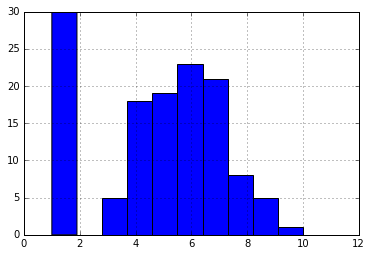

In [29]:
# plot rating per image distribution
image_count = classifications.subject_ids.value_counts()
image_count.hist()

In [30]:
#Merge Users rating
conctat_rating = [classifications[classifications.user_name == user][['ID','rating']].rename(columns={'rating': user})
                  for user in list_user]
df_rating = reduce(lambda left,right: pd.merge(left,right,how='left',on='ID'), conctat_rating)

In [31]:
df_rating.head()

,ID,equidad1,Notkabene,rubyadeline,Neuromarq,Janet616,Twieden,Kay_scor4,Yassinebha,greggk,...,desertfoxx,AlphaPrime,H_Spiers,BernieKdy,dme2,Keira_stargazer,mayamama,mmkohler,simexp,Martiju
0,X4104523,OK,Maybe,Maybe,NaN,Fail,Fail,Fail,NaN,OK,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,X0010031,OK,Maybe,Maybe,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OK,NaN
2,X3917422,OK,Maybe,OK,OK,Fail,NaN,OK,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Maybe,NaN,NaN,NaN
3,X0010052,Maybe,OK,Fail,OK,NaN,NaN,NaN,NaN,OK,...,NaN,NaN,NaN,NaN,NaN,NaN,Fail,NaN,NaN,NaN
4,X2232376,OK,Fail,OK,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,OK,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
stuff = np.array([[np.sum(row[1:-1].values=='Fail'),
         np.sum(row[1:-1].values=='Maybe'),
         np.sum(row[1:-1].values=='OK')] for ind, row in df_rating.iterrows()])

In [33]:
df_score = pd.DataFrame(index=df_rating.index,data=stuff, columns=['Fail', 'Maybe', 'OK'])

In [34]:
df_score.head()

,Fail,Maybe,OK
0,3,2,2
1,0,3,2
2,1,2,4
3,2,2,3
4,2,1,3


In [35]:
# Normalise table's row
nb_rating = df_score.sum(axis="columns")
df_norm = pd.DataFrame( index=df_rating.index,columns=['Fail', 'Maybe', 'OK'])
for status in df_score.columns.values:
    for image in df_score.index:
        df_norm[status][image] = df_score[status][image]/nb_rating[image]

In [36]:
df_norm.head()

,Fail,Maybe,OK
0,0.428571,0.285714,0.285714
1,0,0.6,0.4
2,0.142857,0.285714,0.571429
3,0.285714,0.285714,0.428571
4,0.333333,0.166667,0.5


## Histograms
Histograms of the frequency of the "OK", "Maybe" and "fail" rating across raters, for all images. If all raters agreed, we would only have 0% or 100% rating frequencies. 

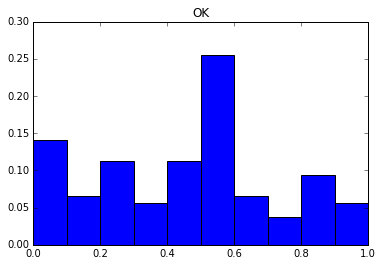

In [37]:
# Histogram of OK
hok , bins = np.histogram(df_norm.OK,bins=np.arange(0,1.1,0.1))
hok = hok.astype(np.float32) / hok.sum()
plt.bar(bins[:-1], hok , width=(bins[1]-bins[0]))
plt.title('OK')

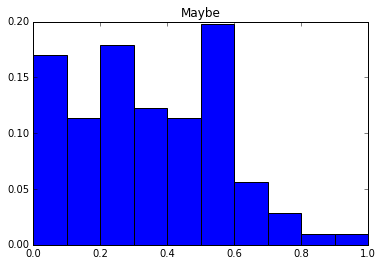

In [38]:
# Histogram of Maybe
hmaybe , bins = np.histogram(df_norm.Maybe,bins=np.arange(0,1.1,0.1))
hmaybe = hmaybe.astype(np.float32) / hmaybe.sum()
plt.bar(bins[:-1], hmaybe , width=(bins[1]-bins[0]))
plt.title('Maybe')

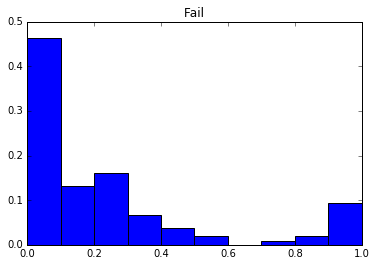

In [39]:
# Histogram of Fail
hfail , bins = np.histogram(df_norm.Fail,bins=np.arange(0,1.1,0.1))
hfail = hfail.astype(np.float32) / hfail.sum()
plt.bar(bins[:-1], hfail , width=(bins[1]-bins[0]))
plt.title('Fail')

## Kappa score

two raters have completed all 100 subjects. I'll compute kapa on their scores

In [40]:
#select raters
df_kappa = df_rating[["ID","Notkabene","equidad1"]]

In [41]:
# Add matching column
df_kappa.loc[:,"rating_match"] = [ row["Notkabene"] == row["equidad1"] for ind,row in df_kappa.iterrows()]

/usr/local/lib/python3.5/dist-packages/pandas/core/indexing.py:337: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
/usr/local/lib/python3.5/dist-packages/pandas/core/indexing.py:517: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [112]:
df_kappa.describe()

,ID,Notkabene,equidad1,rating_match
count,103,103,102,103
unique,100,3,3,2
top,X0021015,Maybe,OK,False
freq,2,42,51,54


In [113]:
df_kappa.dropna(inplace=True)
df_kappa.describe()

/usr/local/lib/python3.4/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


,ID,Notkabene,equidad1,rating_match
count,102,102,102,102
unique,99,3,3,2
top,X6206397,Maybe,OK,False
freq,2,42,51,53


In [114]:
# Replace OK:1 , Maybe:2 and Fail:3
df_kappa.replace({'OK':1,'Maybe':2, 'Fail':3}, inplace=True)
df_kappa.head()

/usr/local/lib/python3.4/dist-packages/pandas/core/generic.py:3466: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  limit=limit, regex=regex)


,ID,Notkabene,equidad1,rating_match
0,X2920716,3,2,False
1,X0010125,2,2,True
2,X2854839,3,2,False
3,HC0040058,1,1,True
4,HC0040045,1,1,True


In [115]:
metrics.cohen_kappa_score(df_kappa[['Notkabene']],df_kappa[['equidad1']])

0.19481680071492391

In [88]:
# Generate Kappa matrix rater by rater
iter_list = df_kappa.ix[:,1:3].columns.values.tolist()
kappa_store = np.zeros((len(iter_list), len(iter_list)))
for net_id in range(len(iter_list)):
    rater_1 = iter_list[net_id]
    for s_id in range(len(iter_list)):
        rater_2 = iter_list[s_id]
        kappa = metrics.cohen_kappa_score(df_kappa[[rater_1]],df_kappa[[rater_2]])
        # Save the kappa
        kappa_store[net_id, s_id] = kappa

In [89]:
kappa_store

array([[ 1.       ,  0.1948168],
       [ 0.1948168,  1.       ]])

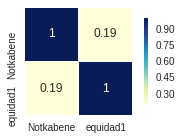

In [91]:
# Plot kappa matrix

kappa_out = pd.DataFrame(kappa_store, index=iter_list, columns=iter_list)
sns.set(style="white")
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(4, 2))
# Draw the map
sns.heatmap(kappa_out,vmax=1,cmap="YlGnBu",
            square=True,annot=True,
            linewidths=.5, cbar_kws={"shrink": .8}, ax=ax)

In [25]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(url= "https://i.stack.imgur.com/kYNd6.png" ,width=600, height=600)

## Plot tagging on imges 

In [92]:
%matplotlib inline
import os
import matplotlib
import matplotlib.pyplot as plt

In [93]:
base_path = '/home/yassinebha/Drive/QC_zooniverse/brainhack2017/rating_images'

In [94]:
# output markings from 50 classifications
#Basile
clist=[]
for index, c in classifications.iterrows():
    if c['n_tagging'] > 0:
        for q in c.annotations[0]['value']:
            clist.append({'ID':c.ID, 'workflow_name':c.workflow_name, 'rating':c.rating,'imgnm':c.imgnm, 
                          'x':q['x'], 'y':np.round(q['y']).astype(int), 'r':'2','n_tagging':c.n_tagging ,'frame':q['frame']})
    else:
        clist.append({'ID':c.ID, 'workflow_name':c.workflow_name, 'rating':c.rating,'imgnm':c.imgnm, 
                          'x':float('nan'), 'y':float('nan'), 'r':float('nan'),'n_tagging':c.n_tagging ,'frame':'1'})

col_order=['ID','workflow_name','rating','x','y','r','n_tagging','imgnm','frame']
out = pd.DataFrame(clist)[col_order]

In [95]:
ids_imgnm = np.reshape([out.ID.unique(),out.imgnm.unique()],(2,np.shape(out.ID.unique())[0]))

In [96]:
ids_imgnm[0,1]

'X0010125'

In [97]:
os.path.join(path_root,'Beta2/rating_images')

'/media/yassinebha/database29/Drive/QC_zooniverse/Beta2/rating_images'

In [98]:
np.sort(ids_imgnm.T[:,1])[:15]

array(['HC0040038_anat.png', 'HC0040043_anat.png', 'HC0040045_anat.png',
       'HC0040048_anat.png', 'HC0040050_anat.png', 'HC0040051_anat.png',
       'HC0040052_anat.png', 'HC0040053_anat.png', 'HC0040054_anat.png',
       'HC0040055_anat.png', 'HC0040056_anat.png', 'HC0040057_anat.png',
       'HC0040058_anat.png', 'HC0040061_anat.png', 'HC0040062_anat.png'], dtype=object)

In [101]:
# juste run onse to collect images in specific folder
from shutil import copyfile, copy2
#base_path_src = os.path.join(path_root,'zooqc_report_adhd_03-Jul-2017/registration')
base_path_src = os.path.join(path_root,'zooqc_report_cobre_03-Jul-2017/registration')
base_path_dest = os.path.join(path_root,'Beta2/rating_images')
for ii in np.sort(ids_imgnm.T[:,1])[:15]:#[15:]
    print(ii)
    copy2(os.path.join(base_path_src,ii),base_path_dest)

HC0040038_anat.png
HC0040043_anat.png
HC0040045_anat.png
HC0040048_anat.png
HC0040050_anat.png
HC0040051_anat.png
HC0040052_anat.png
HC0040053_anat.png
HC0040054_anat.png
HC0040055_anat.png
HC0040056_anat.png
HC0040057_anat.png
HC0040058_anat.png
HC0040061_anat.png
HC0040062_anat.png


In [102]:
df_ids_imgnm = pd.DataFrame(np.sort(ids_imgnm.T, axis=0),columns=['ID', 'imgnm'])

/usr/local/lib/python3.4/dist-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


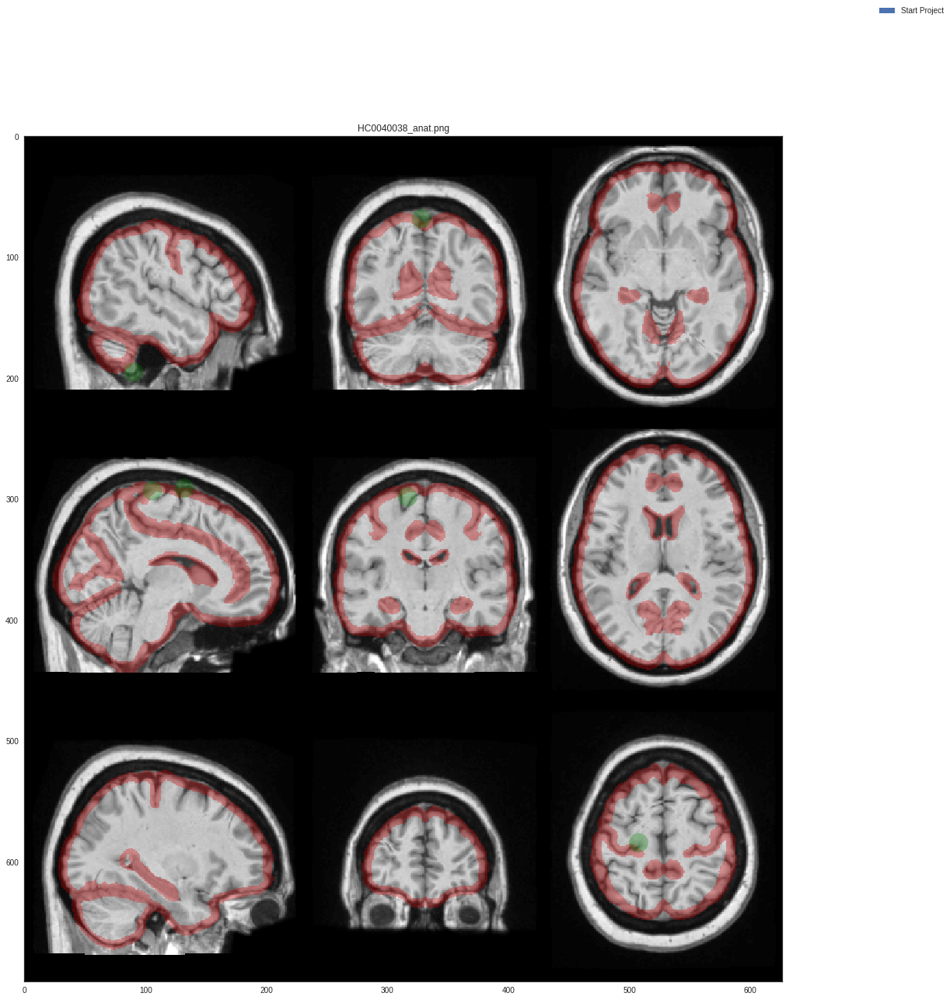

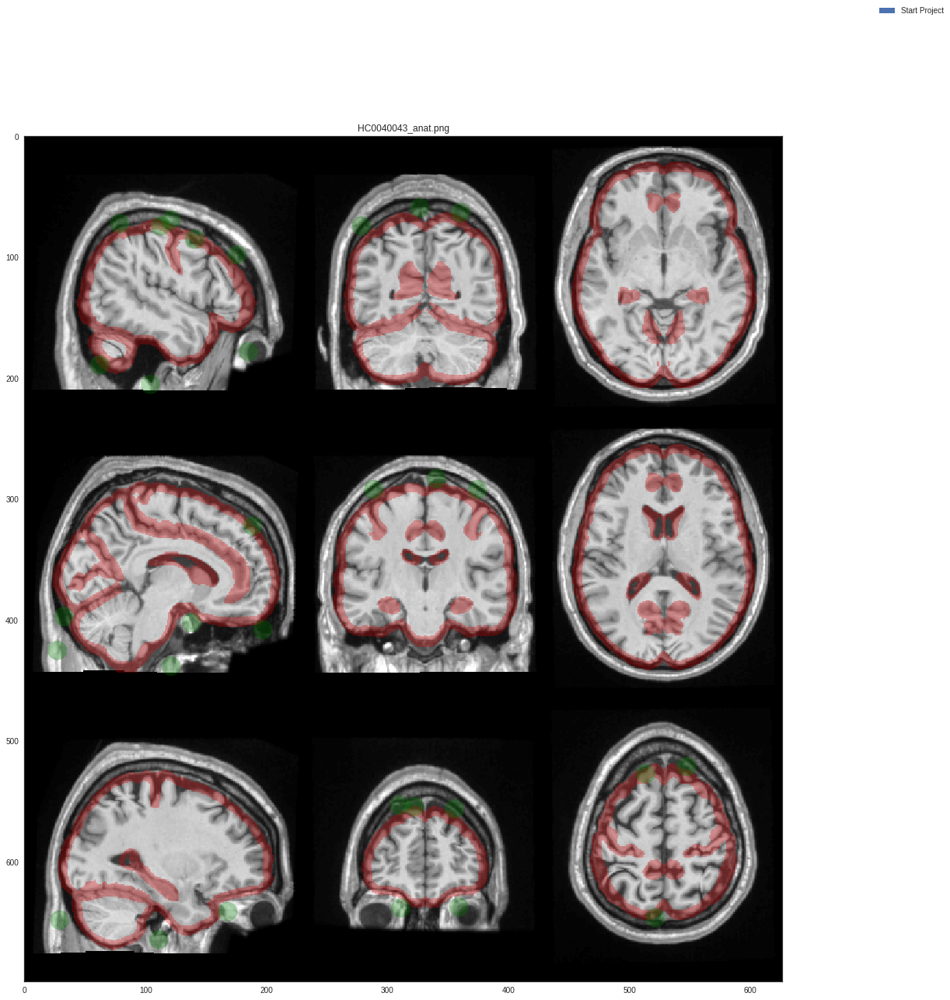

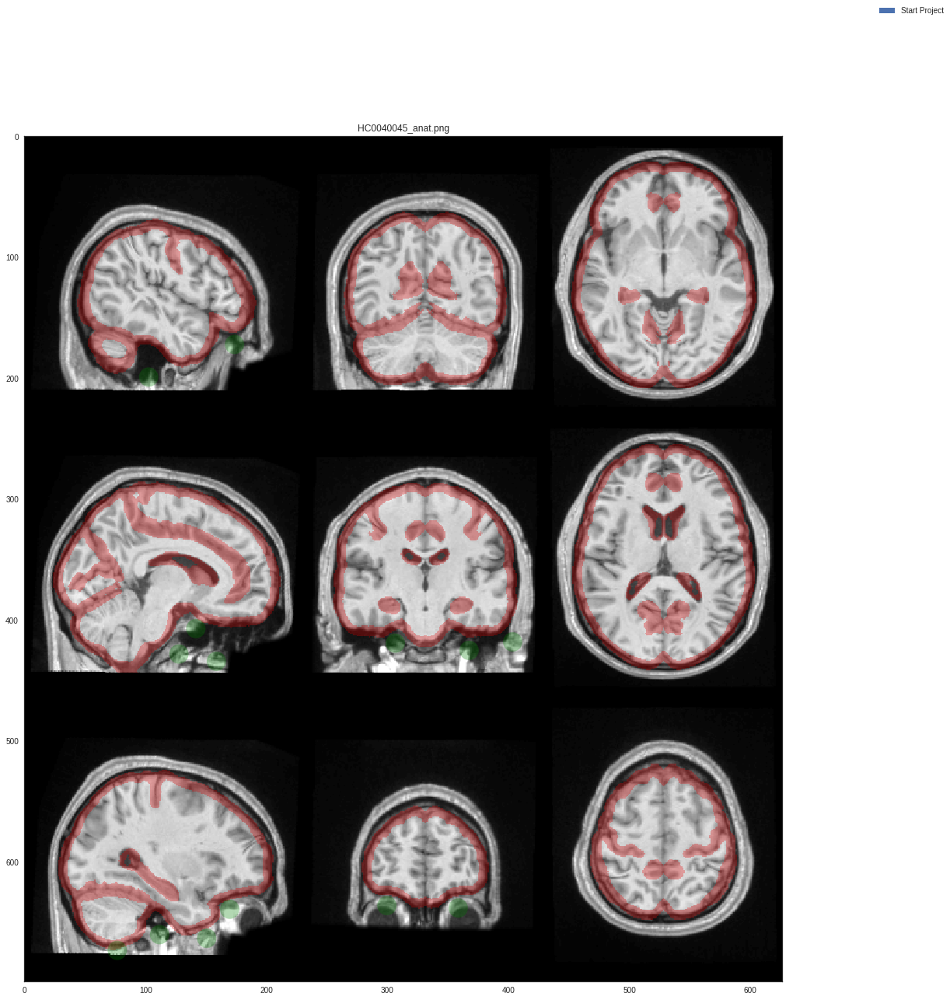

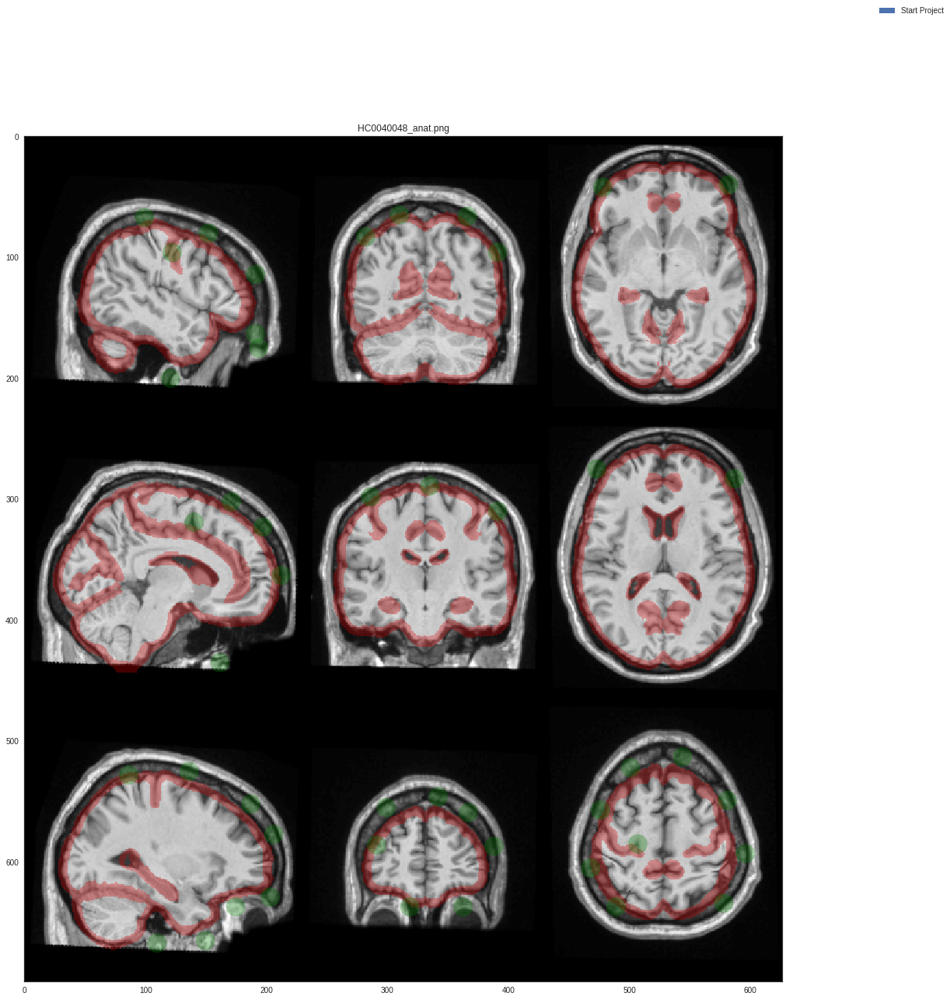

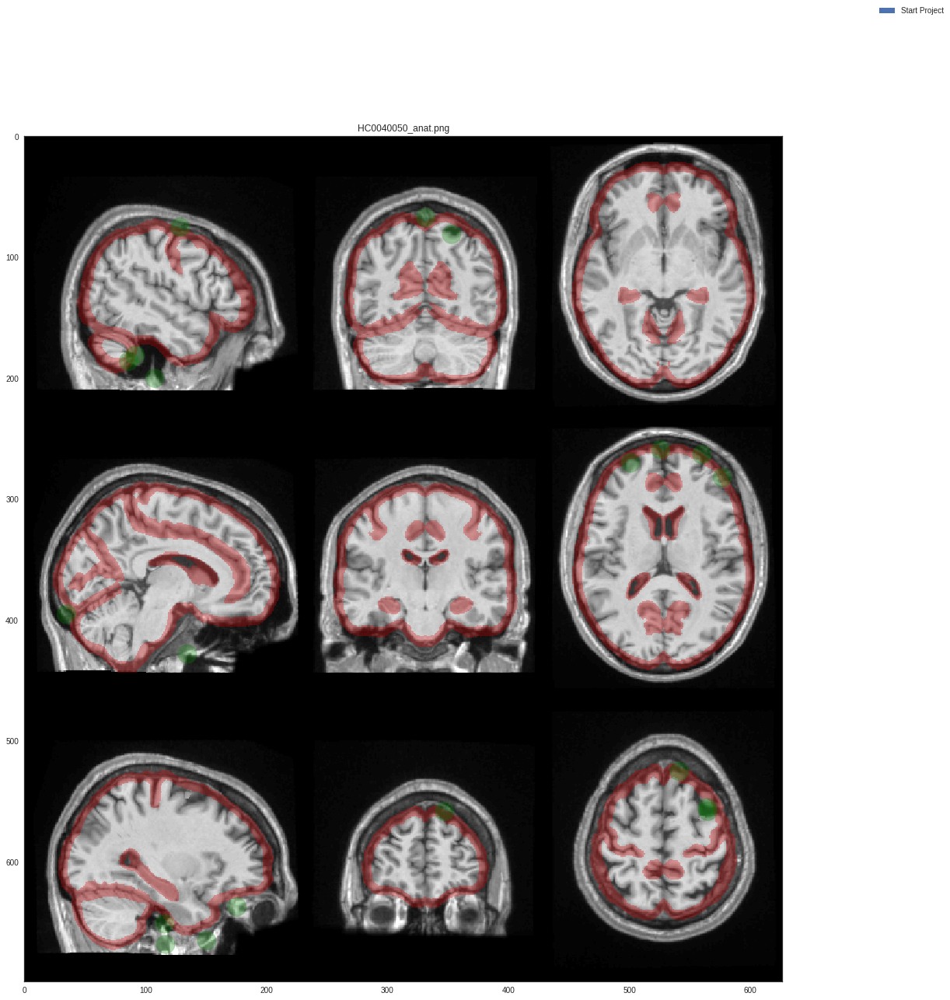

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


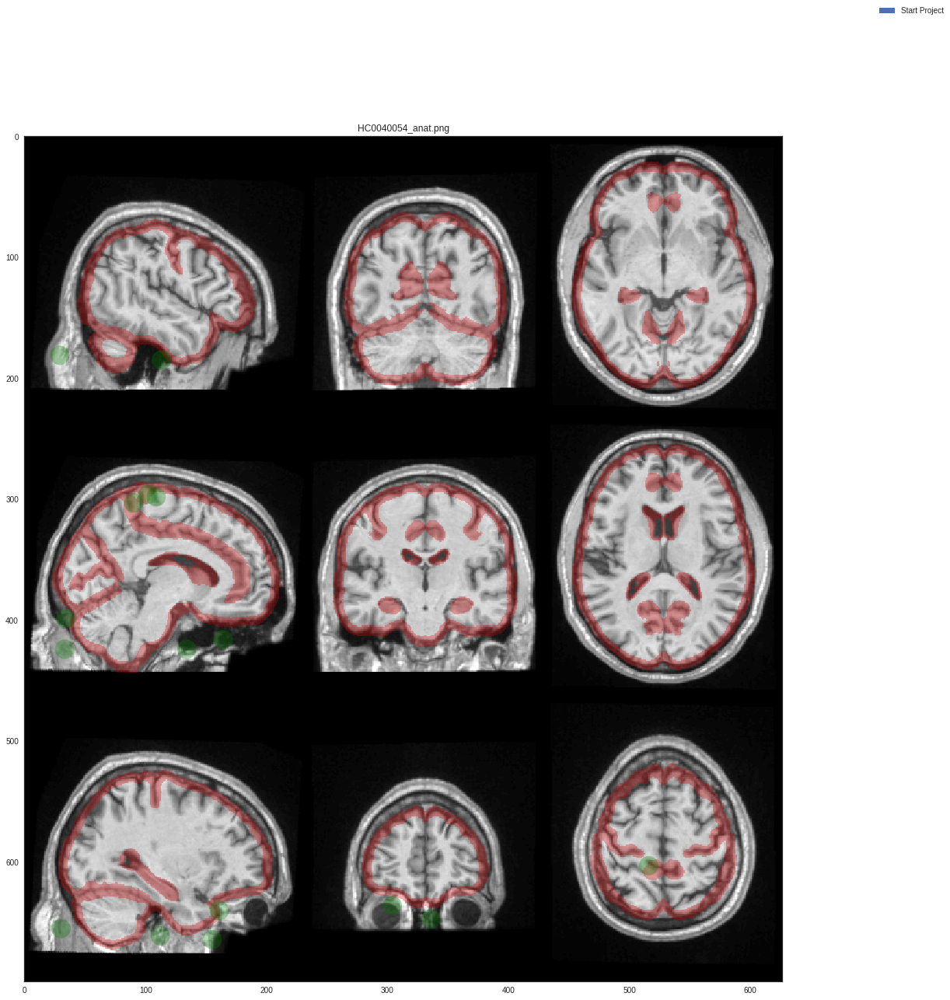

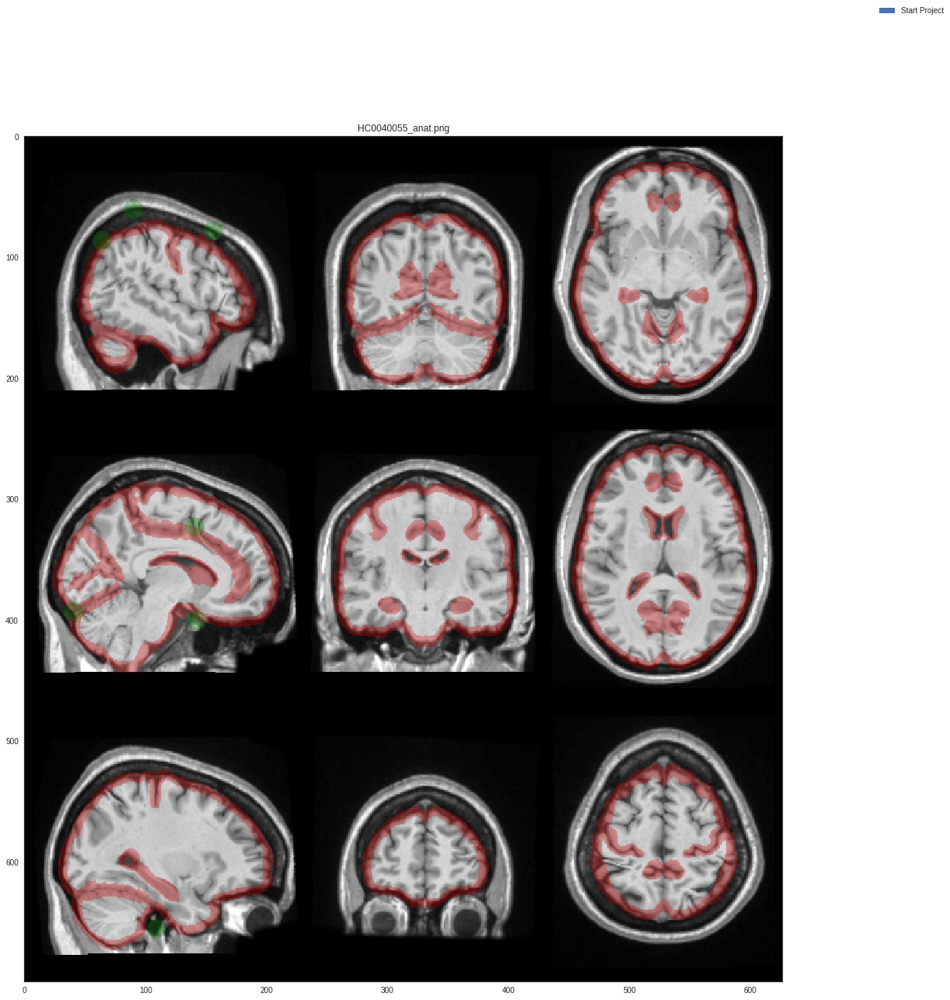

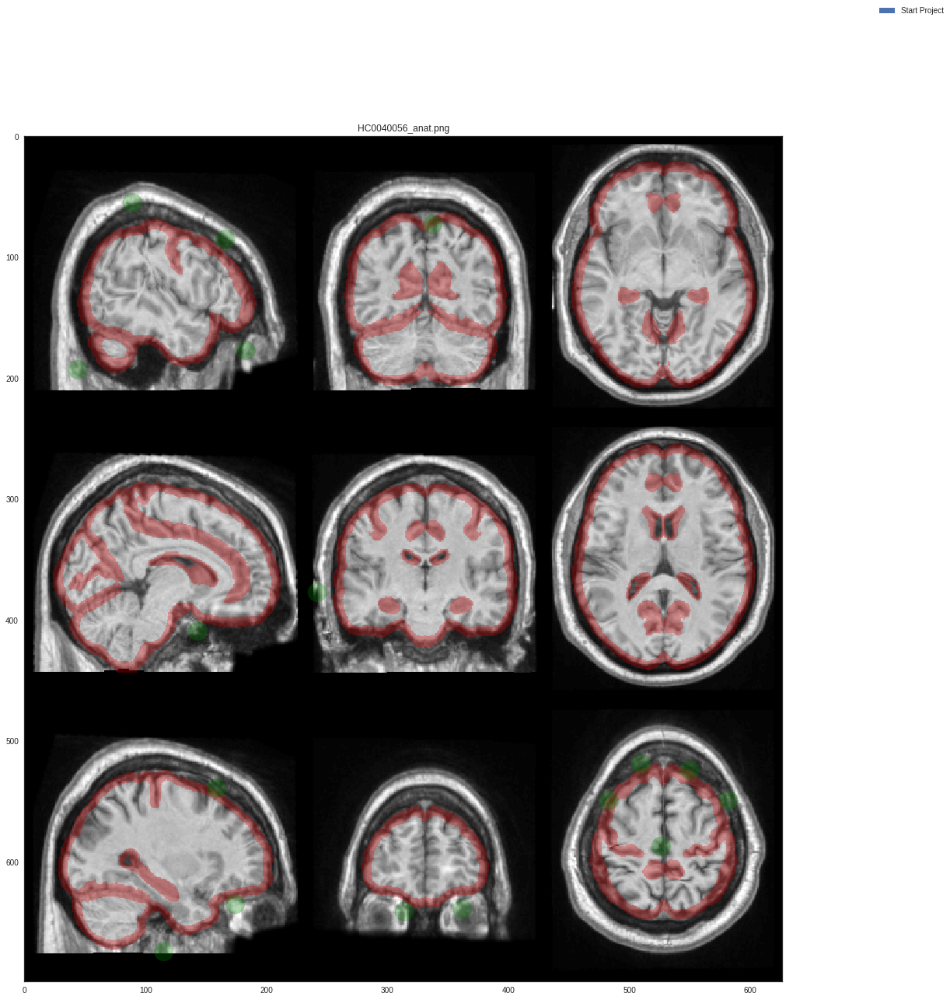

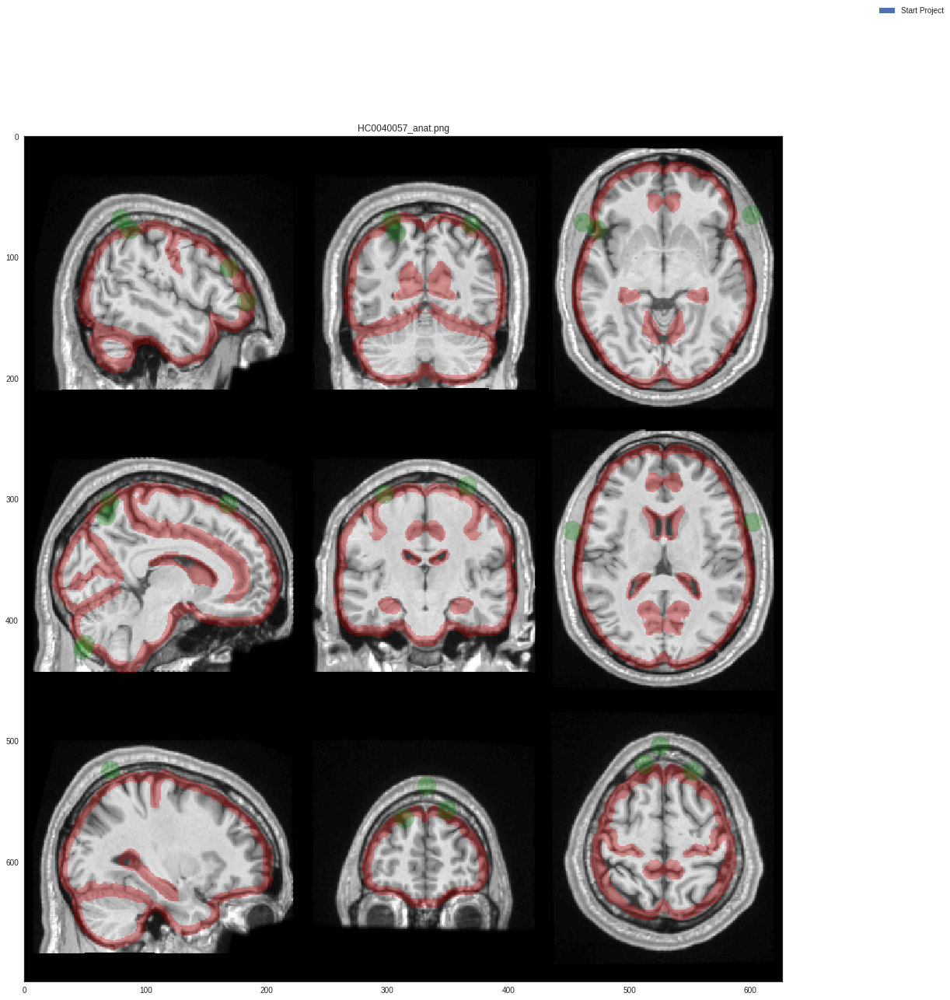

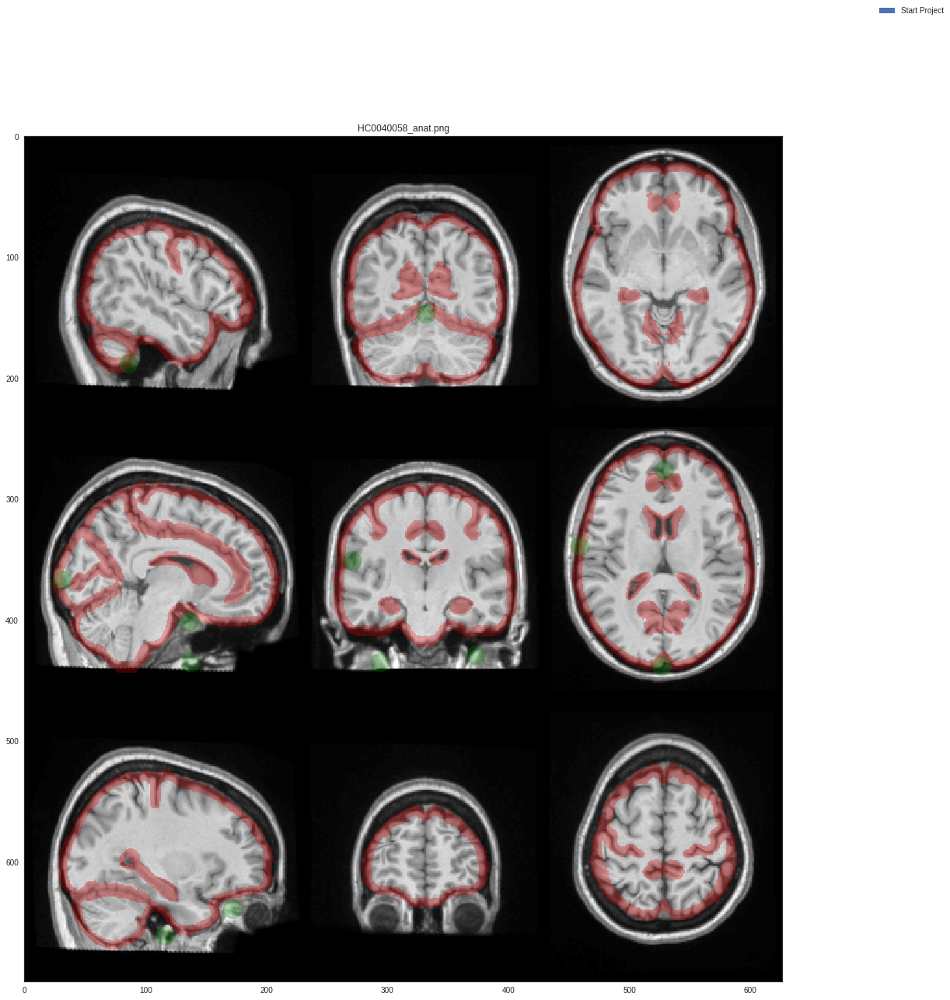

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


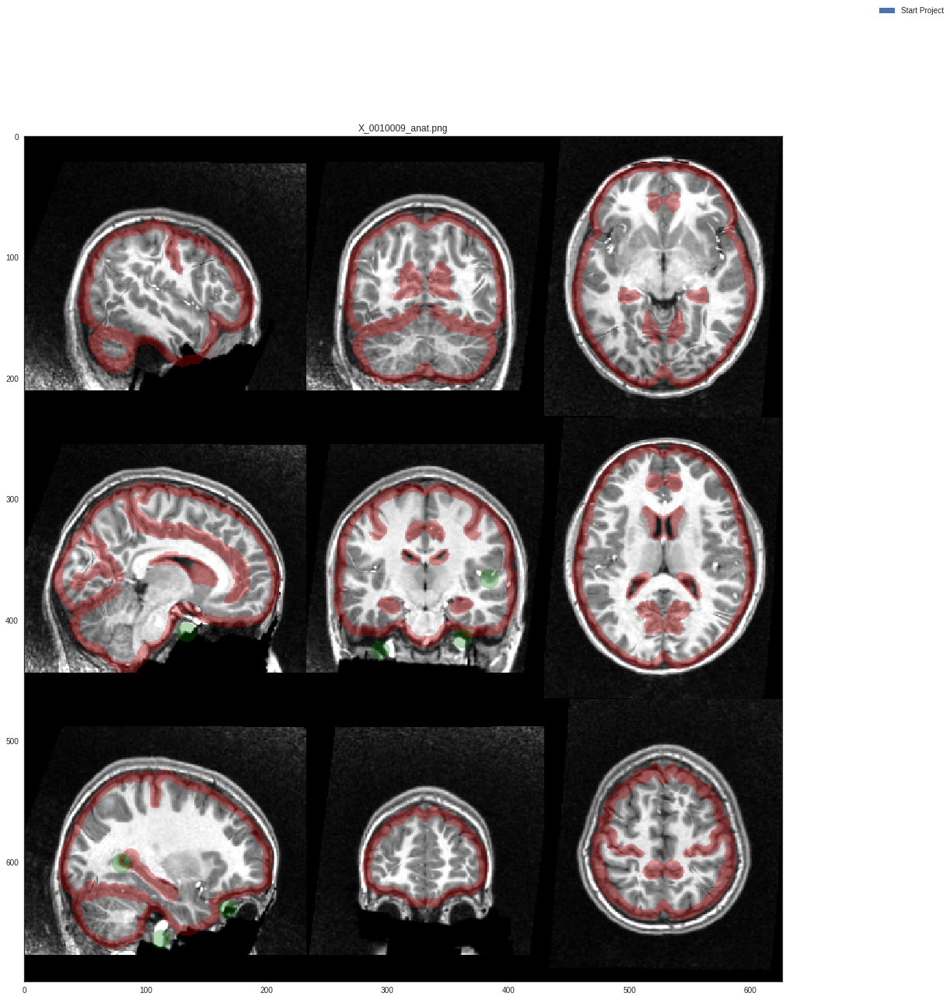

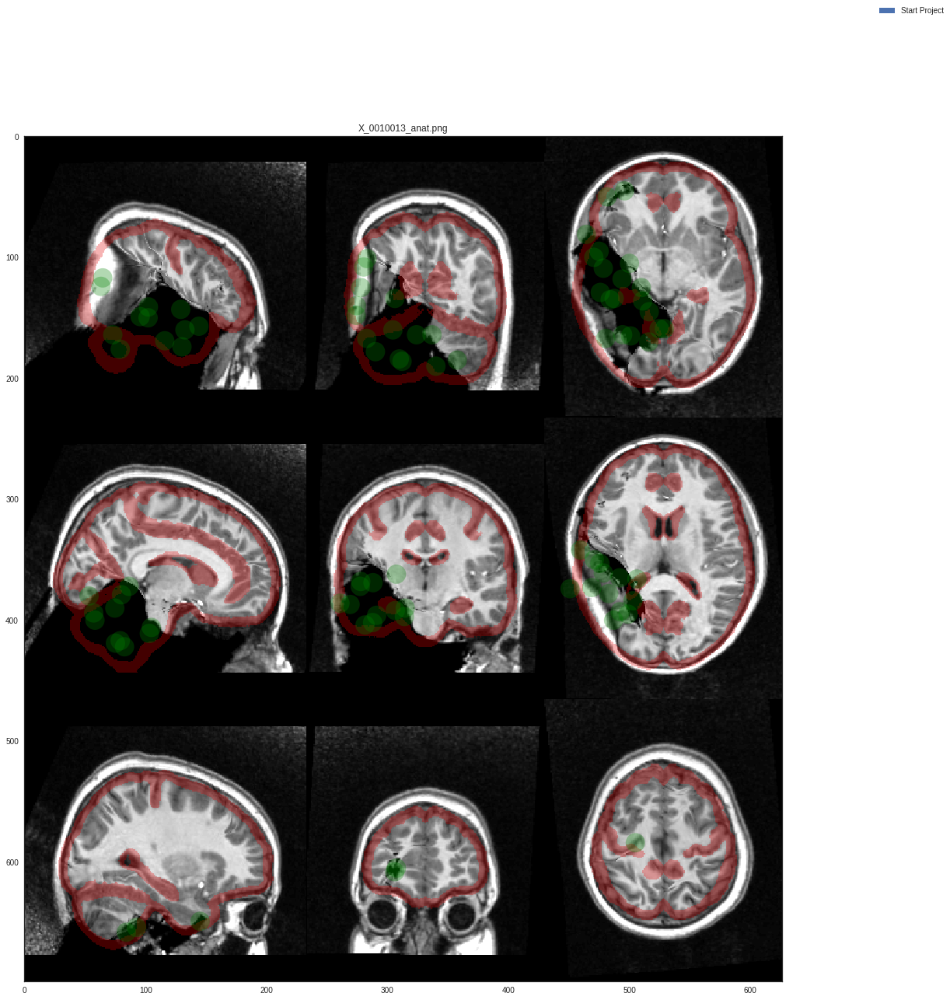

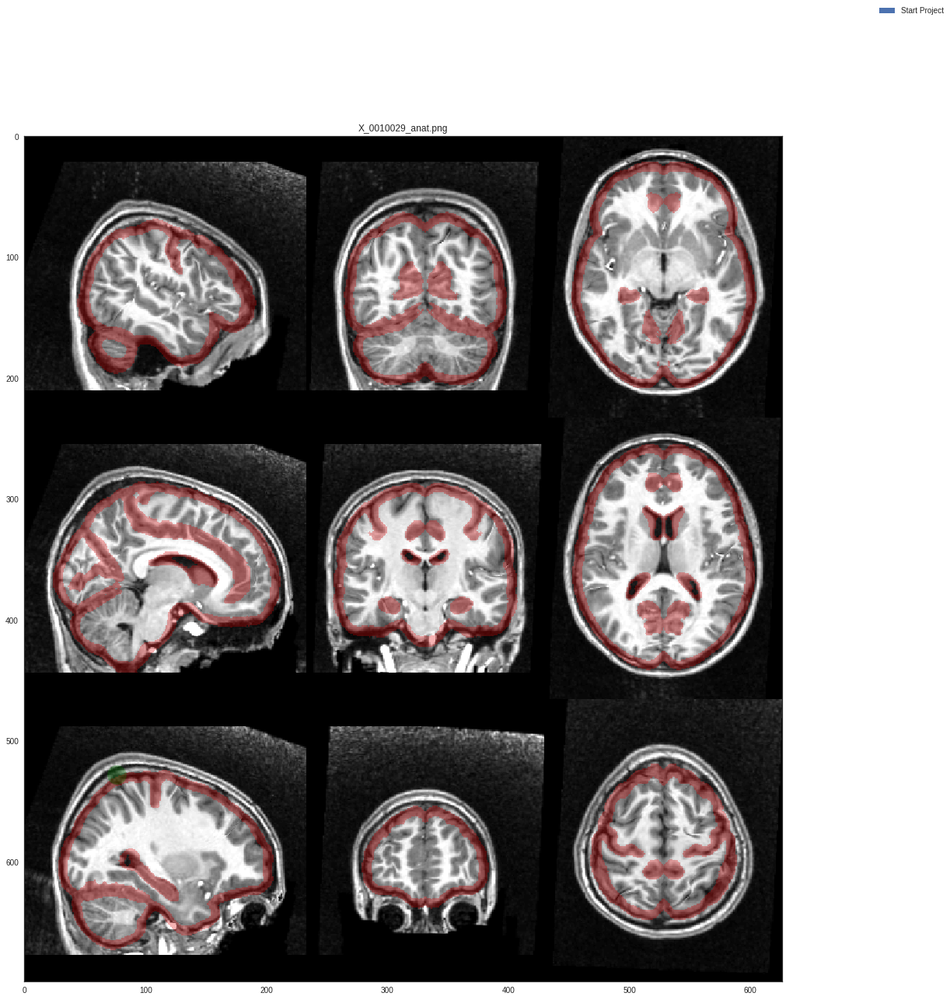

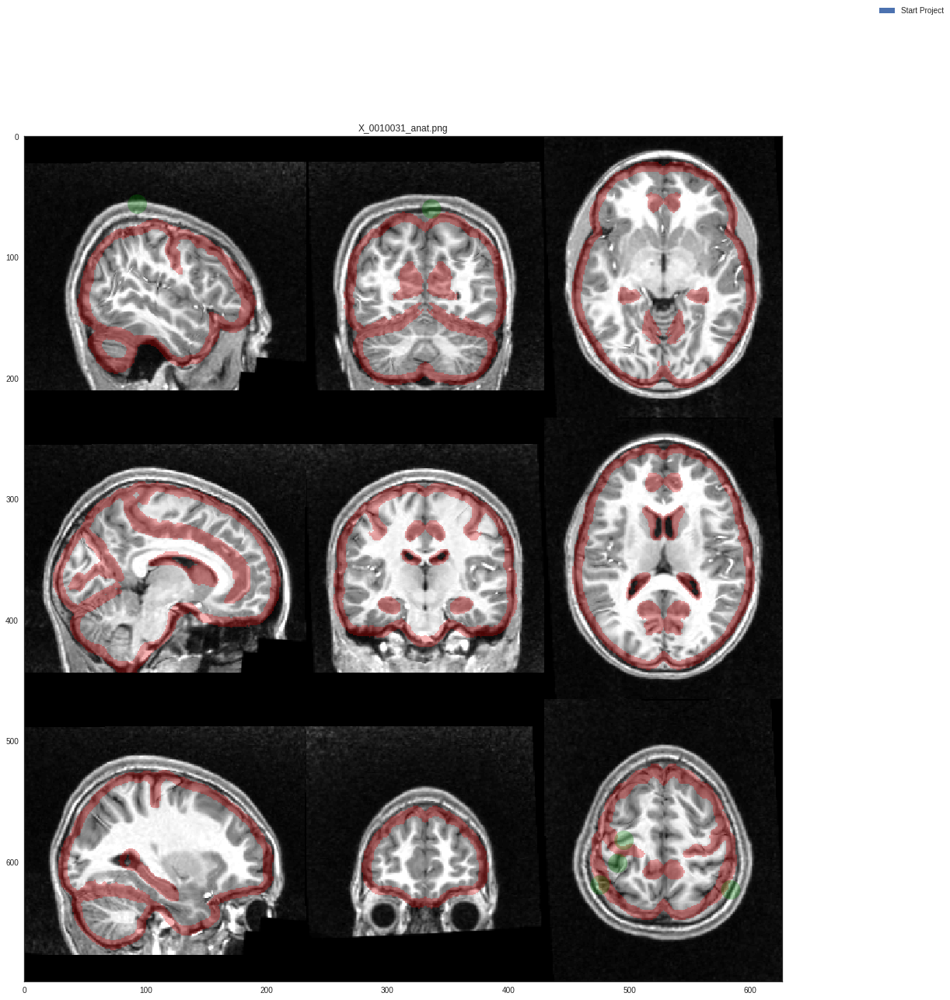

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


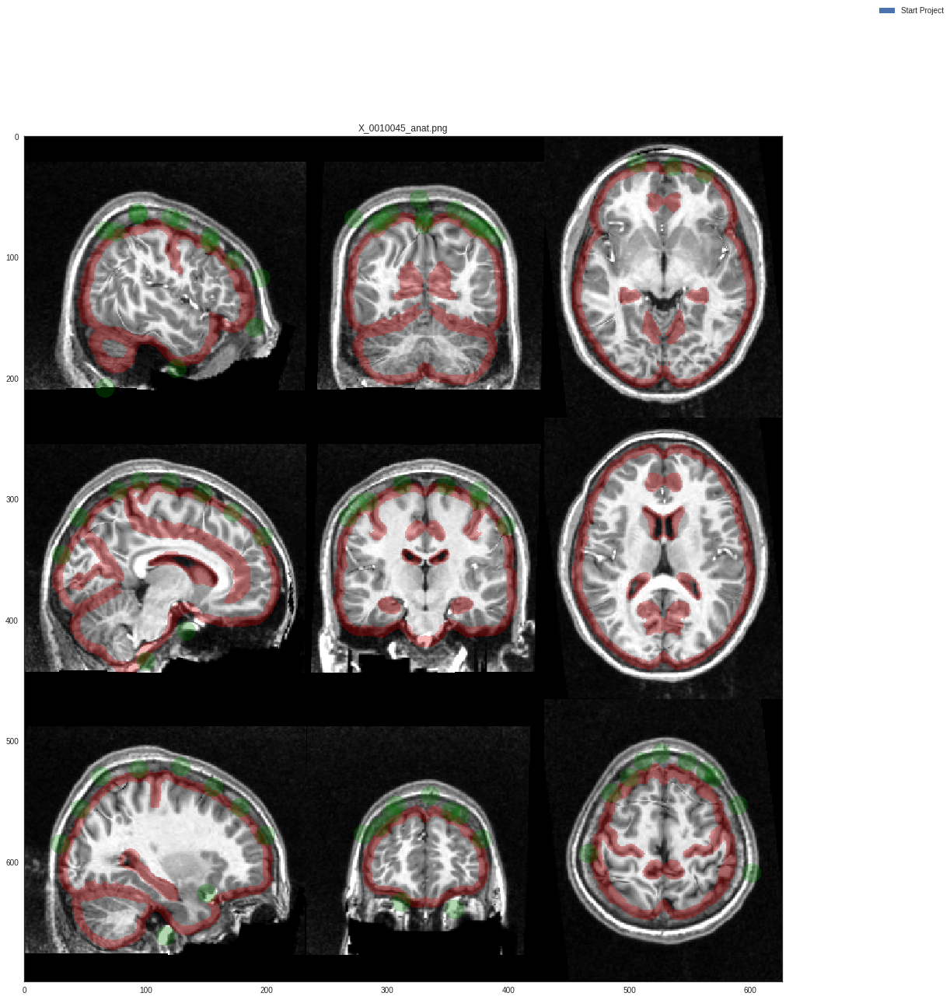

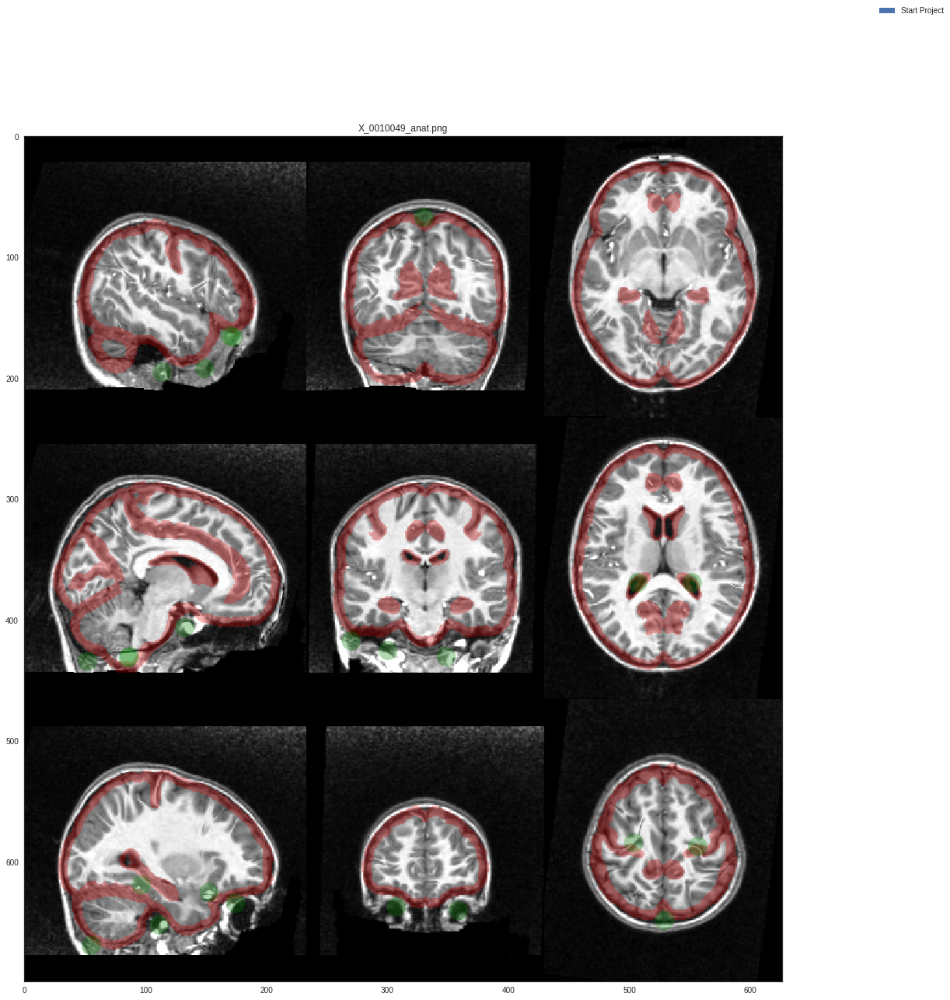

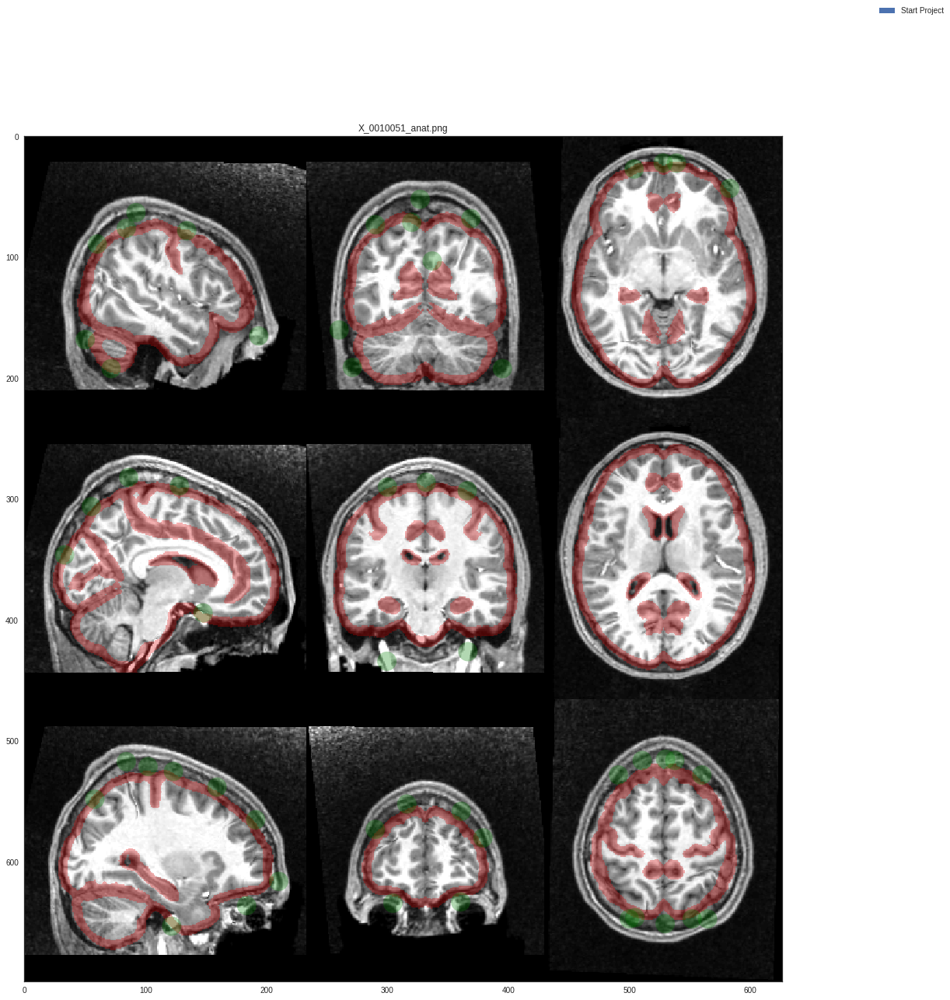

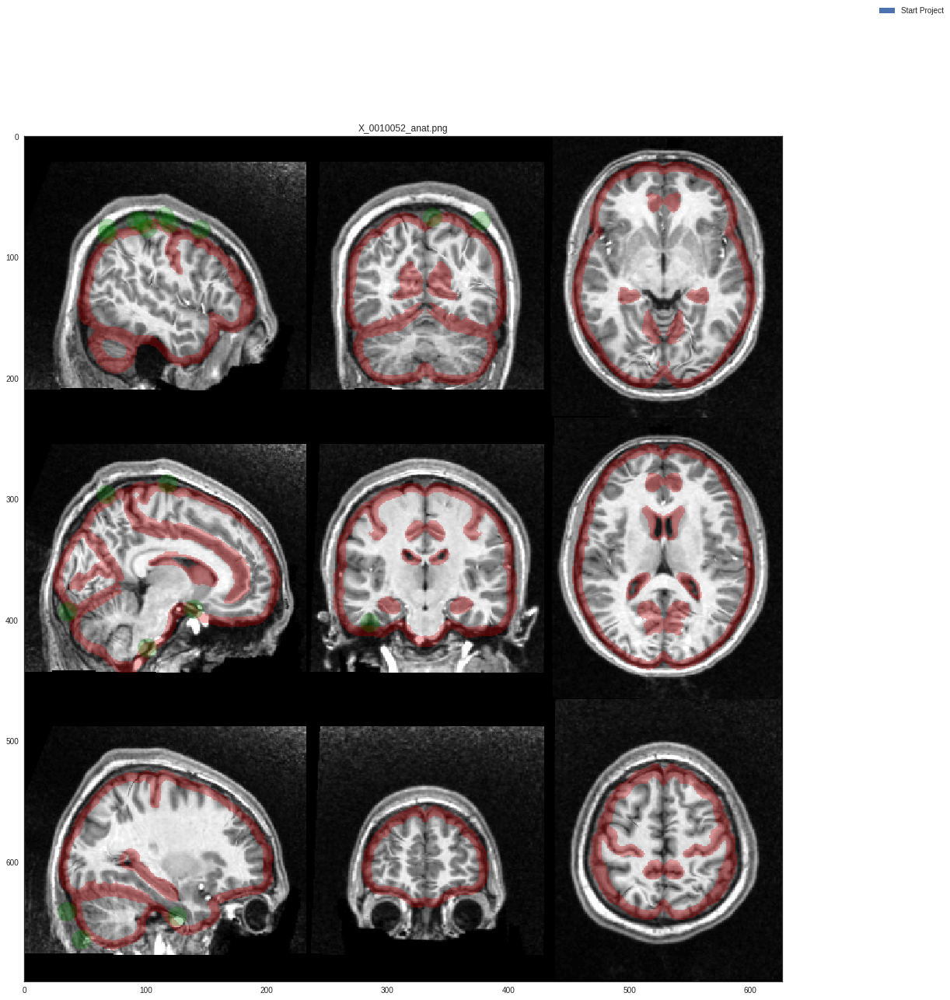

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


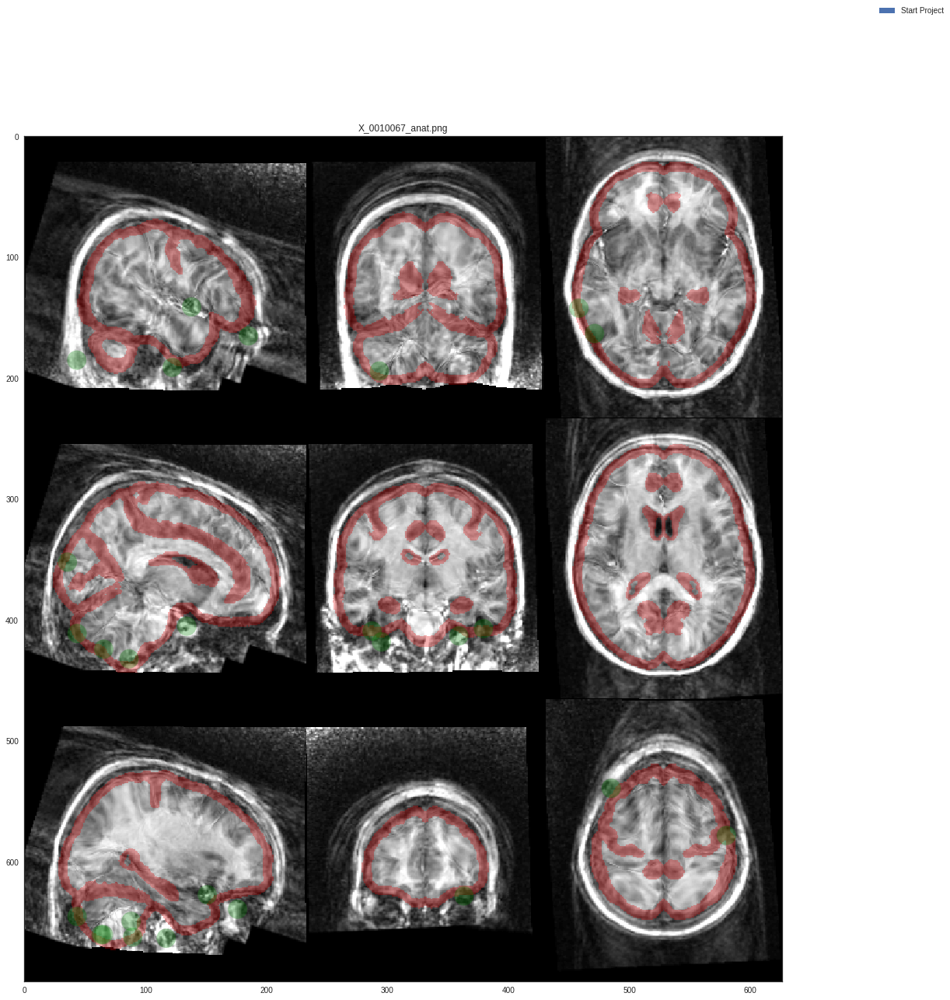

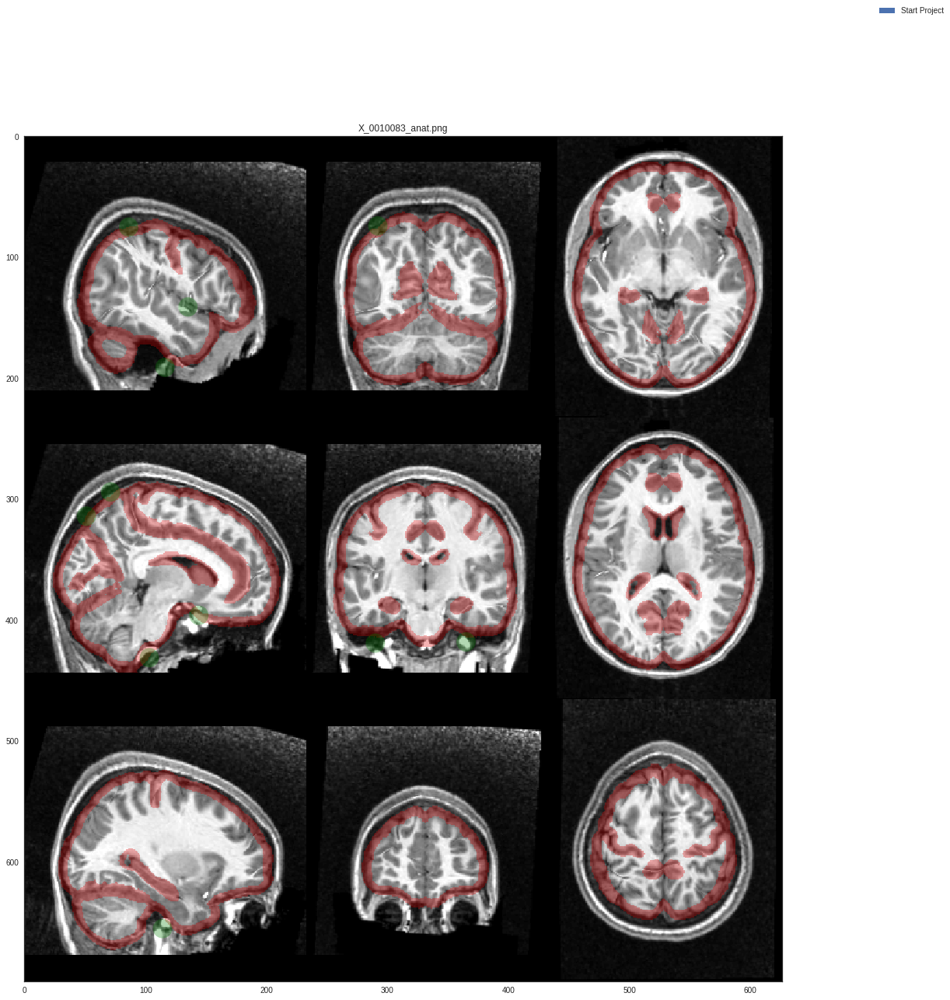

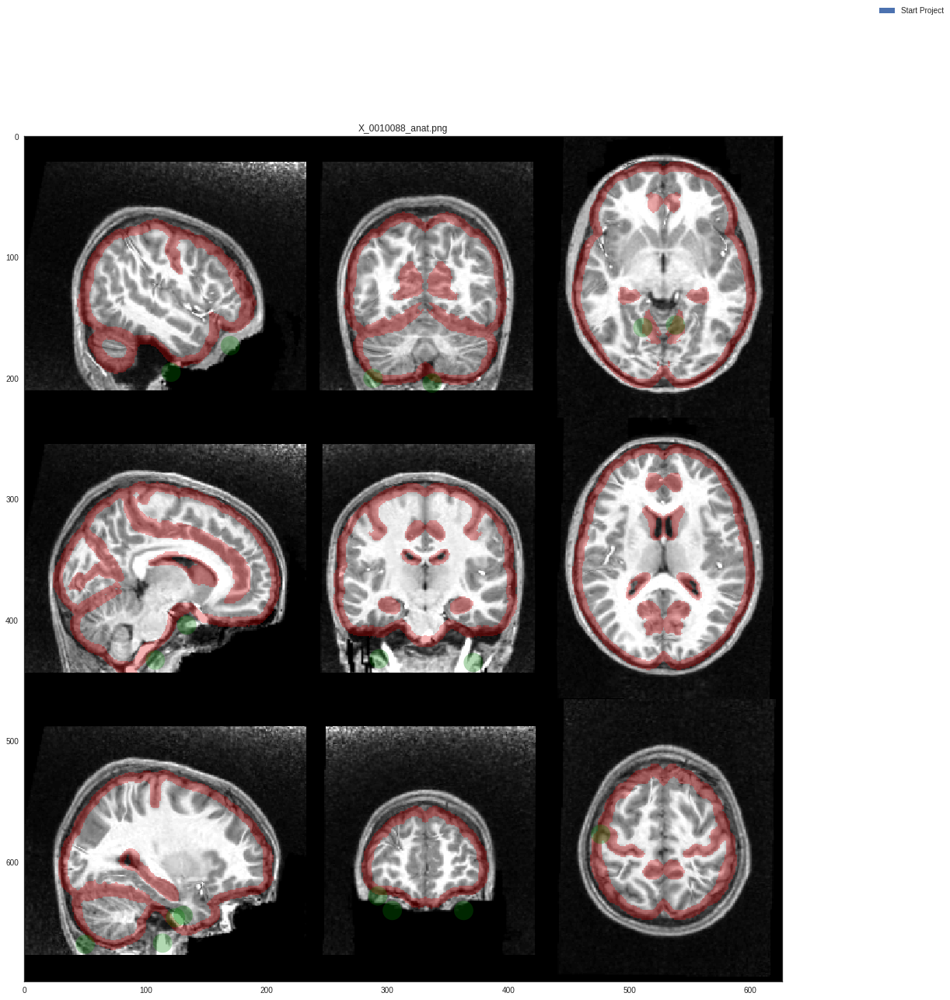

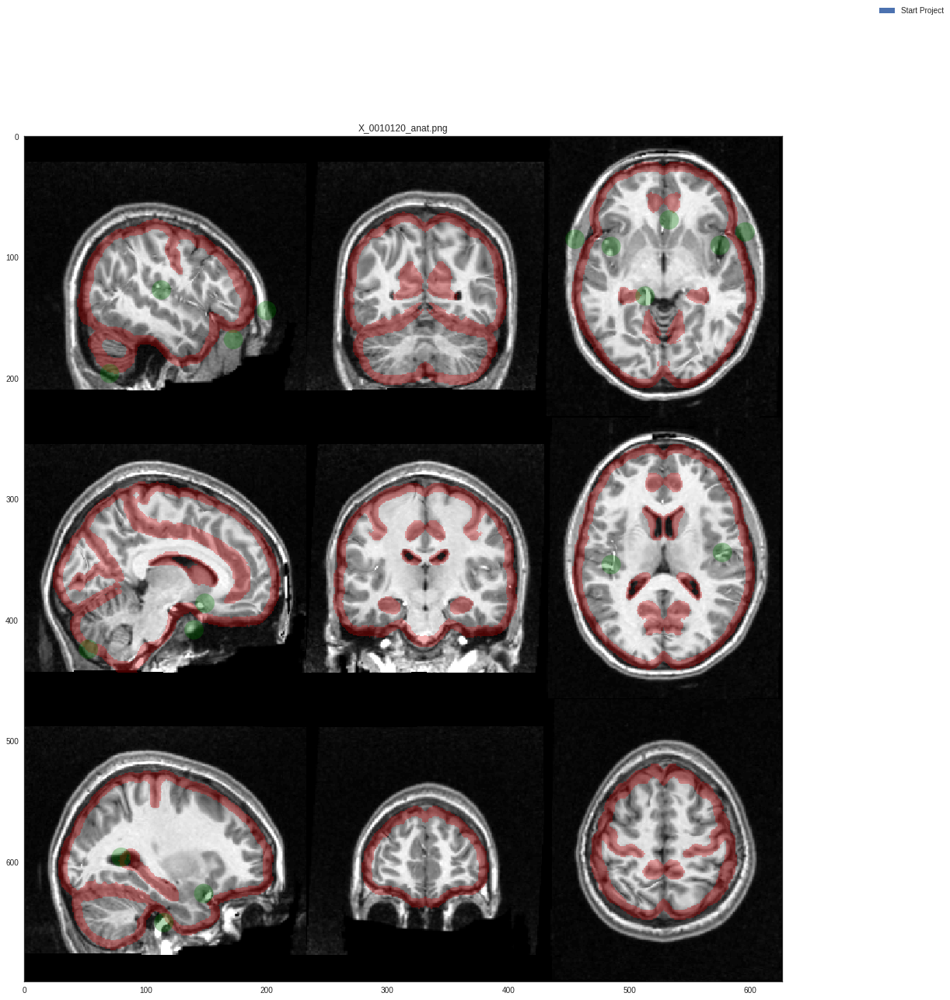

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


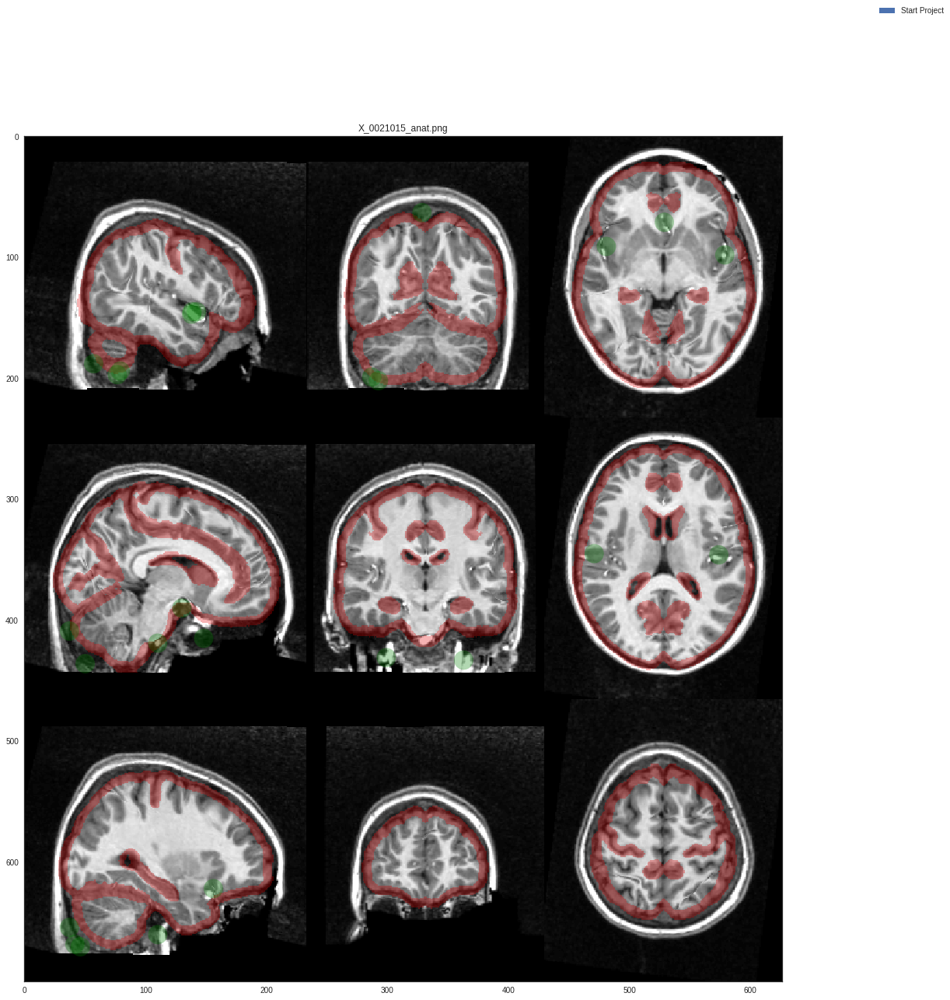

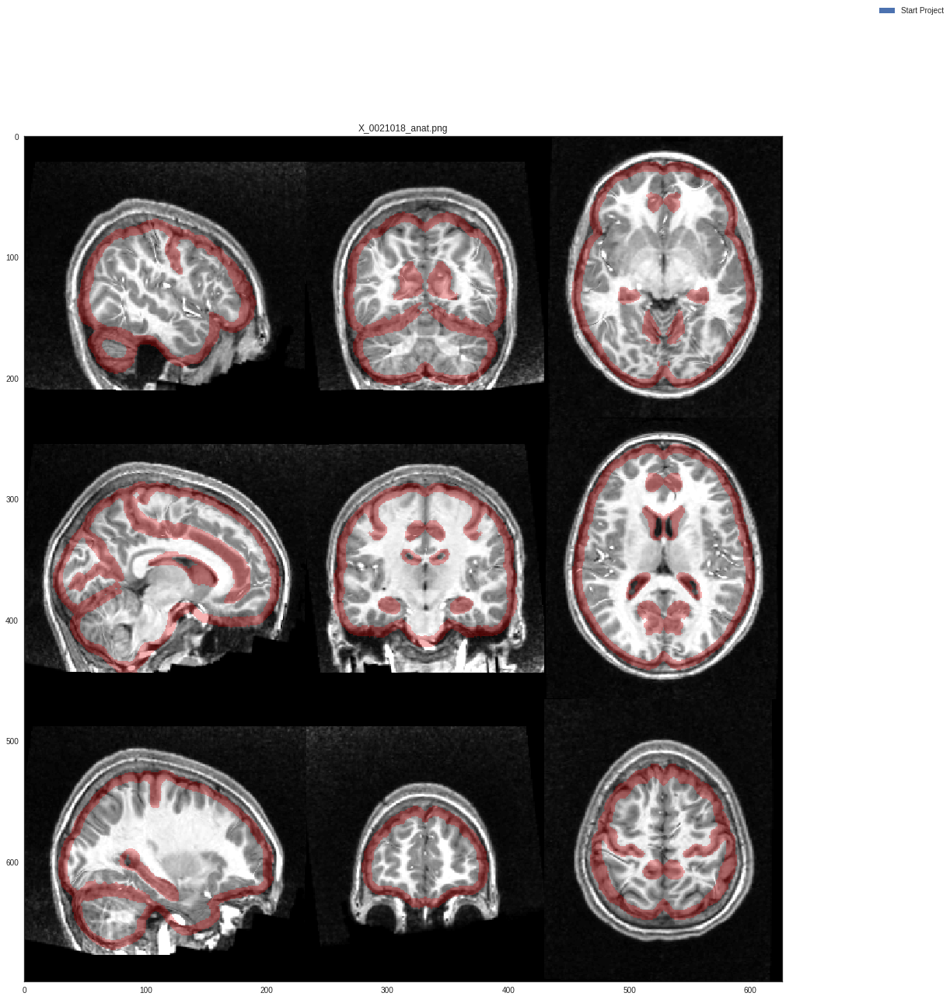

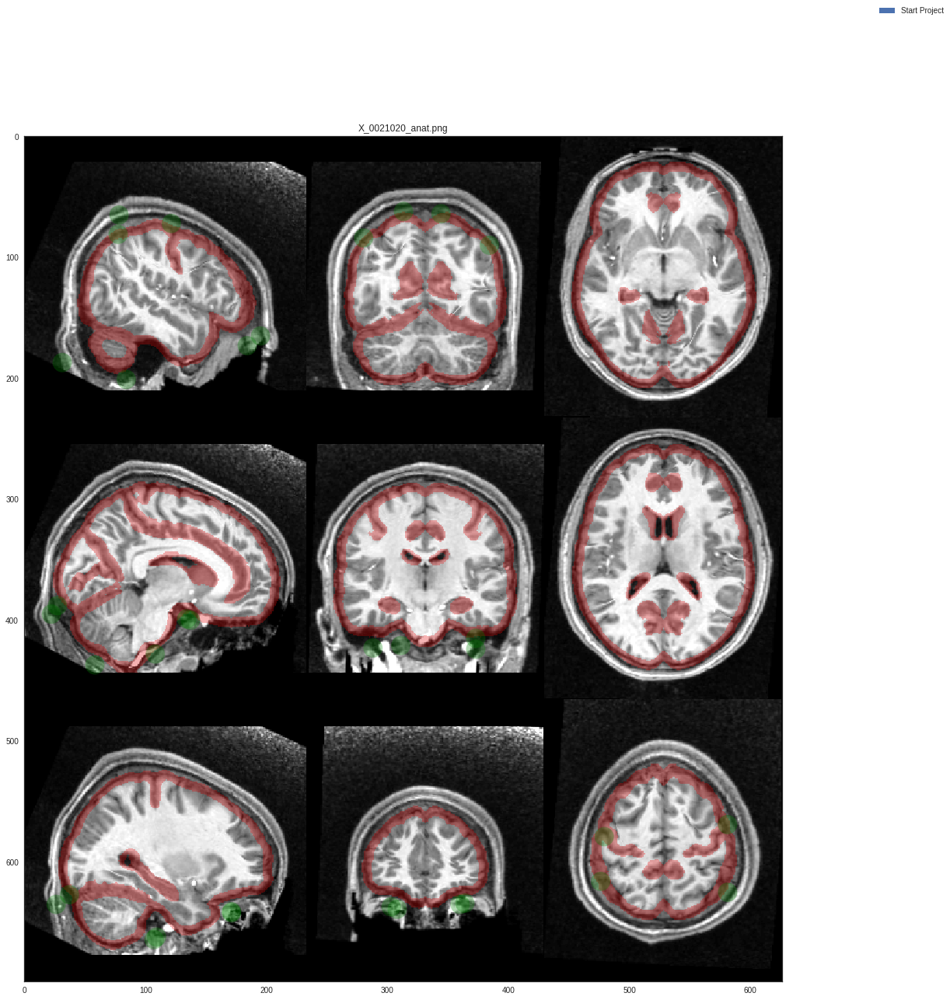

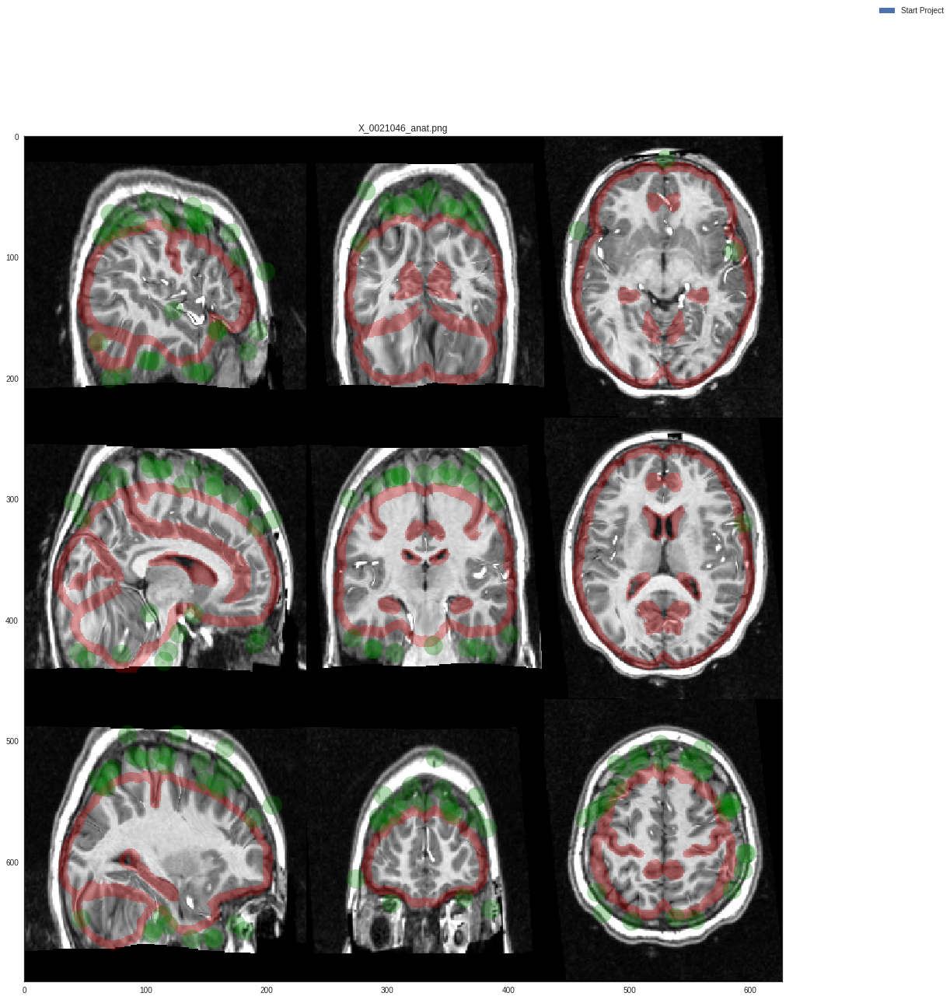

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


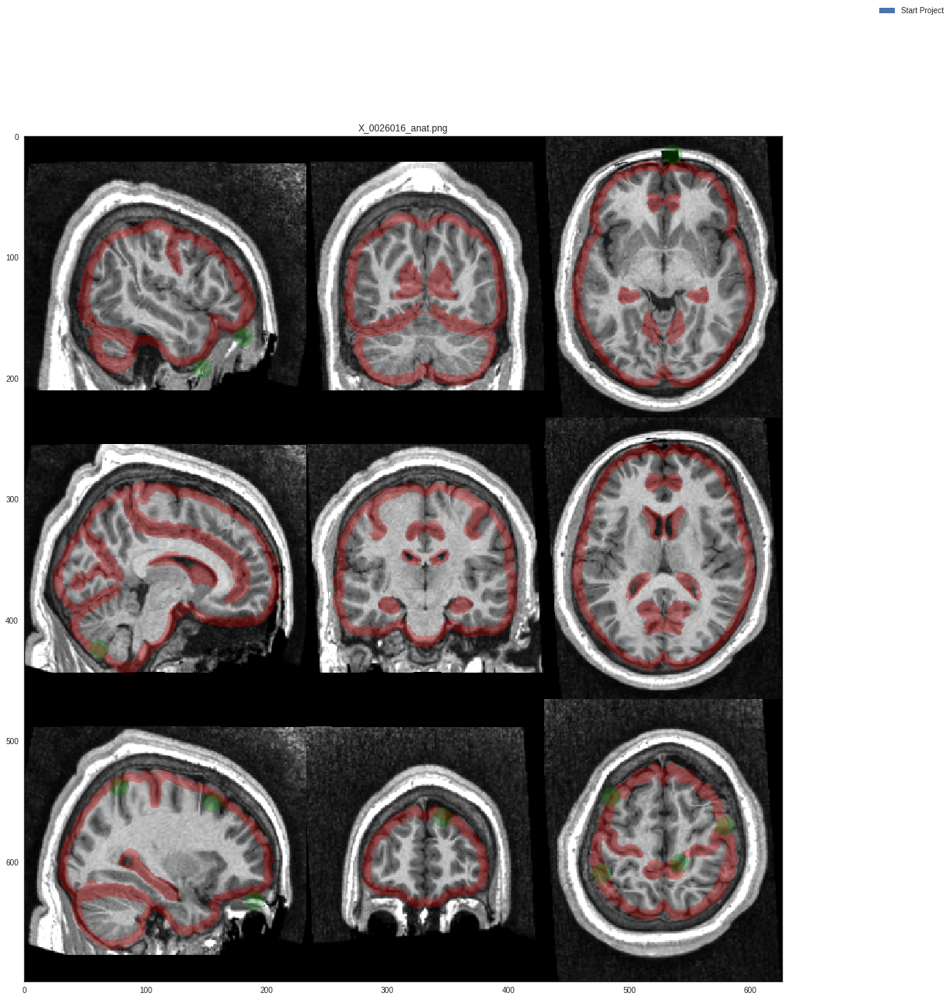

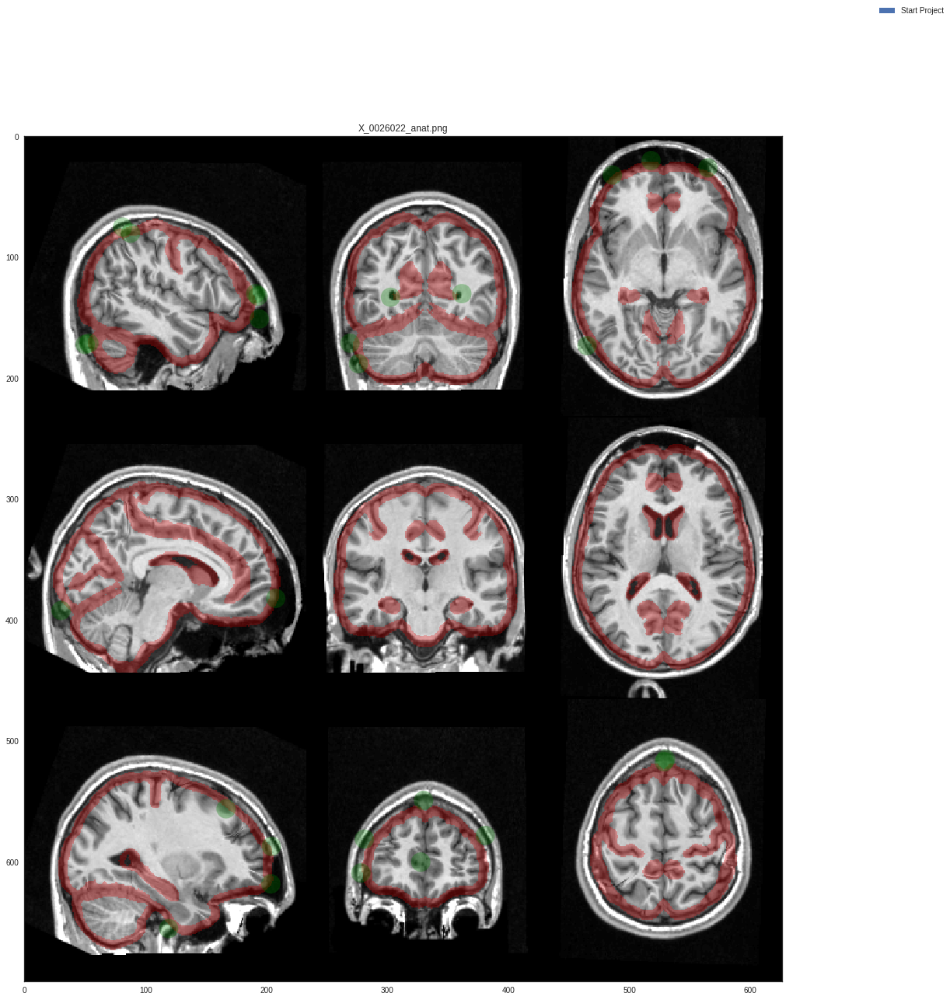

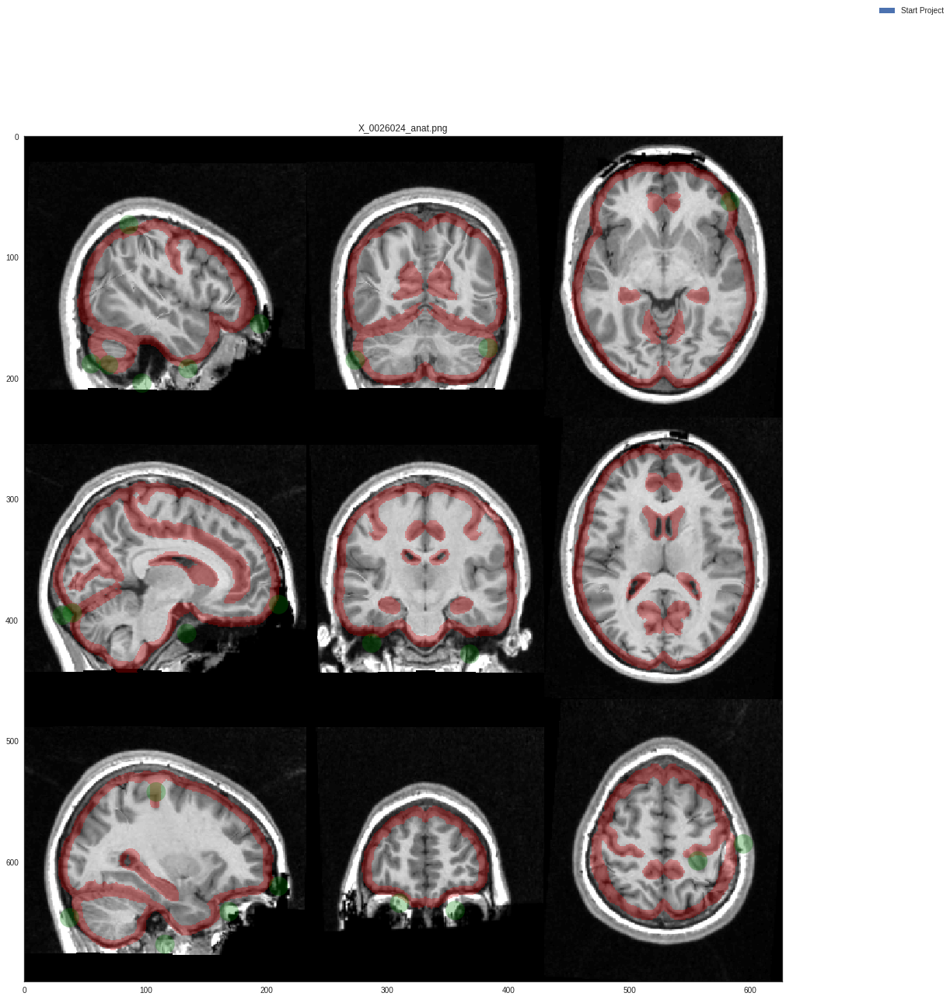

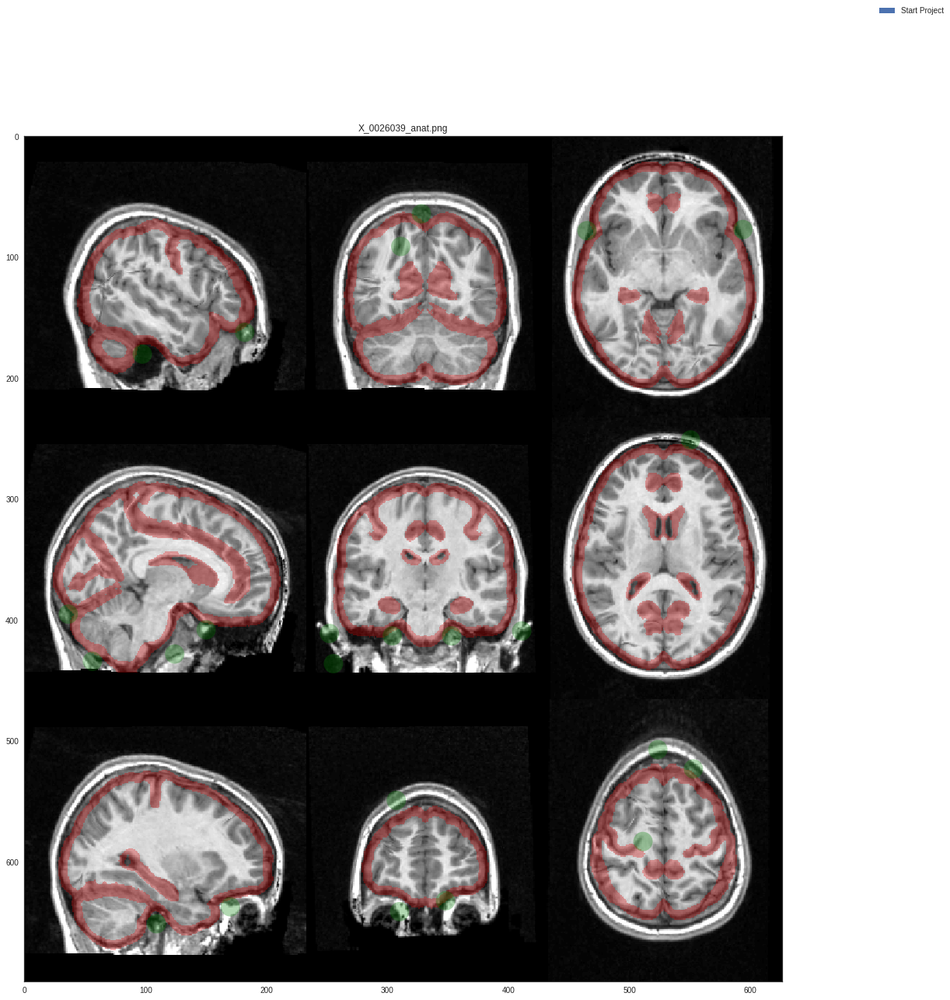

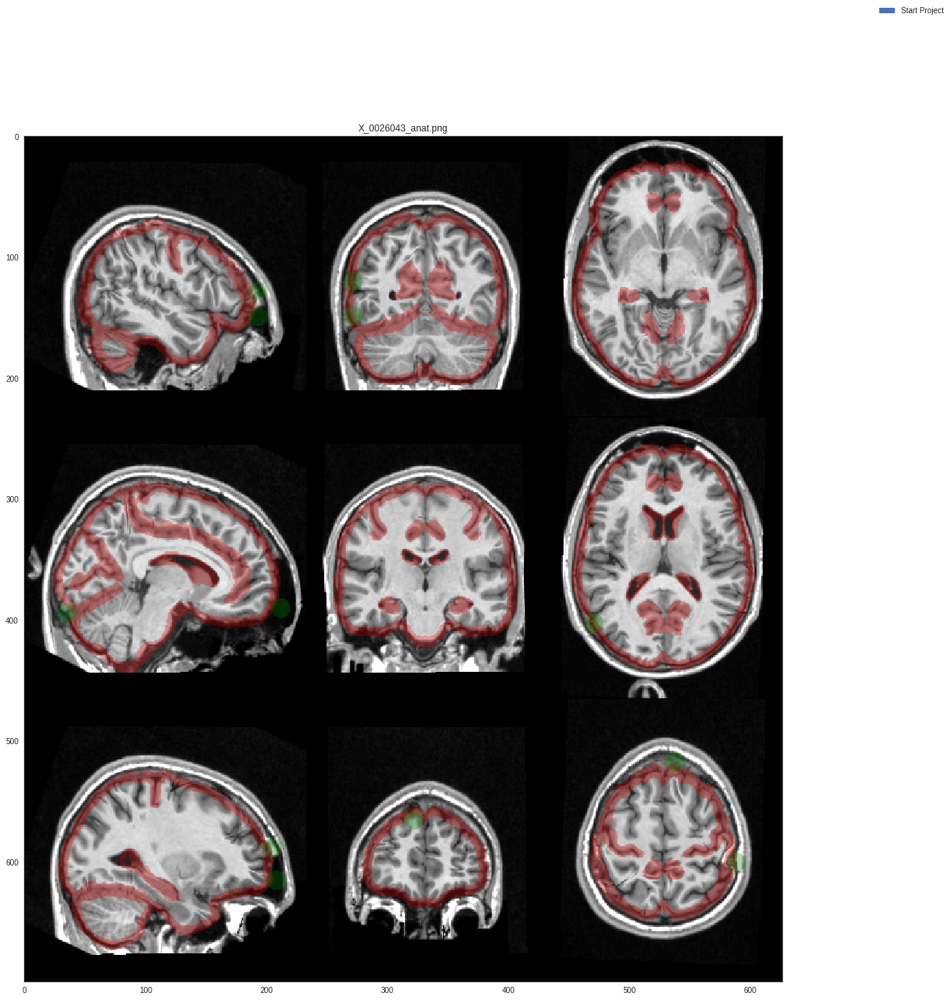

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


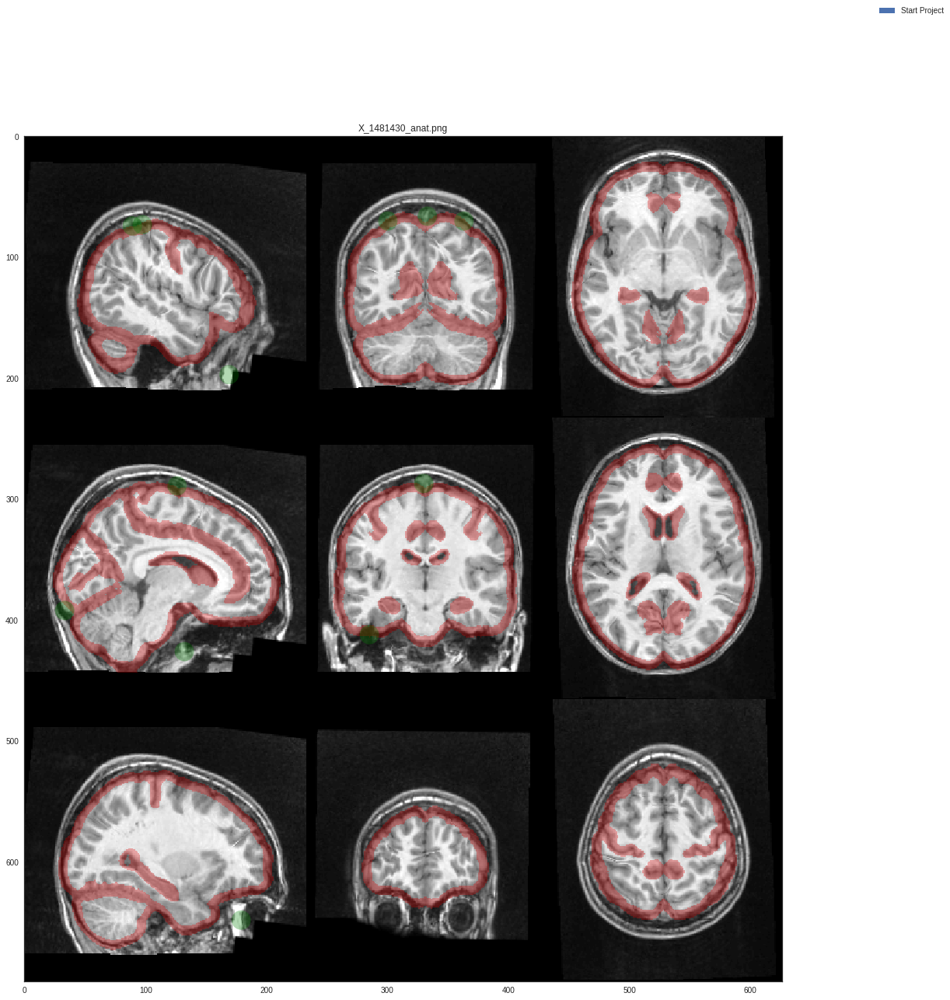

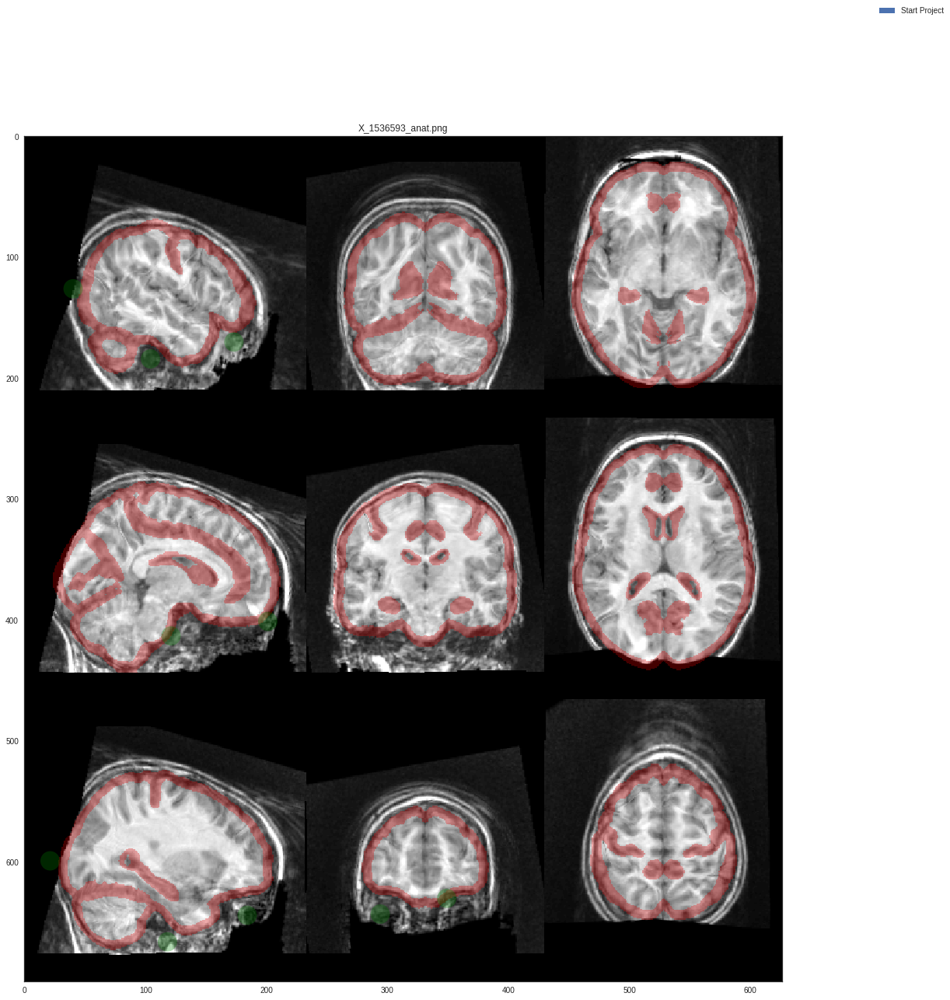

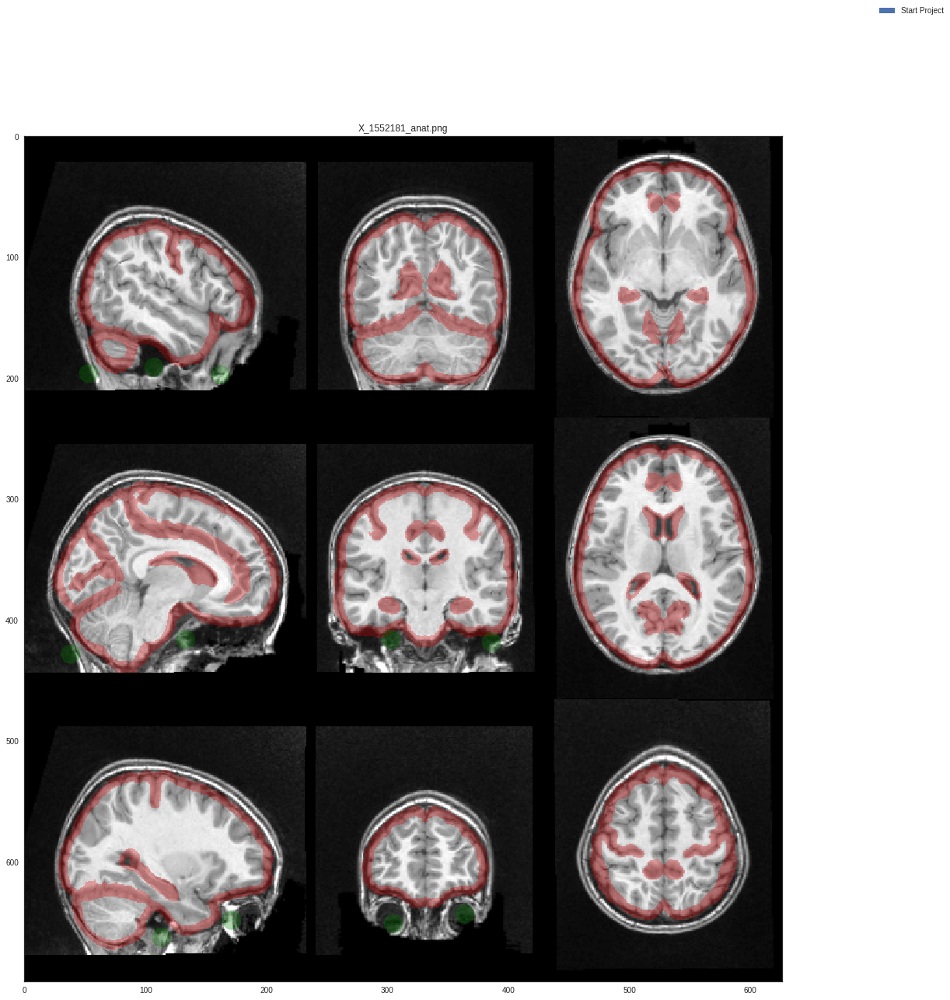

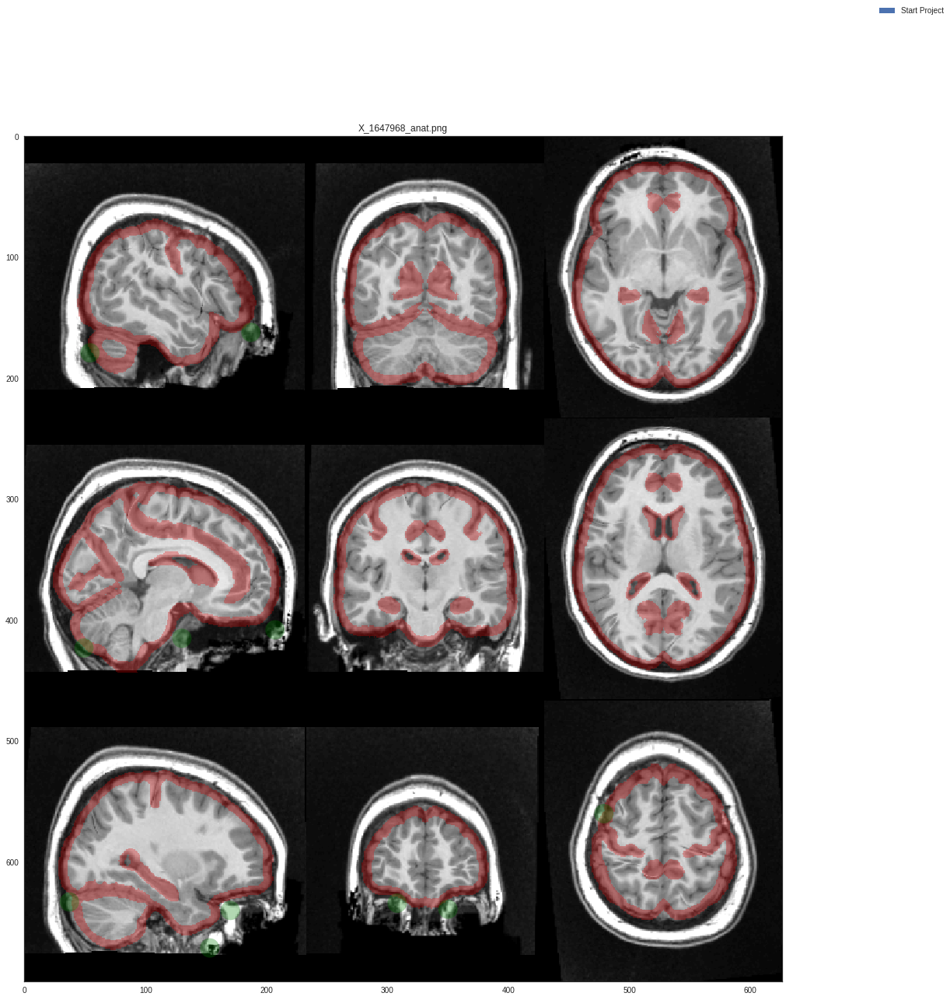

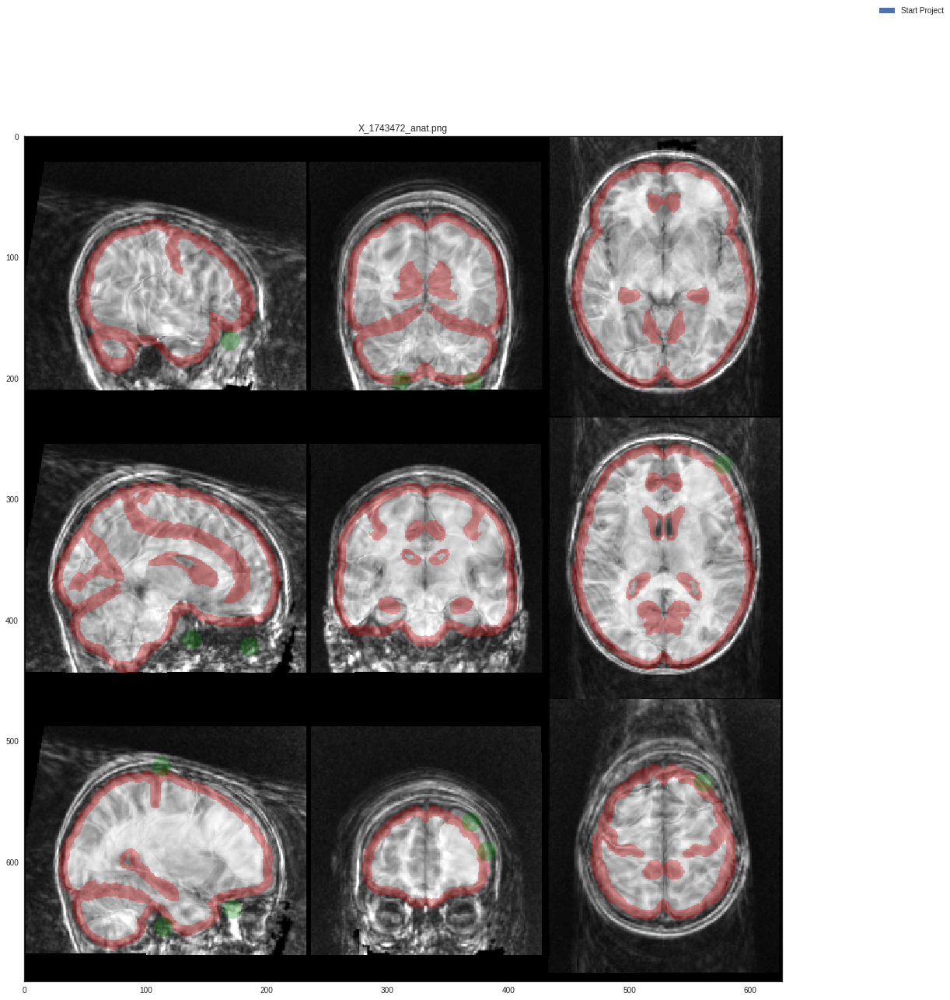

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


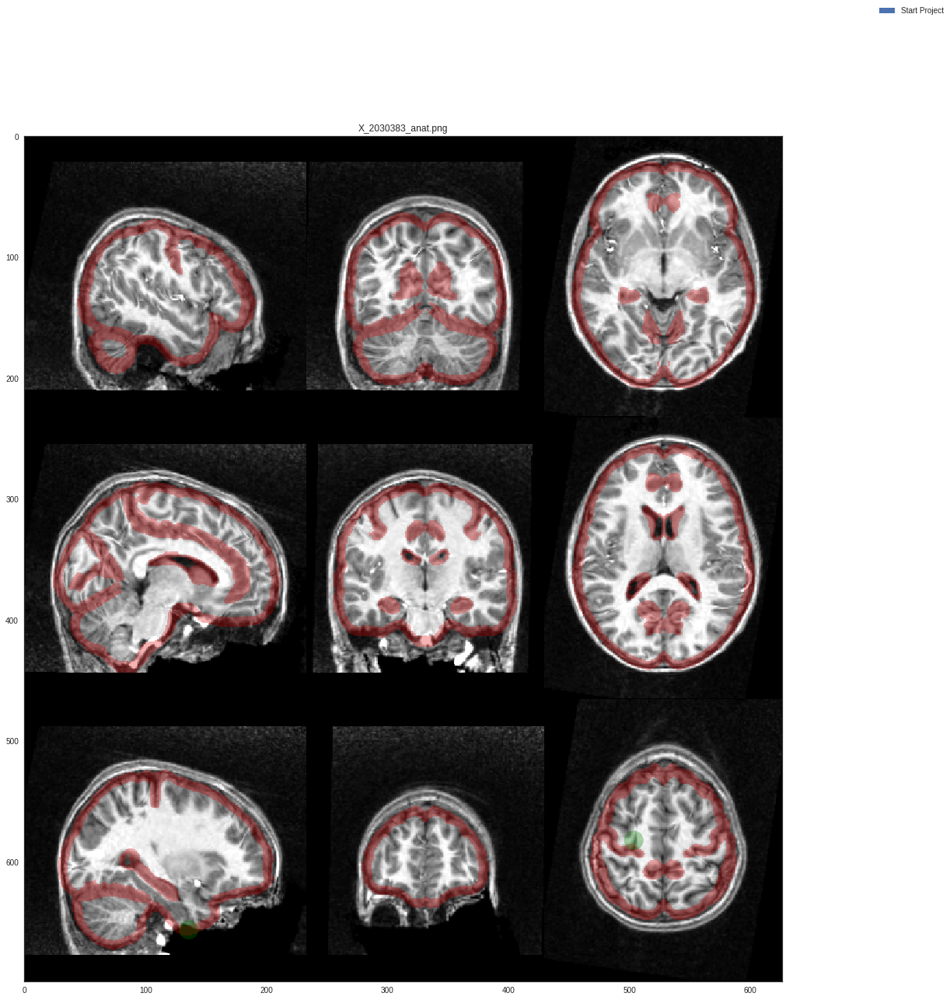

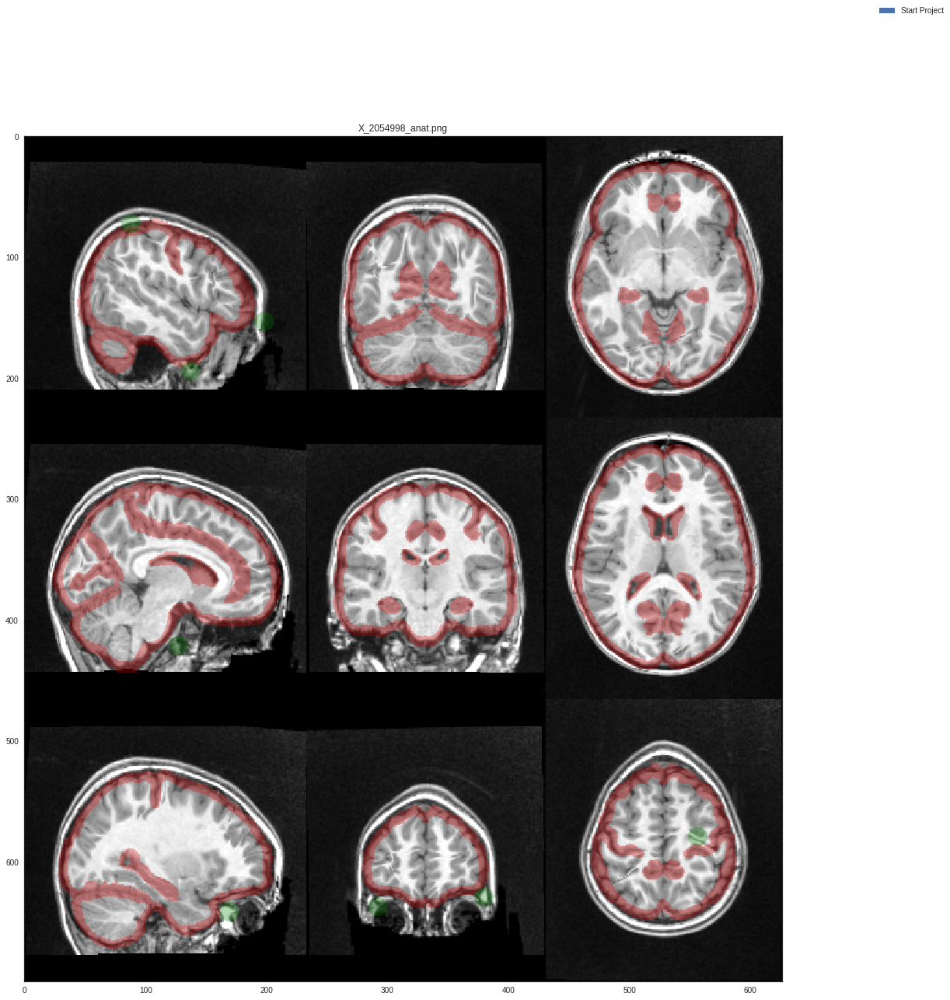

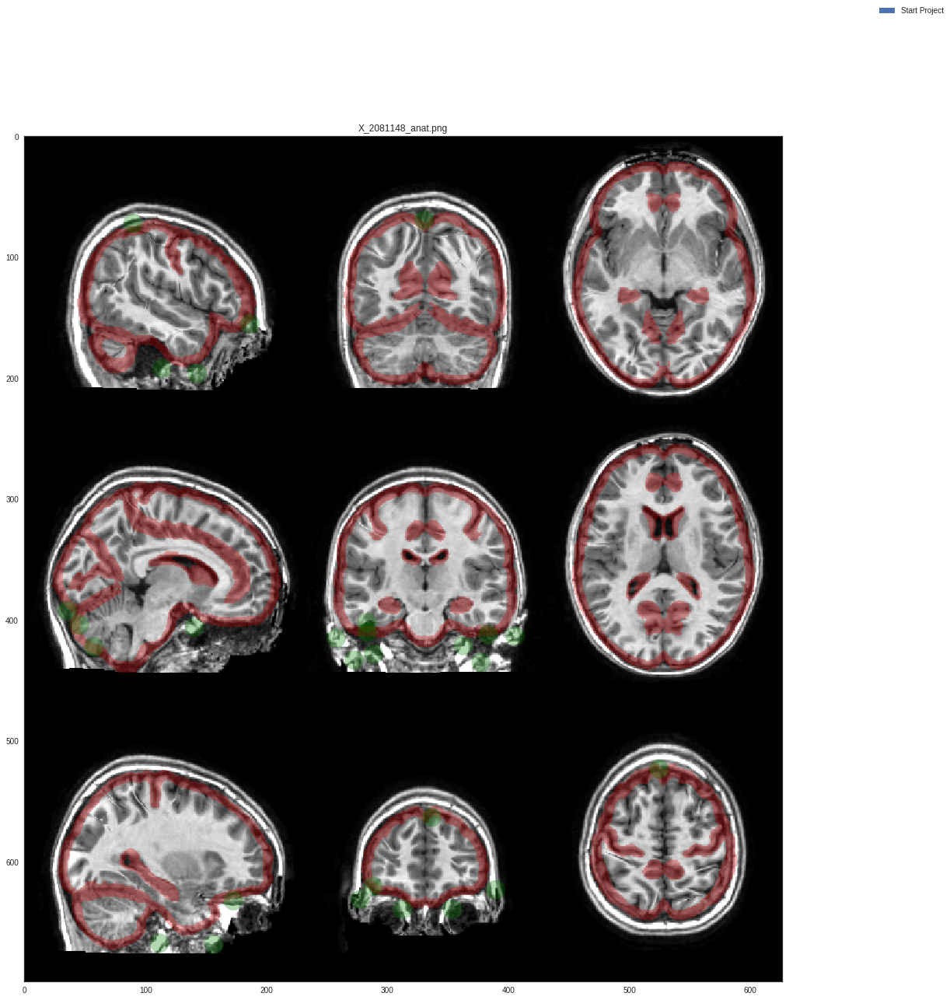

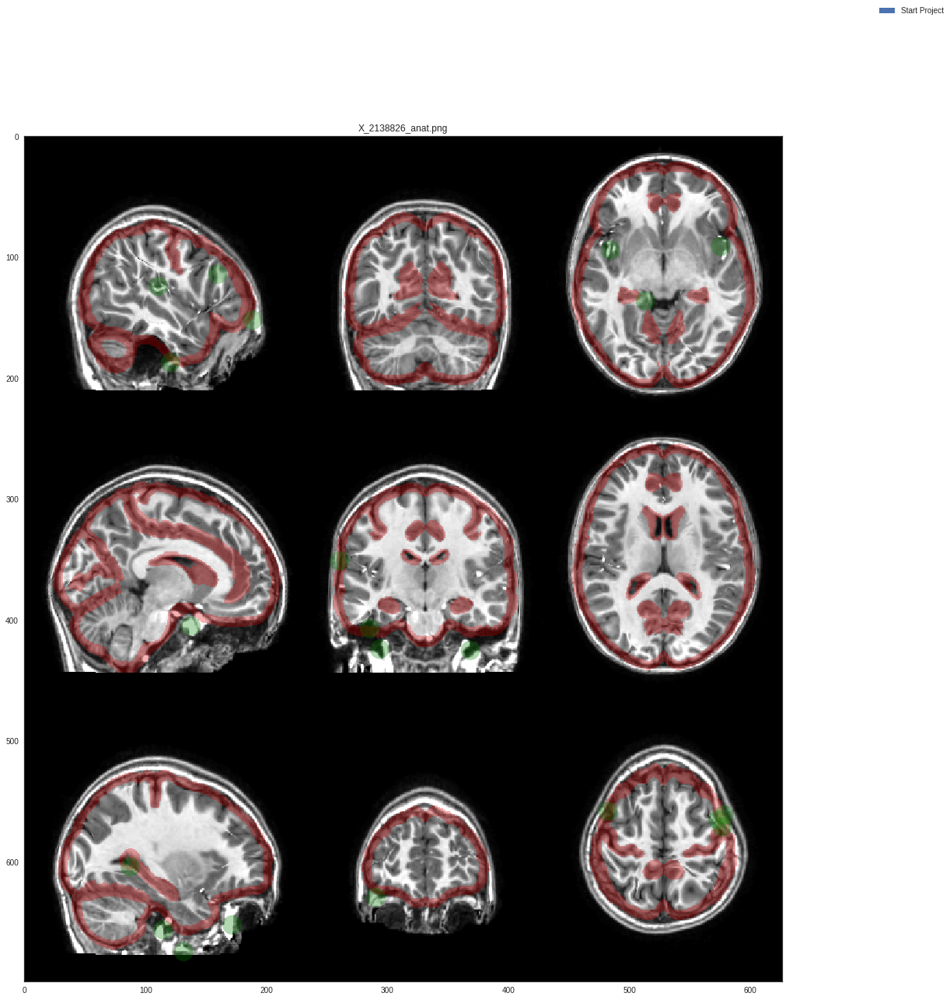

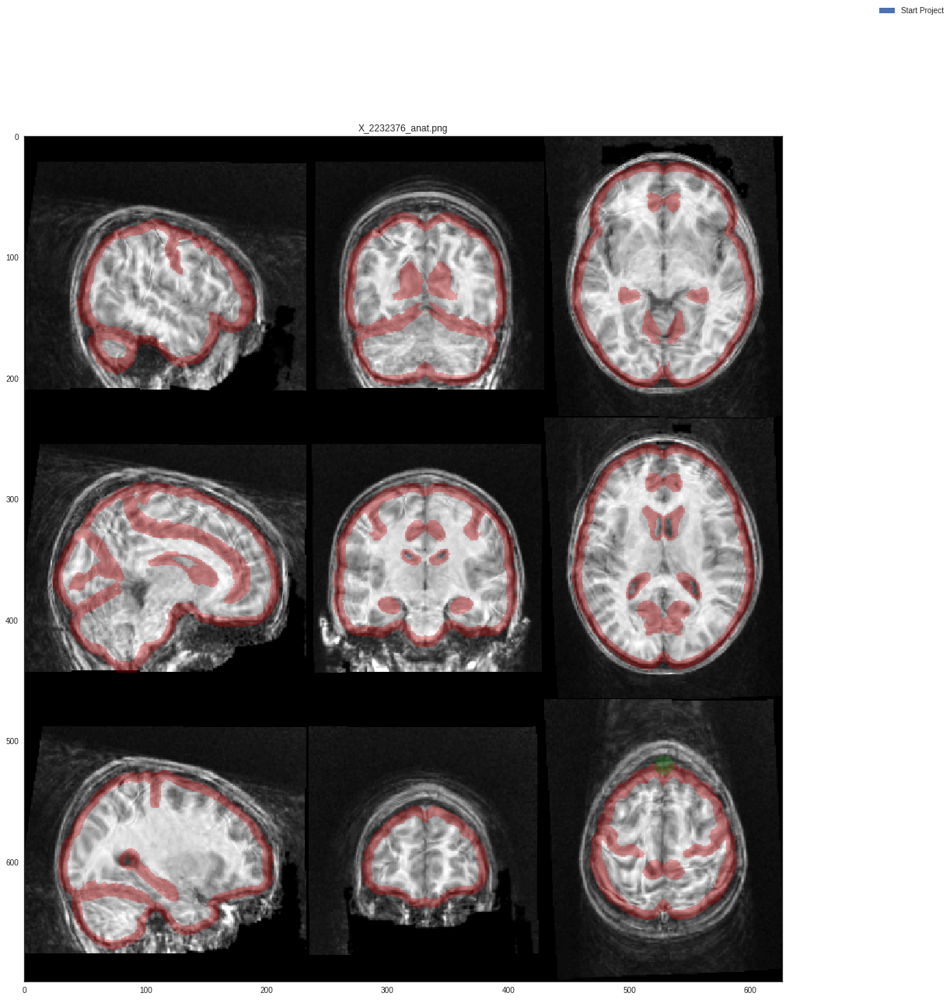

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


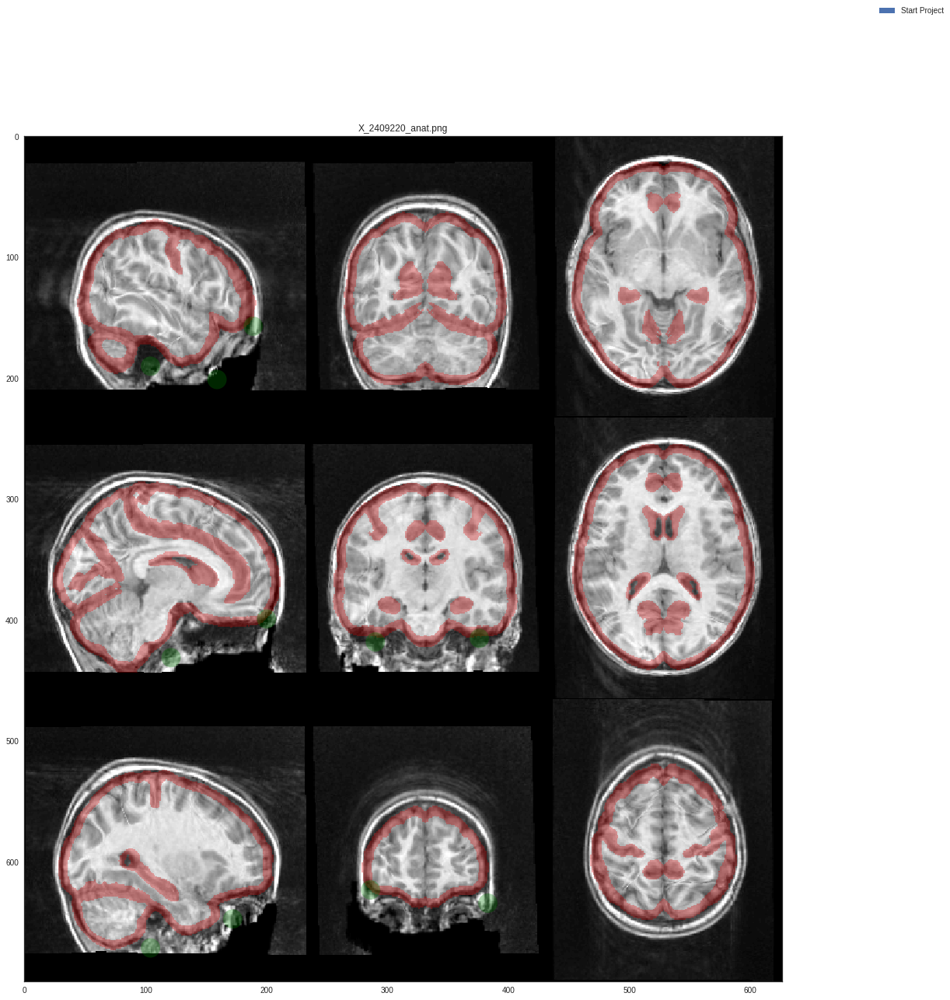

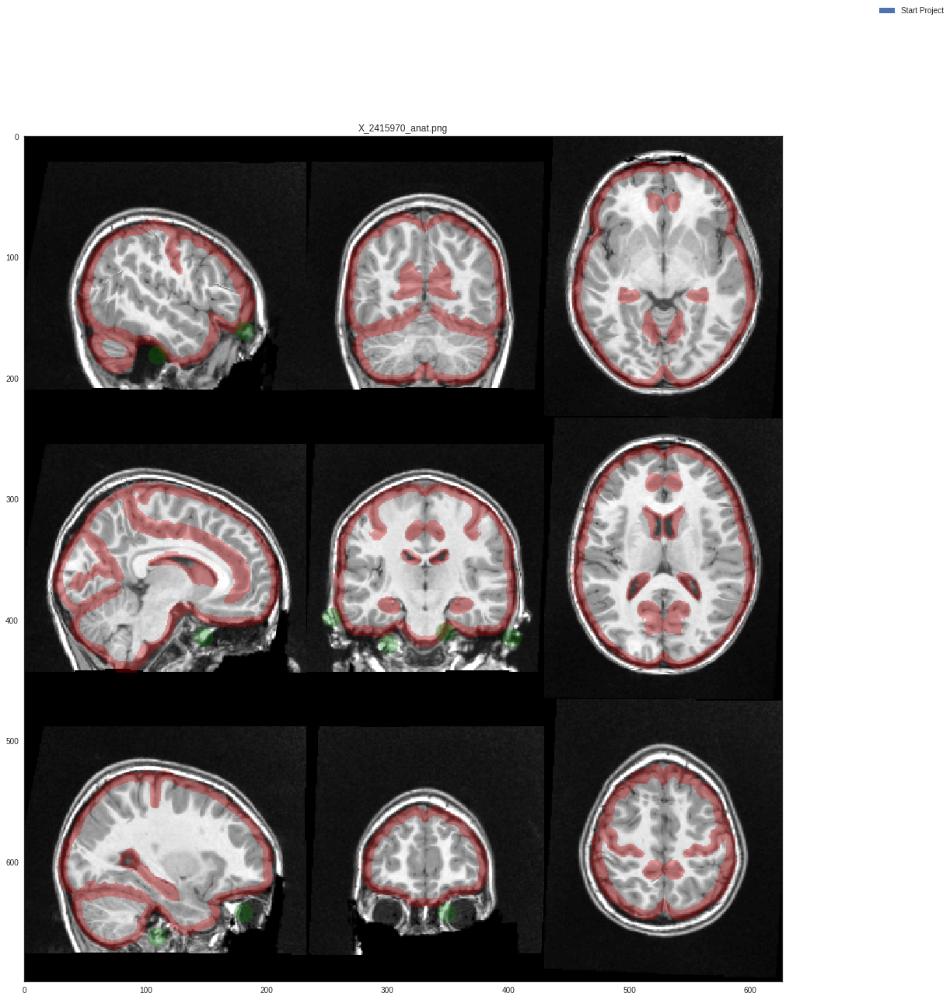

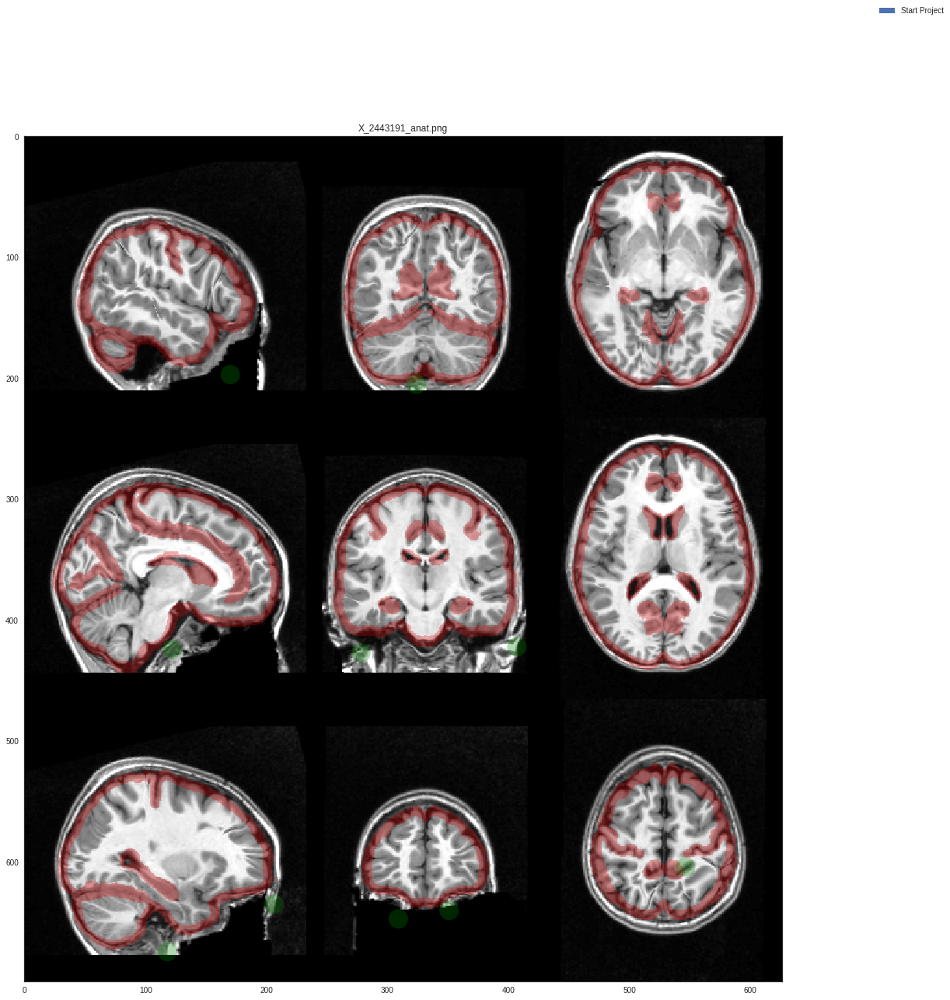

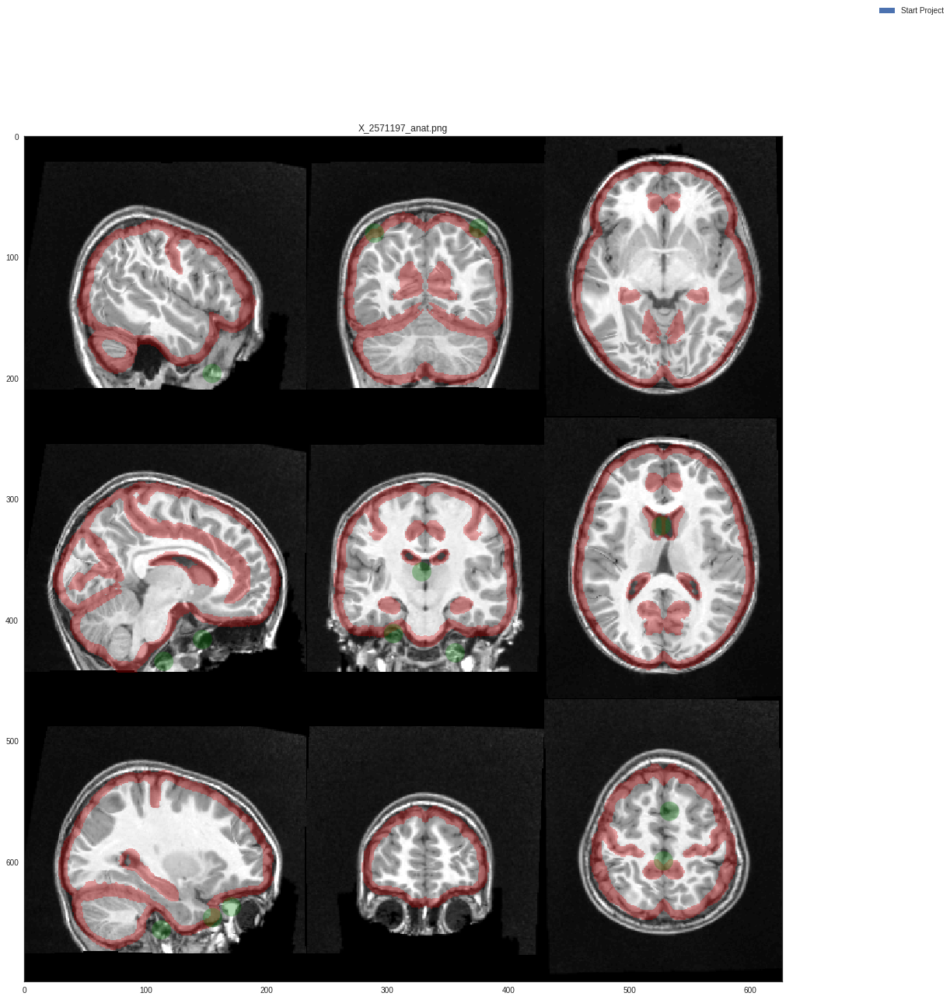

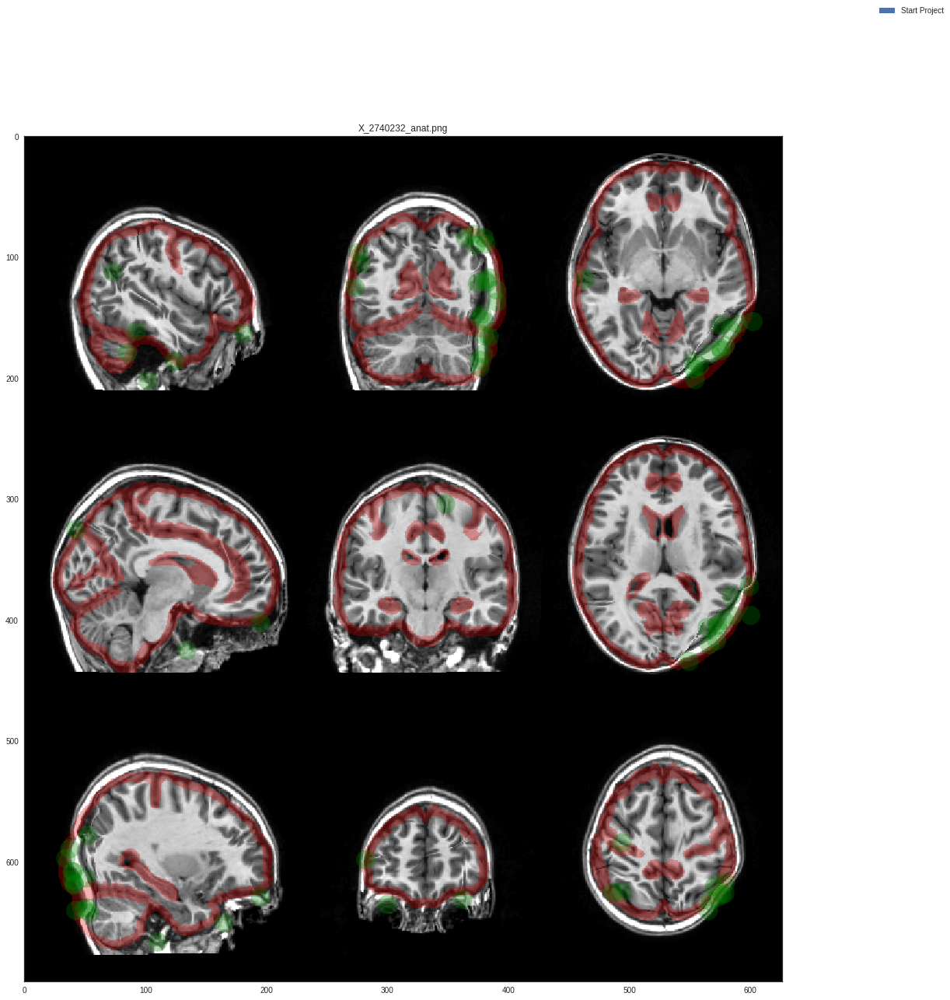

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


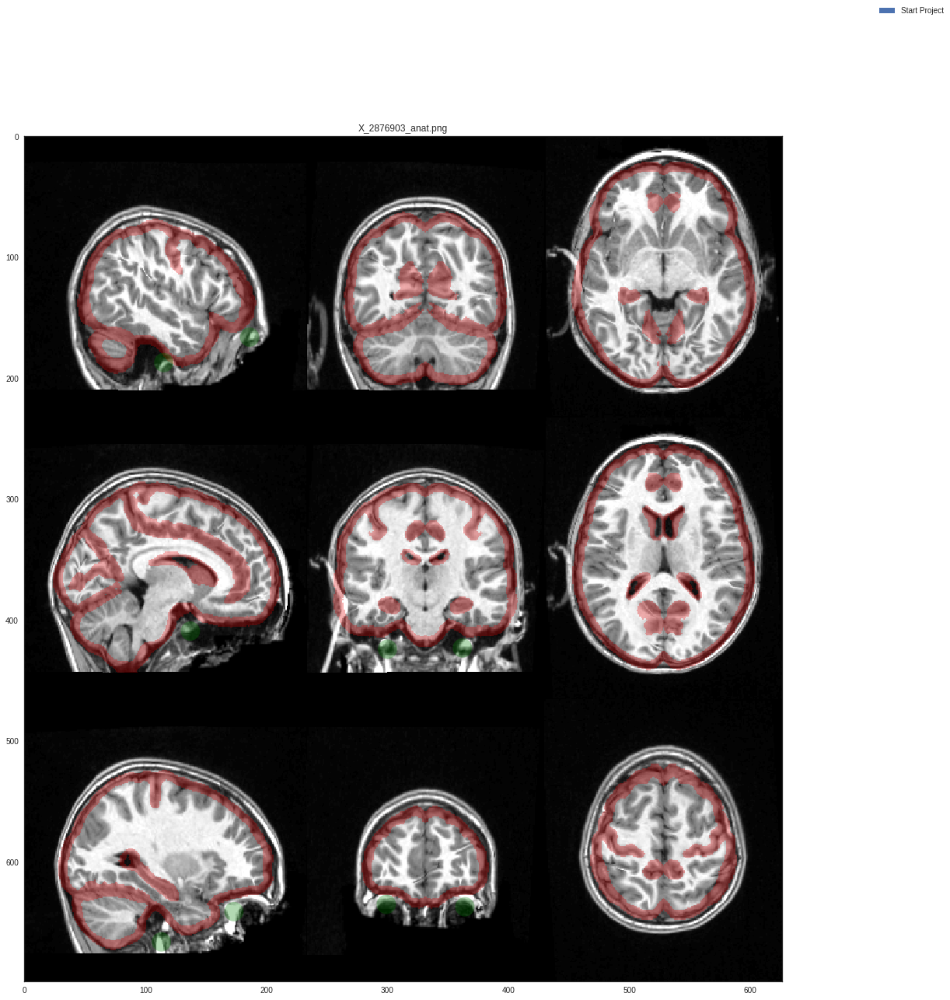

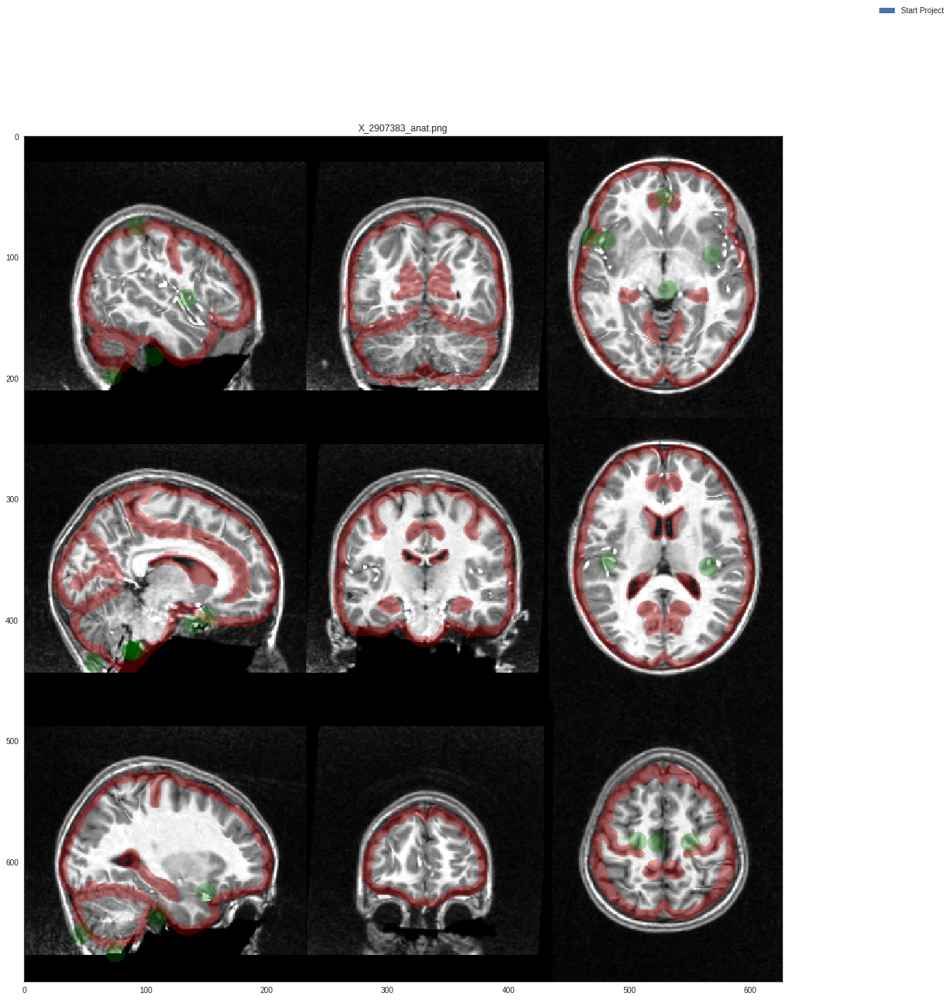

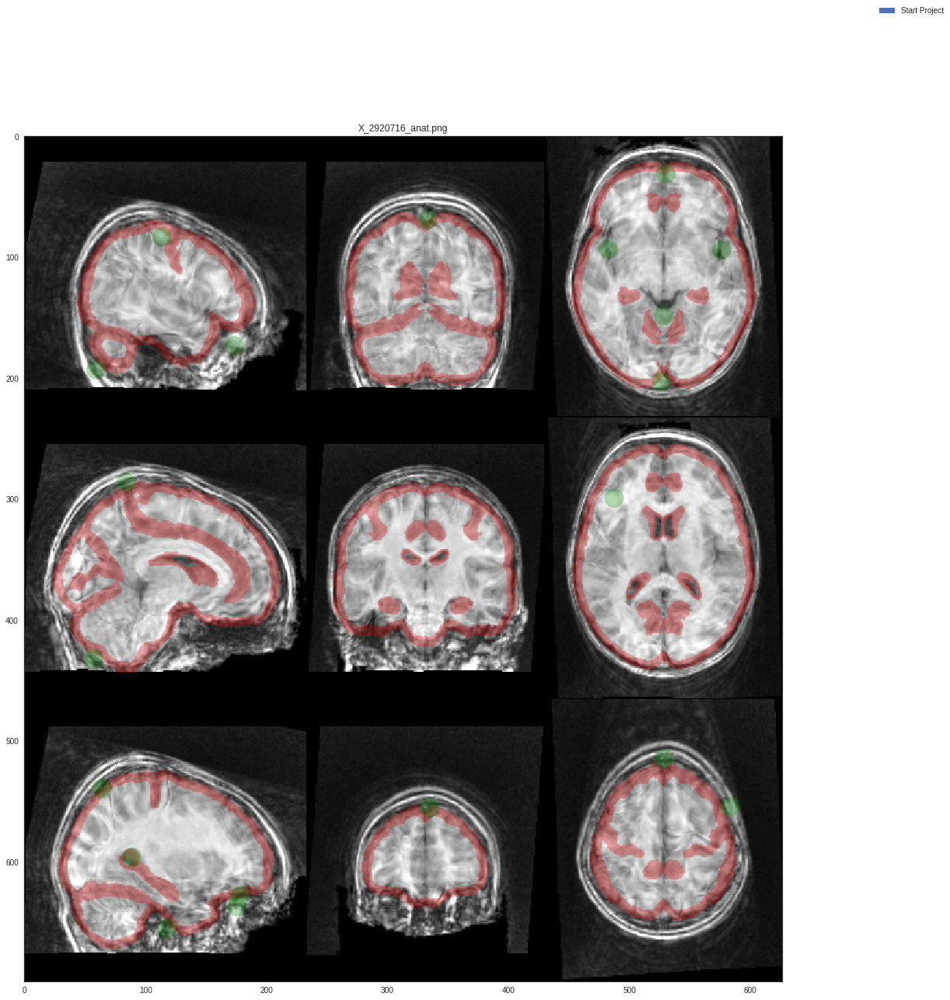

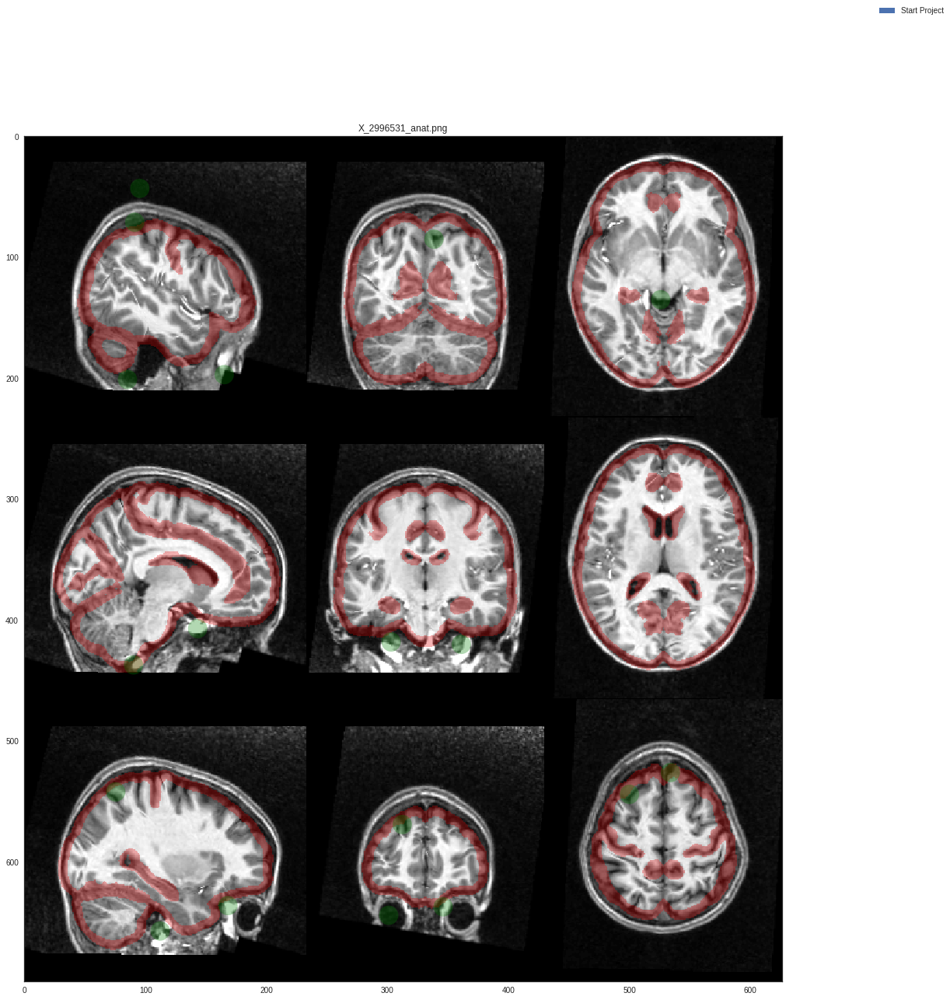

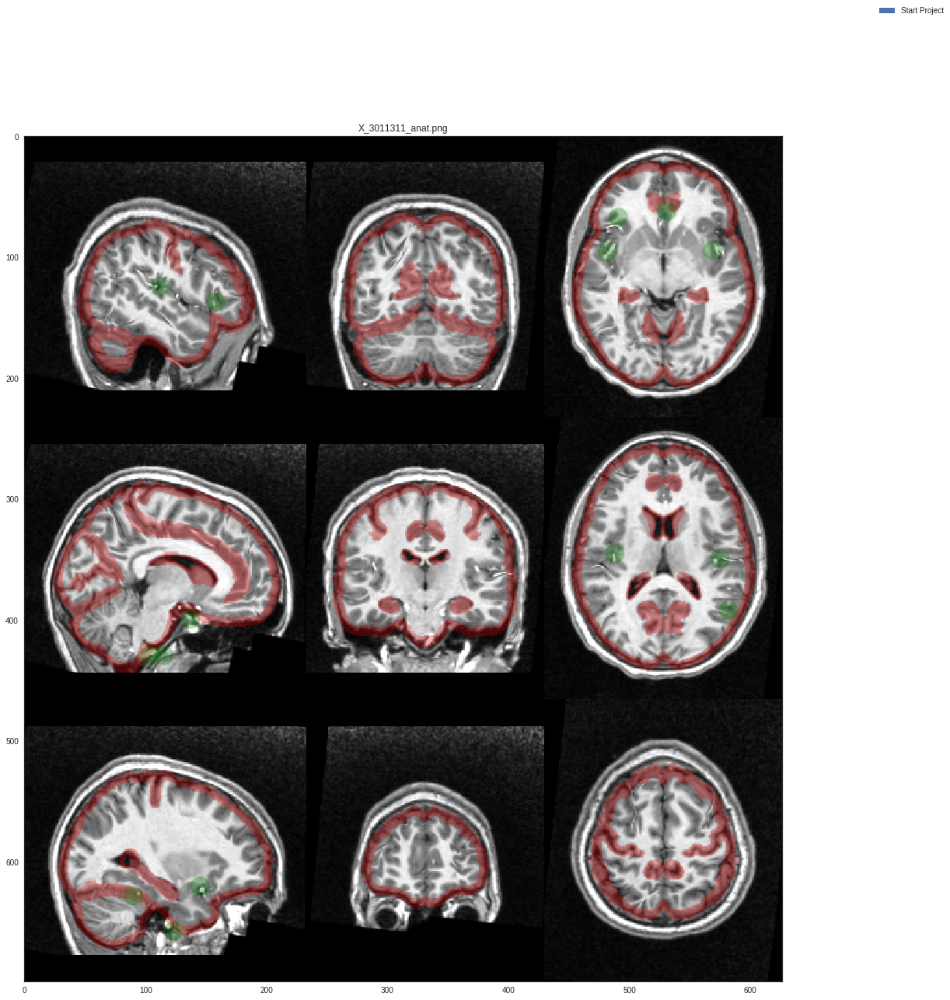

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


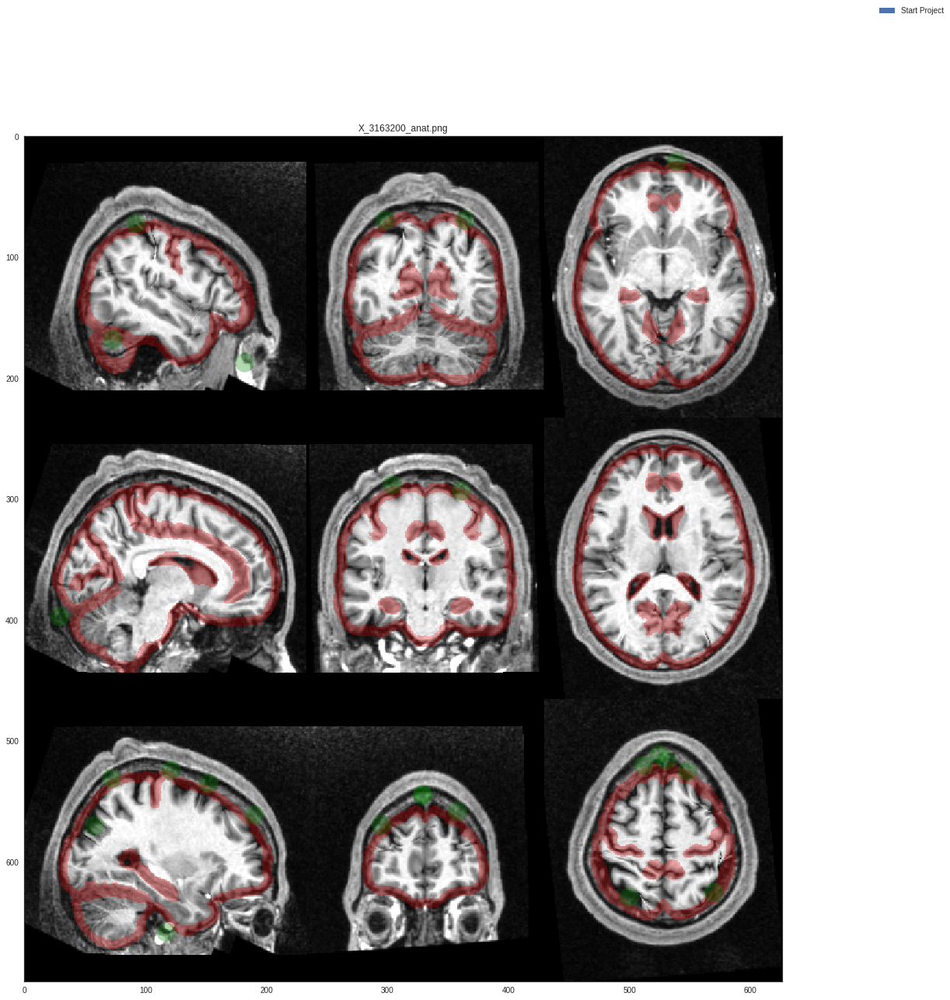

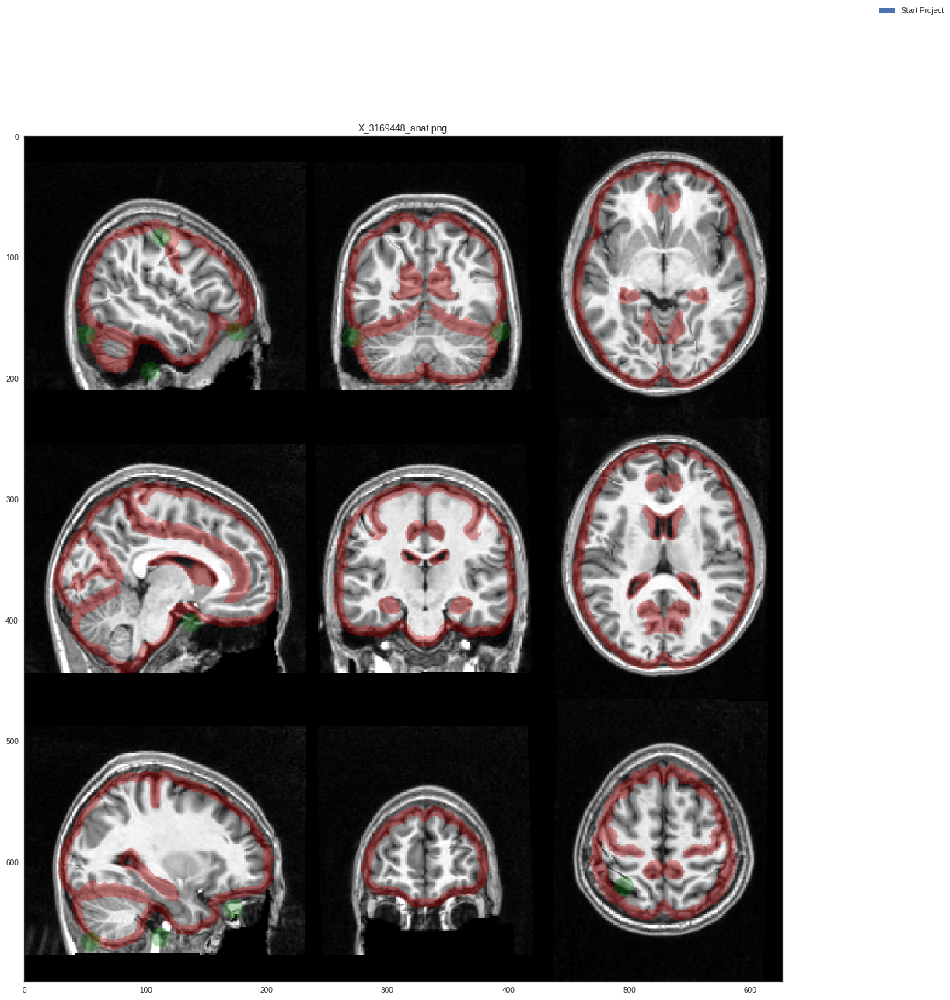

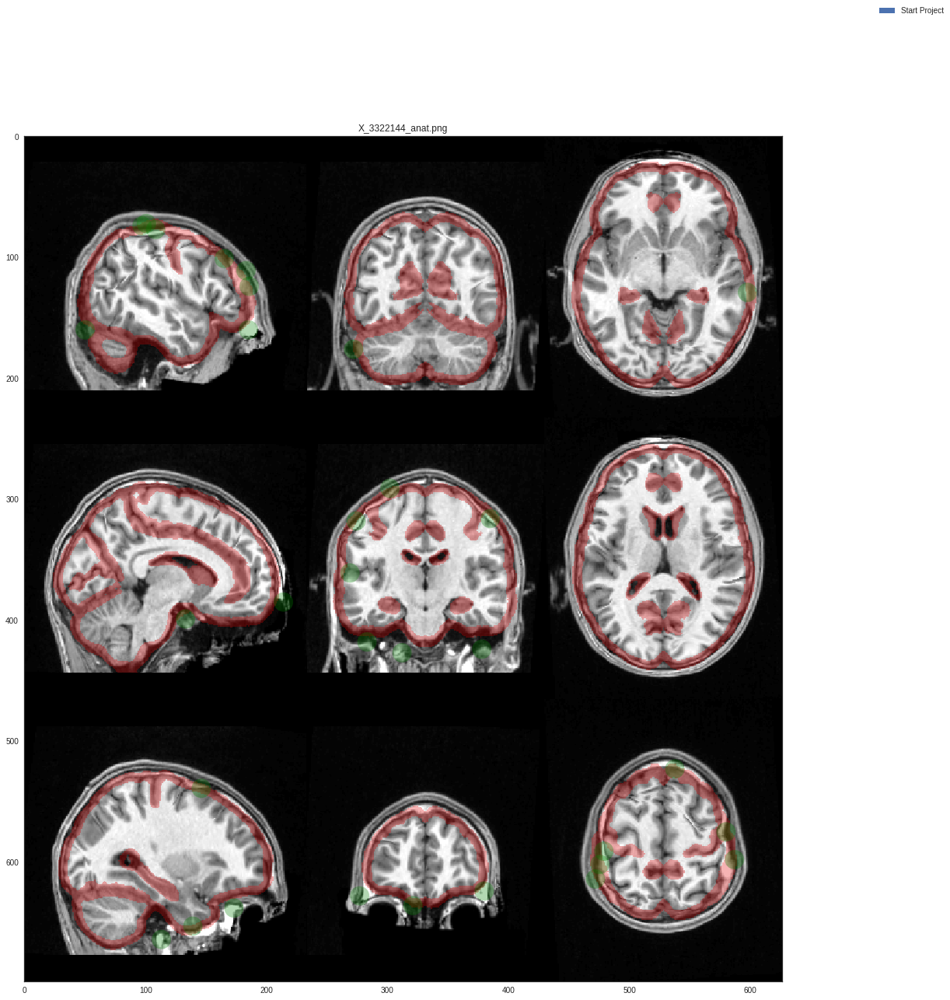

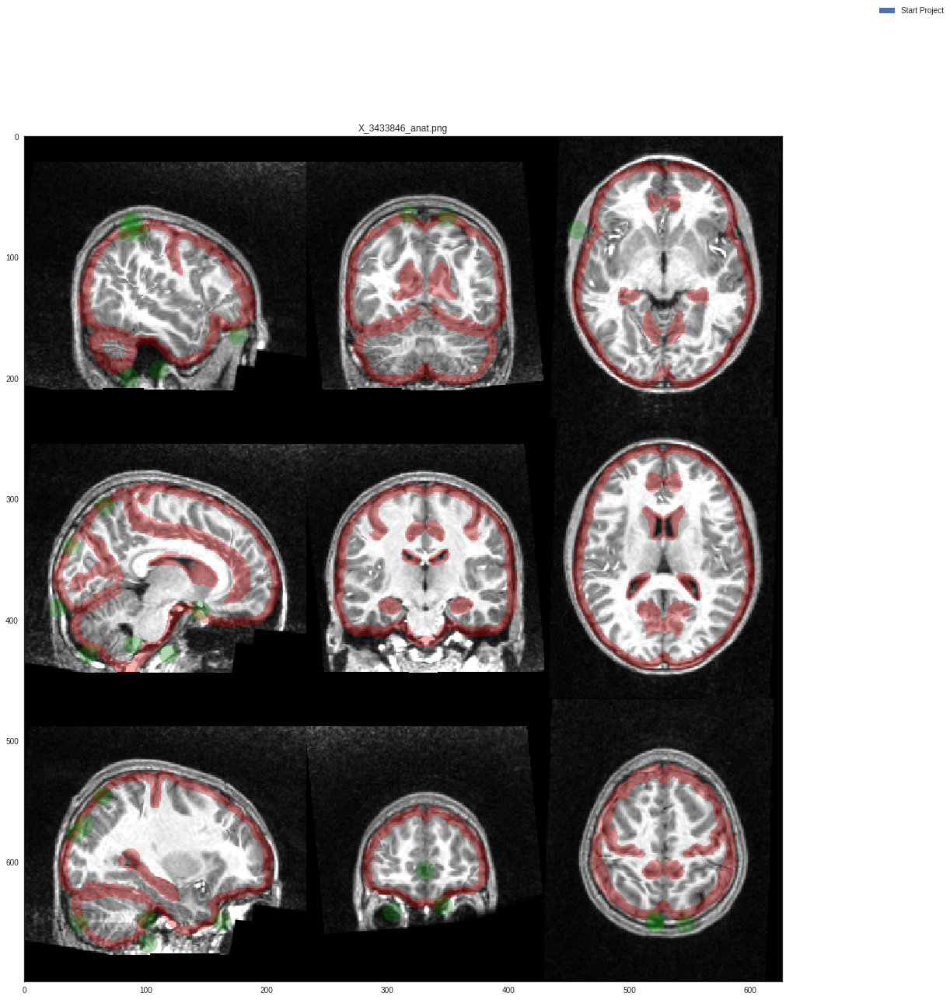

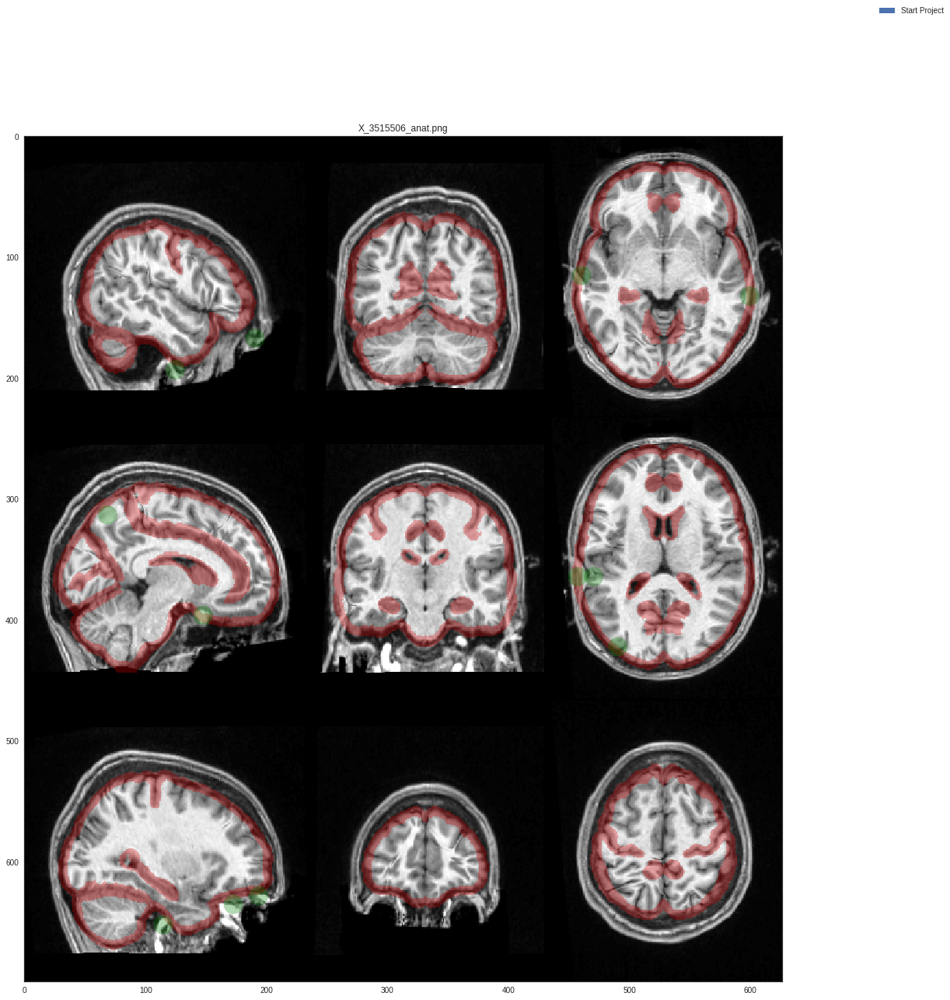

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


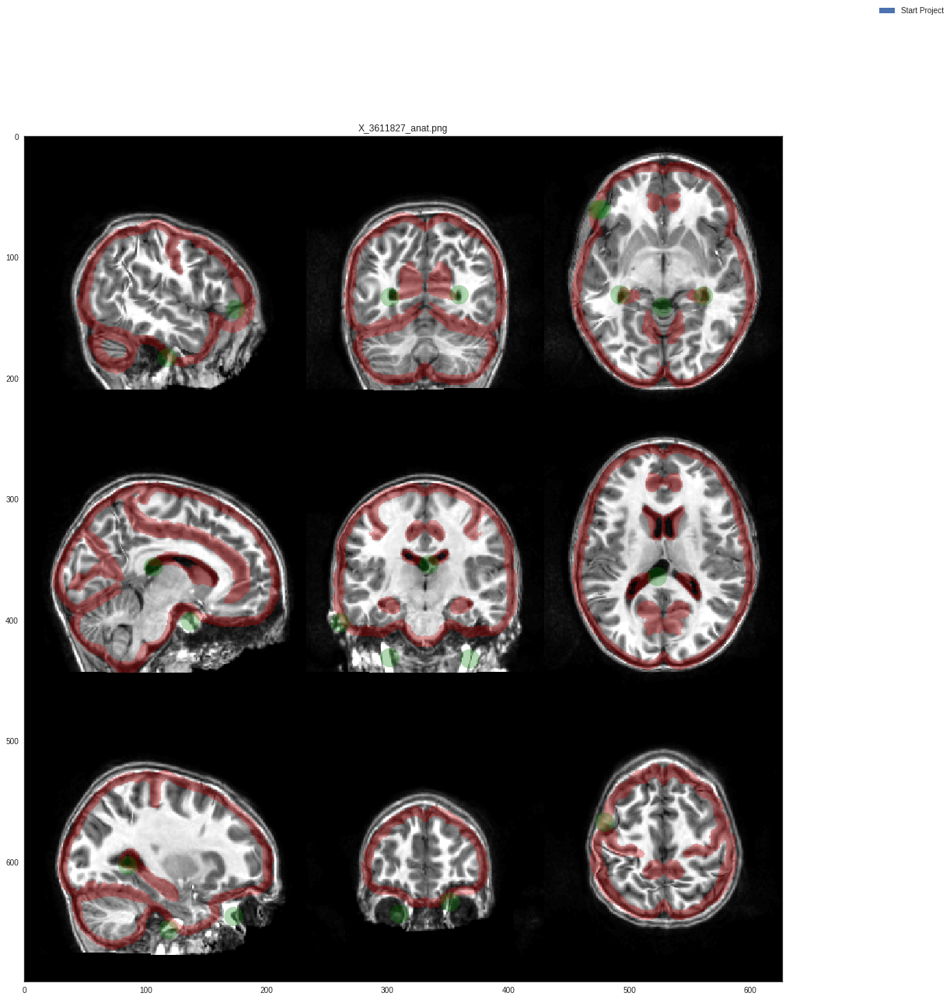

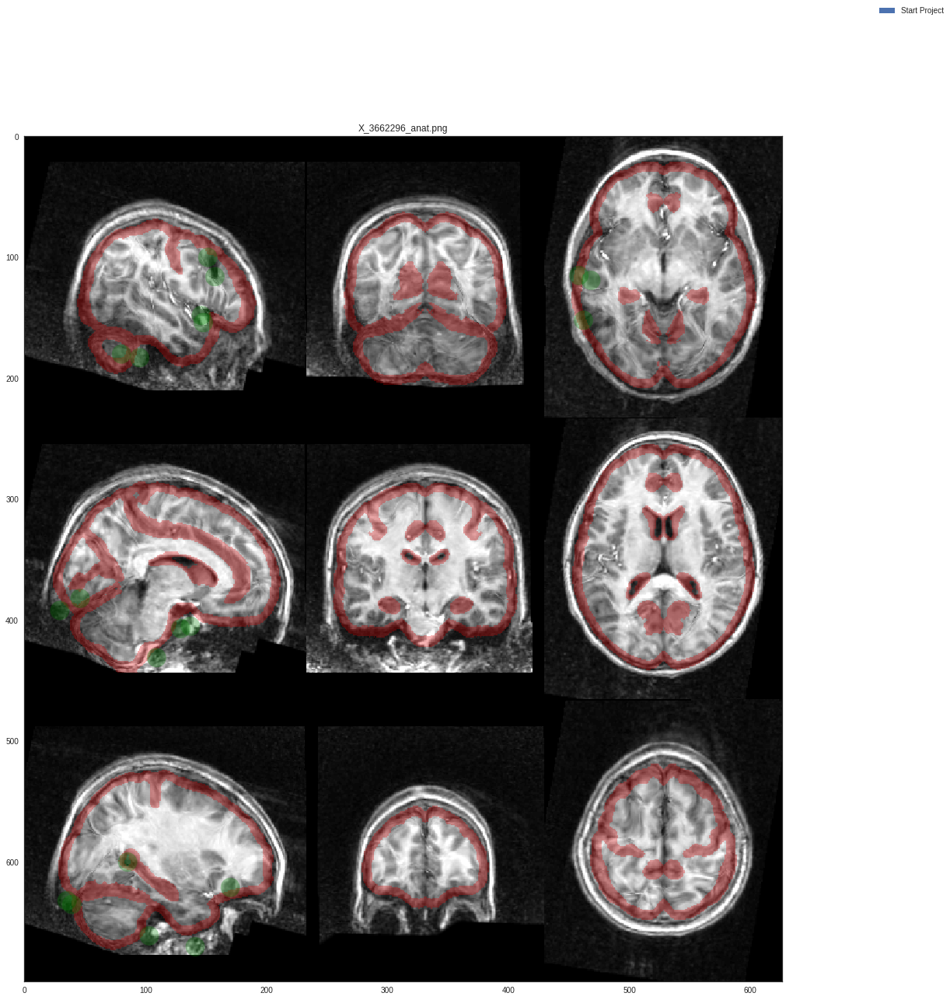

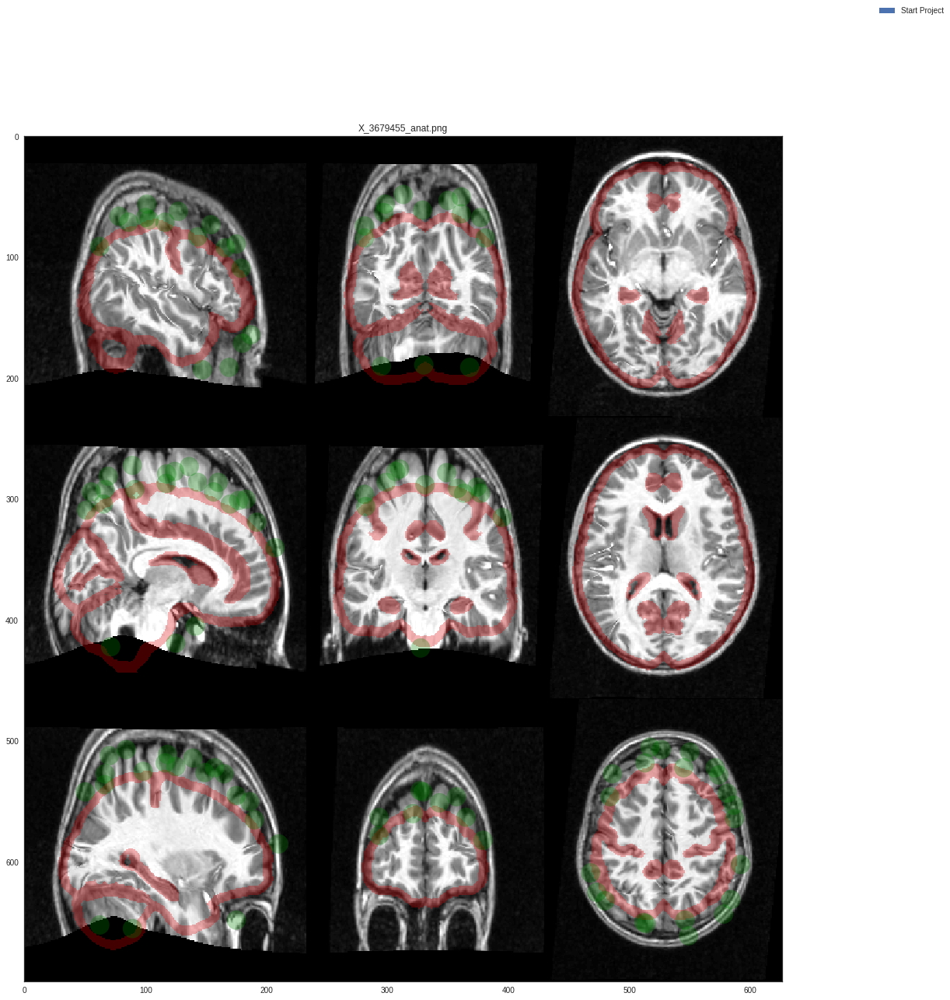

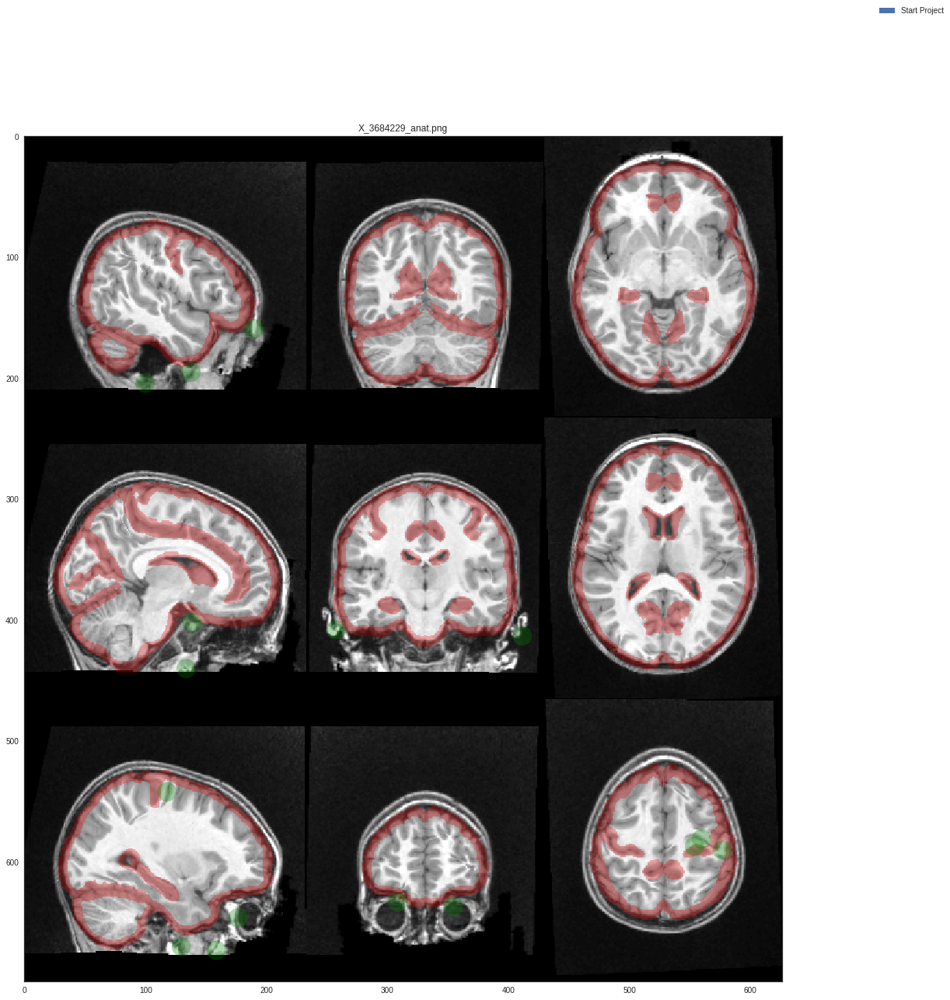

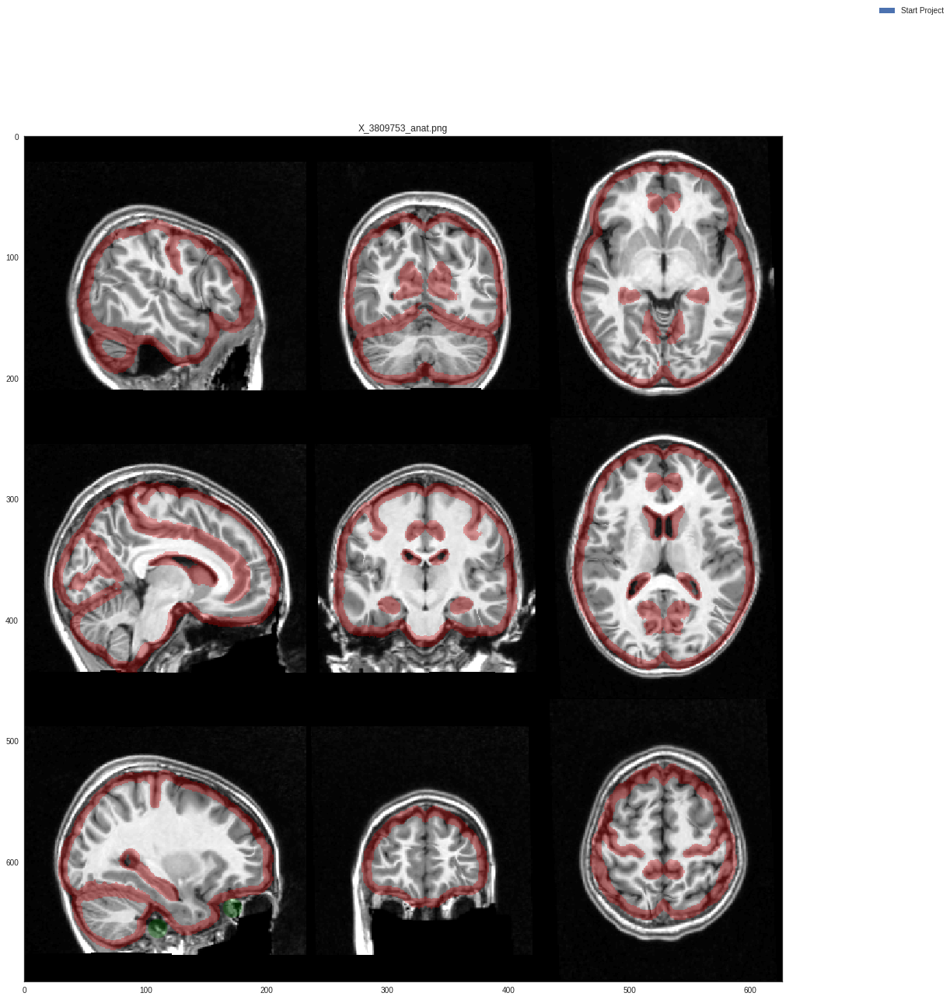

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


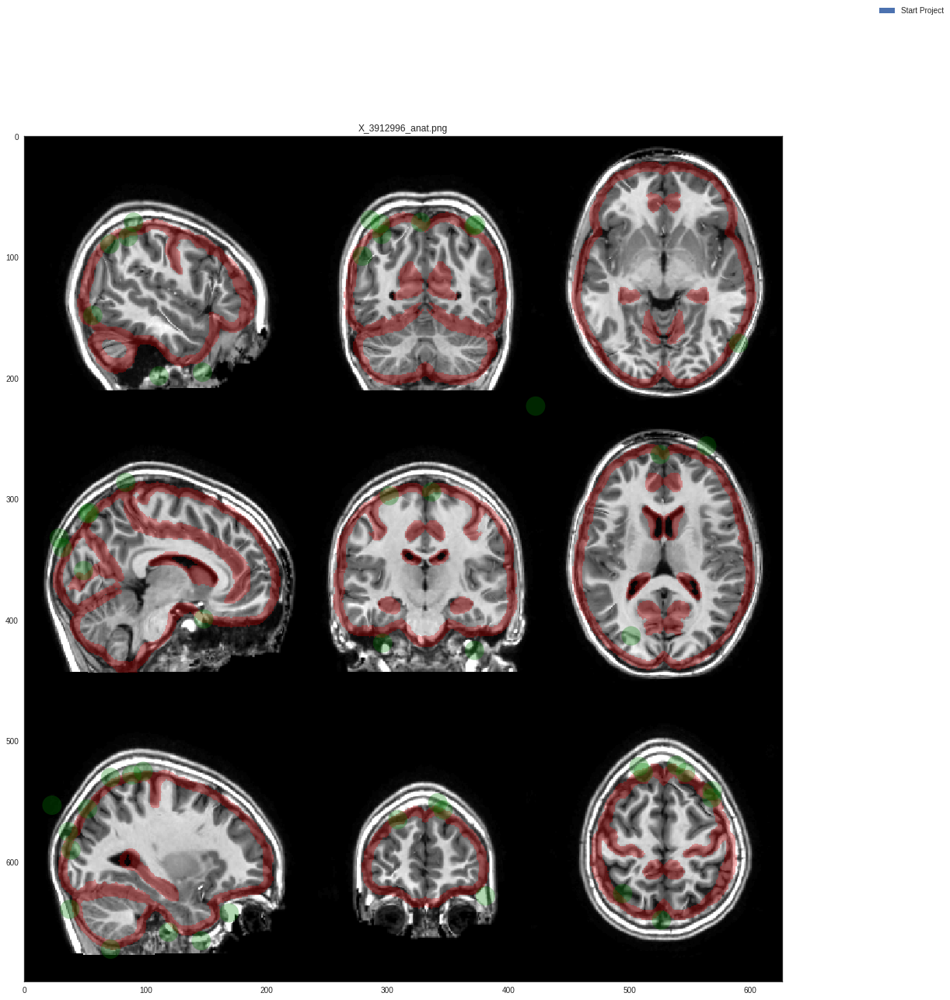

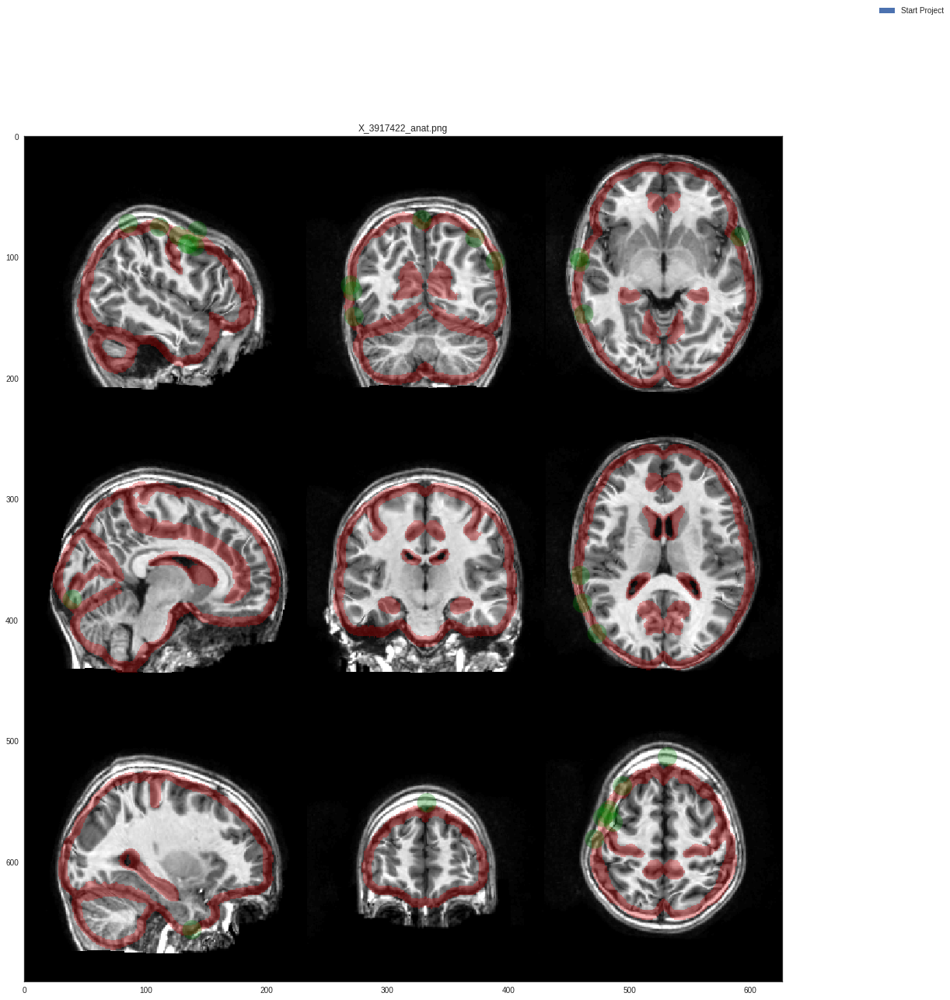

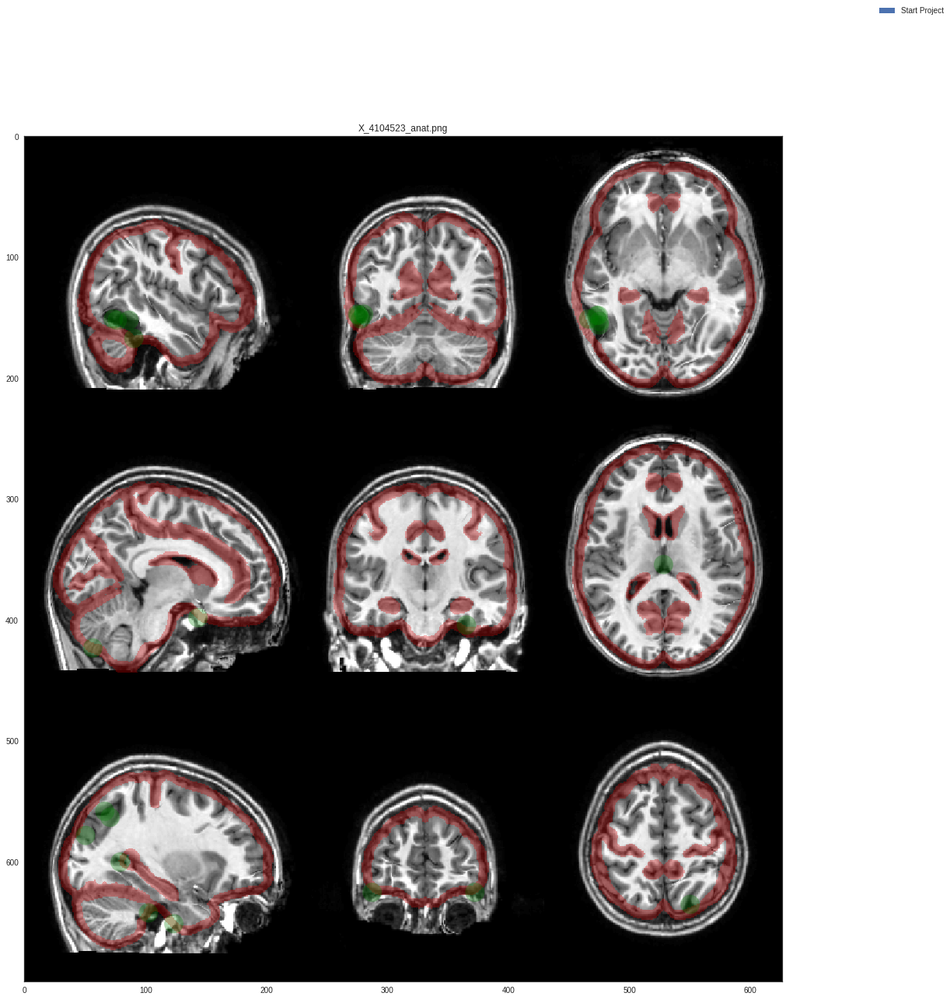

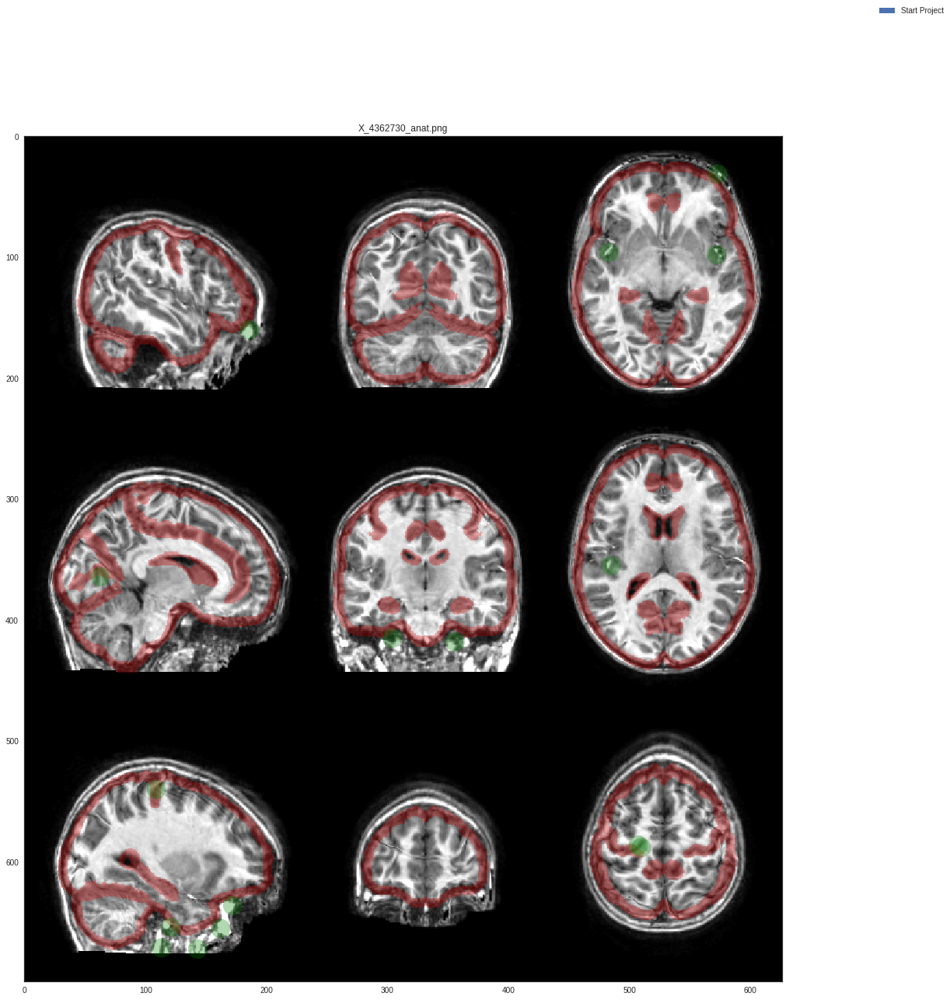

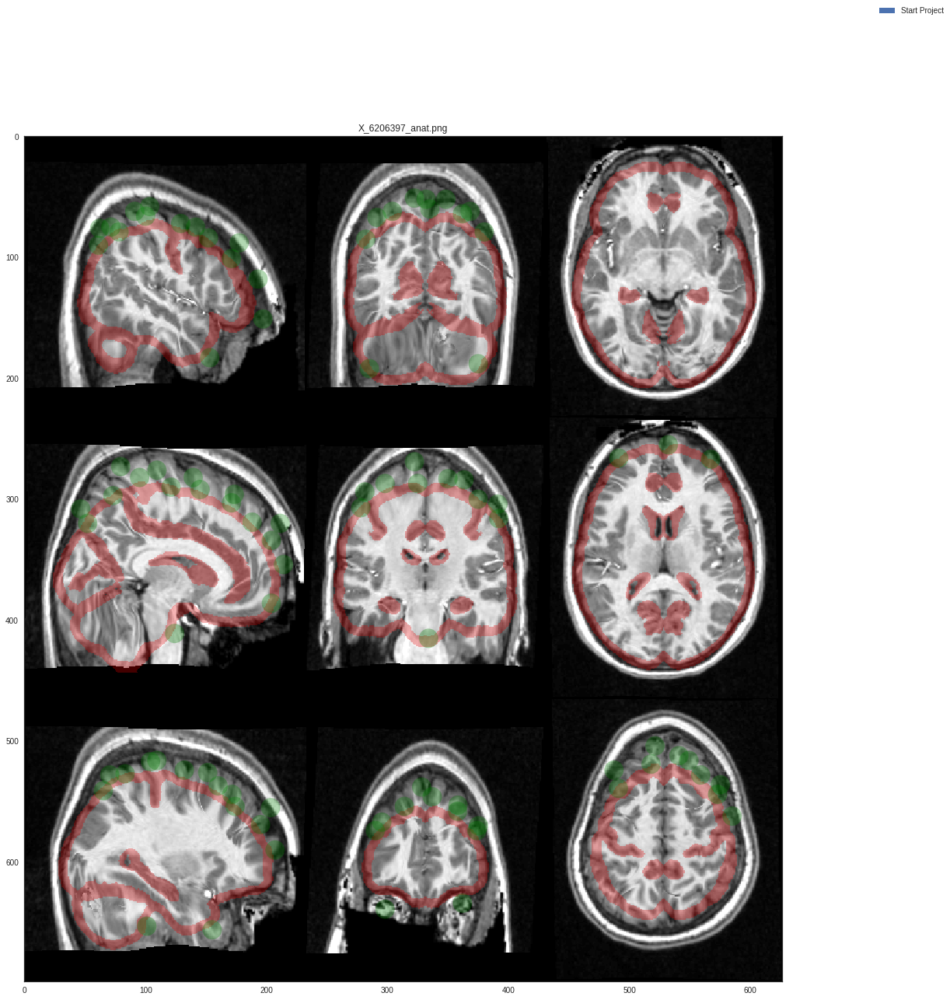

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


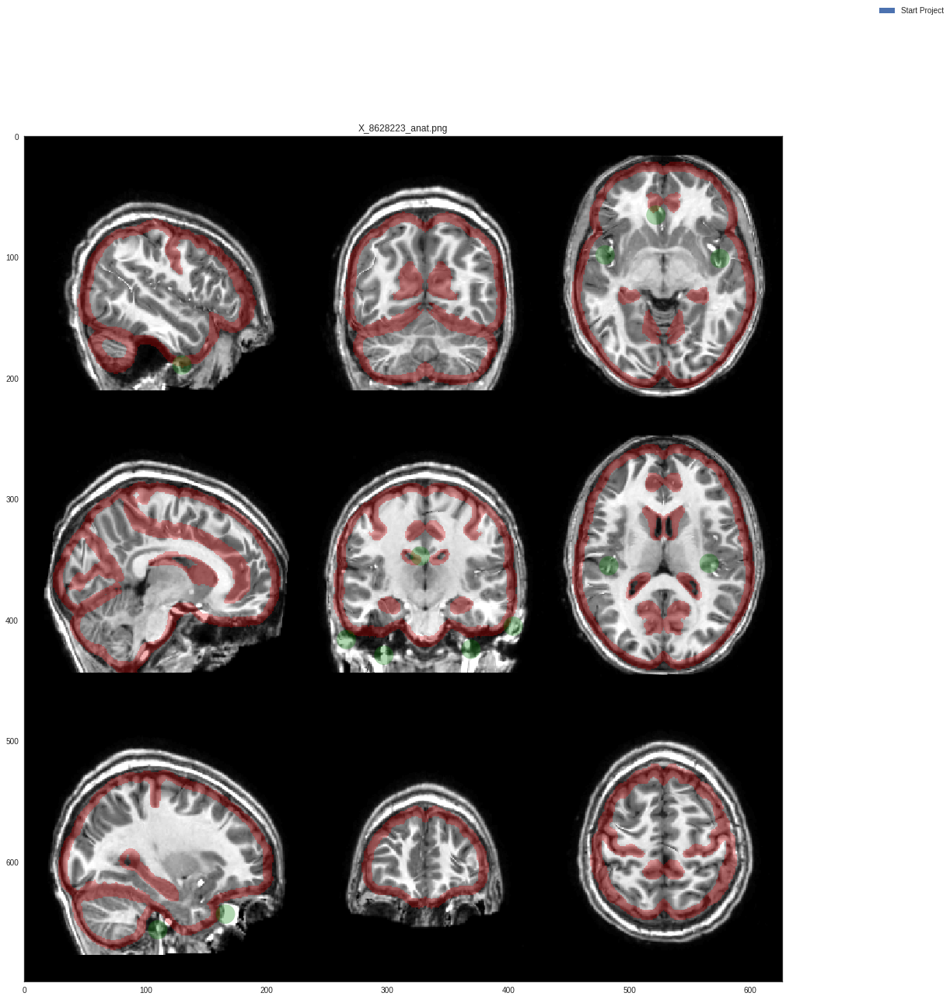

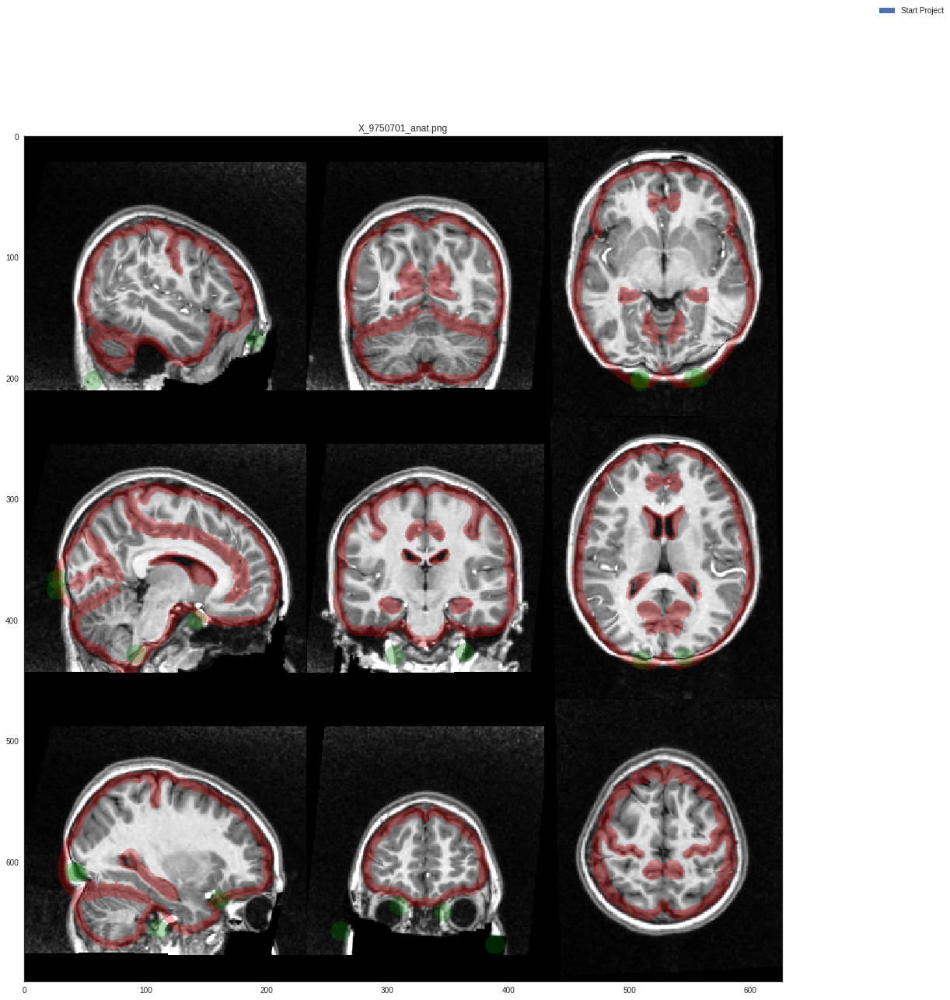

In [103]:
for ind, row in df_ids_imgnm.iterrows():
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111)
    im = plt.imread(os.path.join(base_path_dest, row.imgnm))
    ax.imshow(im)
    out_tmp = out[out['ID'] == row.ID]
    patches = [plt.Circle((row.x,row.y), 8) for ind,row in out_tmp.iterrows()]
    coll = matplotlib.collections.PatchCollection(patches, facecolors='green',alpha=0.3,linewidth=2)
    ax.add_collection(coll)
    ax.set_title(row.imgnm)
    fig.legend(handles=patches, labels= out_tmp.workflow_name.unique().tolist())

In [104]:
out_tmp.workflow_name.unique().tolist()

['Start Project']

In [105]:
a=out_tmp.sort_index().groupby('workflow_name')

In [106]:
[a.rating.unique().get_values().tolist(),a.workflow_name.unique().get_values().tolist()]

[[array(['Fail', 'Maybe'], dtype=object)],
 [array(['Start Project'], dtype=object)]]

In [374]:

np.reshape([a.rating.unique().get_values(),a.workflow_name.unique().get_values()],(2,np.shape(a.rating.unique())[0]))

(array([array(['OK'], dtype=object), array(['Maybe'], dtype=object),
        array(['OK'], dtype=object), array(['Maybe'], dtype=object),
        array(['Maybe'], dtype=object)], dtype=object),
 array([array(['Angela'], dtype=object), array(['Basile'], dtype=object),
        array(['Benjamin'], dtype=object), array(['Maxime'], dtype=object),
        array(['Sara'], dtype=object)], dtype=object))

In [383]:
label_all = np.reshape([a.rating.unique().get_values(),a.workflow_name.unique().get_values()],(2,np.shape(a.rating.unique())[0]))

In [ ]:
x = np.reshape(np.random.randint(30,500,100), (2,50))

for ind, row in df_ids_imgnm.iterrows():
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111)
    im = plt.imread(os.path.join(base_path, a.imgnm))
    ax.imshow(im)

patches = [plt.Circle((x[0, ind],x[1, ind]), 5) for ind in range(x.shape[1])]

coll = matplotlib.collections.PatchCollection(patches, facecolors='green',alpha=0.3,linewidth=2)
ax.add_collection(coll)

/usr/lib/python3/dist-packages/matplotlib/collections.py:549: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == 'face':


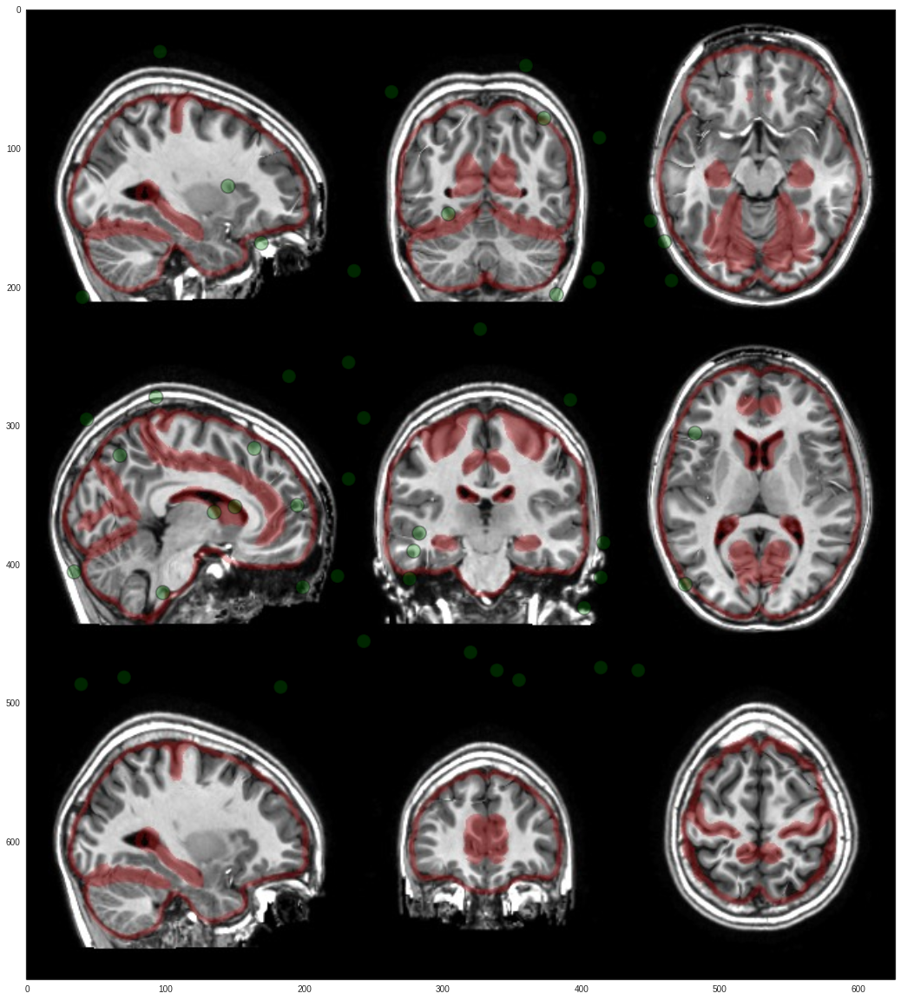

In [143]:
#seb xp 
x = np.reshape(np.random.randint(30,500,100), (2,50))

fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111)
im = plt.imread(os.path.join(base_path, a.imgnm))
ax.imshow(im)

patches = [plt.Circle((x[0, ind],x[1, ind]), 5) for ind in range(x.shape[1])]

coll = matplotlib.collections.PatchCollection(patches, facecolors='green',alpha=0.3,linewidth=2)
ax.add_collection(coll)

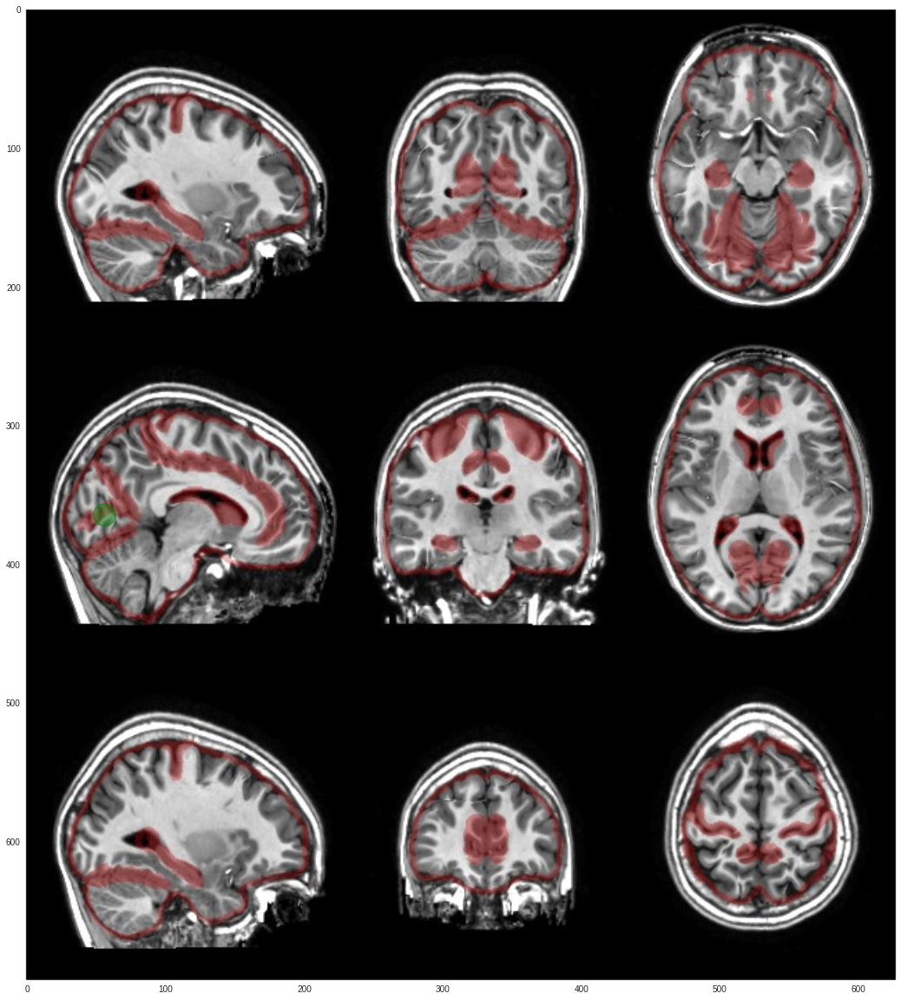

In [34]:
# Make Images
base_path = '/media/yassinebha/database29/Drive/QC_zooniverse/zooqc_adhd200_01-Mar-2017/registration'
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111)
im = plt.imread(os.path.join(base_path, a.imgnm))
ax.imshow(im)
ax.add_artist(plt.Circle( (a.x, a.y), 8, color='green', fill=True, linewidth=2, alpha=0.4))

In [36]:
mat = np.zeros(im.shape[:2])
mat[20:60, 20:60] = 1

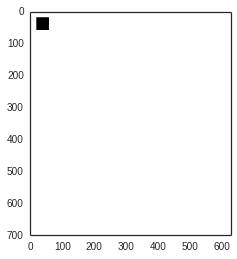

In [37]:
# Make Images
base_path = '/media/yassinebha/database29/Drive/QC_zooniverse/zooqc_adhd200_01-Mar-2017/registration'
fig, ax = plt.subplots()
im = plt.imread(os.path.join(base_path, a.imgnm))
ax.imshow(im)
ax.imshow(mat)

In [ ]:
# Make Images

# Select Subject Index Number
subsel=12

marks = out[out.subject_ids == usub.subject_ids[subsel]]
imgnm = list(json.loads(usub.subject_data[subsel]).values())[0]['IMG_COLOR']

imgpath='../ap_sampledata/'
imgfile=imgpath+imgnm

fig, ax = plt.subplots()
im = plt.imread(a.imgnm)
ax.imshow(im)
for index, m in marks.iterrows():
    if m.tool == 0:
        ax.add_artist(plt.Circle( (m.x, m.y), m.r, color='b', fill=False))
    if m.tool == 1:
        ax.add_artist(plt.Circle( (m.x, m.y), m.r, color='r', fill=False))
    if m.tool > 1:
        ax.add_artist(plt.Circle( (m.x, m.y), m.r, color='g', fill=False))

plt.axis('off')
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.savefig('out_'+imgnm, dpi=120, bbox_inches='tight', pad_inches=0)